### AI Lab -  Assignment 1 - CH22M503

#### Author - Aloy Banerjee
###### Roll No. CH22M503

#### Reference used 

In [1]:
#https://www.endpointdev.com/blog/2022/04/visualizing-data-with-pairplot-using-matplotlib/
#https://pandas.pydata.org/docs/reference/api/pandas.io.formats.style.Styler.background_gradient.html
#https://stackoverflow.com/questions/71816076/how-to-calculate-the-percentage-of-overlap-between-2-ranges-with-python
#https://shankhanilborthakur.medium.com/plotting-data-visualisation-on-the-map-of-india-using-geopandas-in-python-211bc88c1e4d
#http://projects.datameet.org/maps/districts/ ----> shp and shx file is reffered from this website

#### Common variable declaration

In [2]:
#Question 1 
CancergeometryPath = 'E:\\Document\\M-Tech\\M-Tech Class\\2nd Trimester\\Assignment\\AI Lab\\Assignment 1\\'
CancergeometryFileName = 'Cancergeometry.csv'

#Question 2
OutbreakPath = 'E:\\Document\\M-Tech\\M-Tech Class\\2nd Trimester\\Assignment\\AI Lab\\Assignment 1\\'
OutbreakFileName = 'Outbreak_India.csv'

districtSHPPath = 'E:\\Document\\M-Tech\\M-Tech Class\\2nd Trimester\\Assignment\\AI Lab\\Assignment 1\\IndiaMap\\MEGHALAYA\\maps-master\\Districts\\Census_2011\\2011_Dist.shp'
indiaSHPPath ='E:\\Document\\M-Tech\\M-Tech Class\\2nd Trimester\\Assignment\\AI Lab\\Assignment 1\\IndiaMap\\india-polygon.shp'

#Load word cloud for only assigned district or not
onlyAssignedDist = True
filtering_state = 'Meghalaya'
assignedOutbreak = 'Fever'

### Question 1

#### Q1 A team of scientists has collected data for studying tumor types (benign vs malignant) for cancer.The team has analyzed tumors for different geometrical aspects such as mean radius of tumor,mean texture of tumor, area of the tumor, etc. for both types of tumors benign (denoted as B) and malignant (denoted as M). Now, the team would like to know what significant geometrical aspects of the tumor which allow them to distinguish benign and malignant tumors in the future. Use different descriptive statistics and plots for answering the question. Also, use the plots to visualize if the variables are highly correlated and report the correlation coefficients for those variables. The data set to be used here is Cancergeometry.csv.

#### Common function 

In [3]:
#Common reusable function
def encoder_diag(x):
    if x=='M':
        return 1
    if x=='B':
        return 0

def overlapping_percentage(interval1: list, interval2: list) -> int:
    # min max of each intervals
    min1, max1 = min(interval1), max(interval1)
    min2, max2 = min(interval2), max(interval2)
    # find overlapping boundaries
    lb, ub = 0, 0 # lower and upper bound
    if min1 <= min2 <= max1:
        if max1 >= max2:    # i2 is contained in i1
            lb, ub = min2, max2
        elif max1 < max2:
            lb, ub = min2, max1
    elif min2 <= min1 <= max2:
        if max1 <= max2:    # i1 is contained in i2
            lb, ub = min1, max1
        elif max1 > max2:
            lb, ub = min1, max2    
    percent = int((ub - lb) / (interval2[1] - interval2[0]) * 100)
    return f'{percent}%'

def find_outliers_percentage(df):
    q1=df.quantile(0.25)
    q3=df.quantile(0.75)
    IQR=q3-q1
    outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]
    outlier_percentage = len(outliers)/len(df)
    return outlier_percentage


#### Importing Library

In [4]:
#Import library 
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

#### Change the working directory and load the data

In [5]:
#Change the working directory 
os.chdir(CancergeometryPath)
#Load the data set 
df_Cancergeometry = pd.read_csv(CancergeometryFileName)
#Get the statistical details
#print(df_Cancergeometry)
df_Cancergeometry.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [6]:
df_Cancergeometry.info()
#No null value is present in the dataset 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

#### Data is clean with no missing value.

#### Filter out benign and malignant type of tumor data

==========Distribution of Malignant and Benign types of tumor============


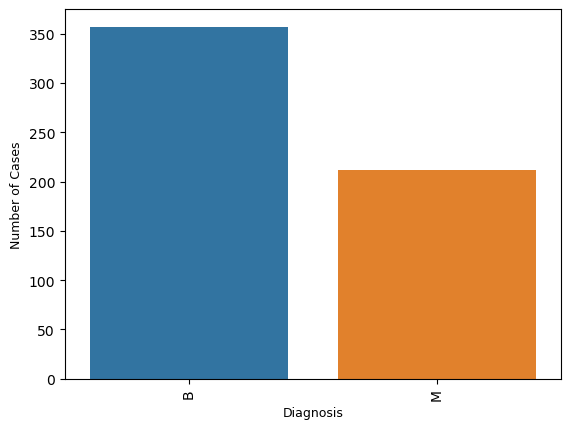

B    357
M    212
Name: diagnosis, dtype: int64

In [7]:
#Filter out benign and malignant tumor
benign_tumor_data = df_Cancergeometry[df_Cancergeometry['diagnosis'] == 'B']
malignant_tumor_data = df_Cancergeometry[df_Cancergeometry['diagnosis'] == 'M']

print('==========Distribution of Malignant and Benign types of tumor============')
tumor_type_count= df_Cancergeometry['diagnosis'].value_counts()  
sns.barplot(x=tumor_type_count.index, y=tumor_type_count.values)
plt.ylabel('Number of Cases', fontsize=9)
plt.xlabel('Diagnosis', fontsize=9)
plt.xticks(rotation=90)
plt.show();
df_Cancergeometry['diagnosis'].value_counts()

##### 212 - Malignant, 357 - Benign. 'benign' and 'malignant' are presented as 1 and 0, respectively in further analysis

#### Outlier Analysis for each feature

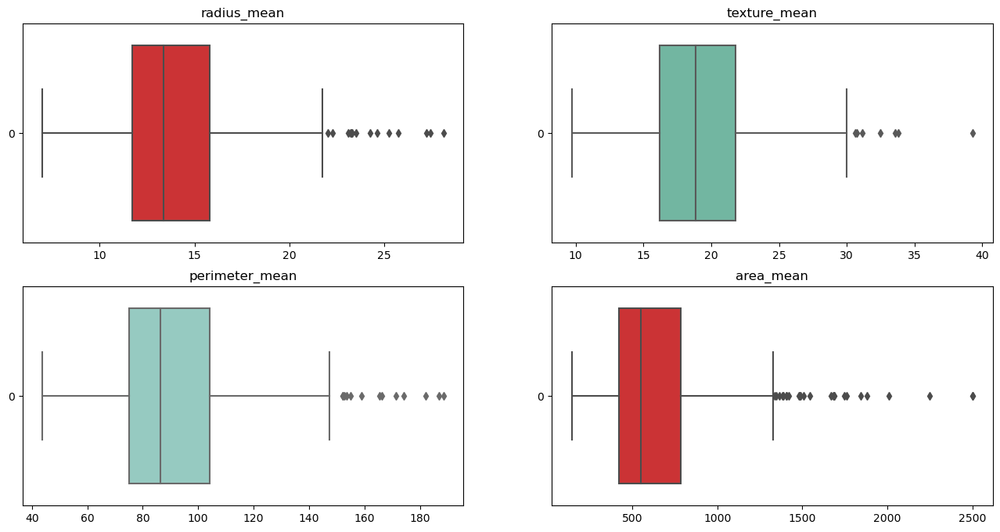

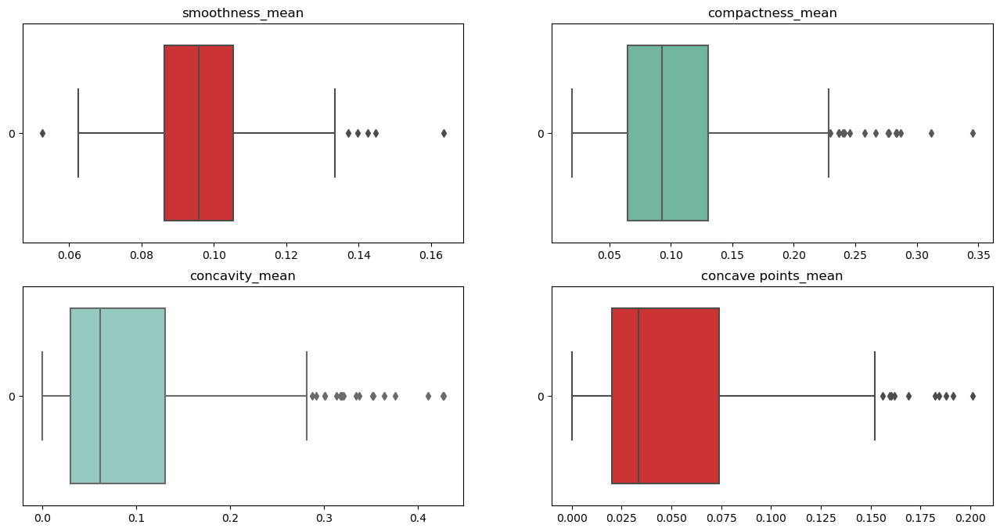

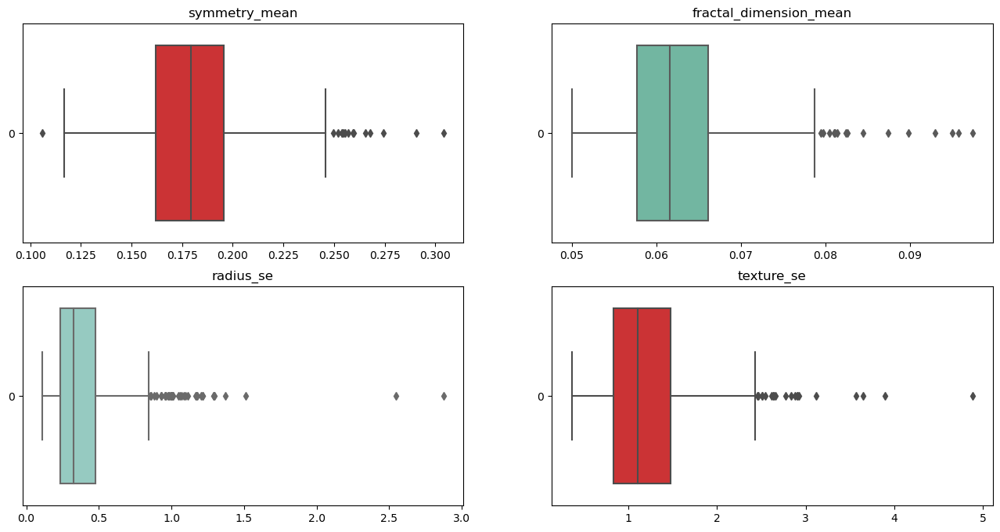

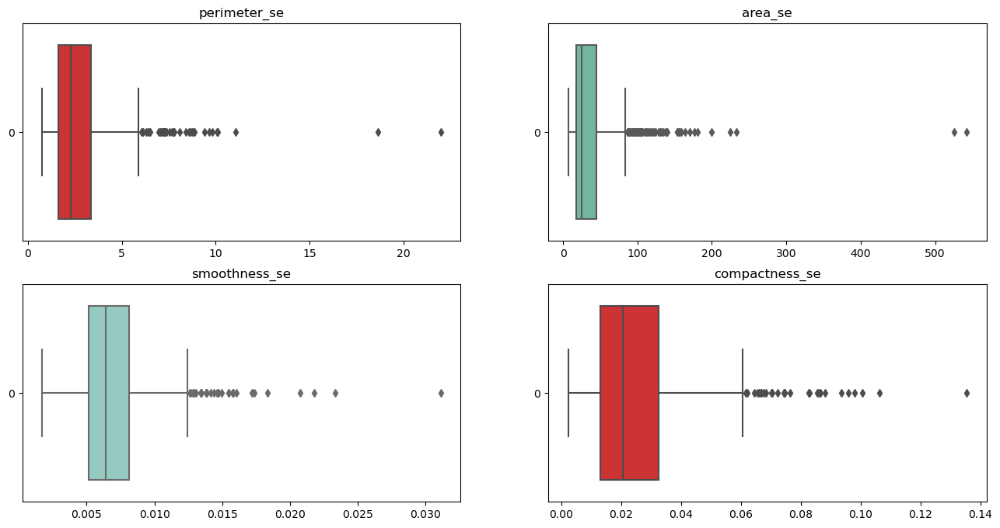

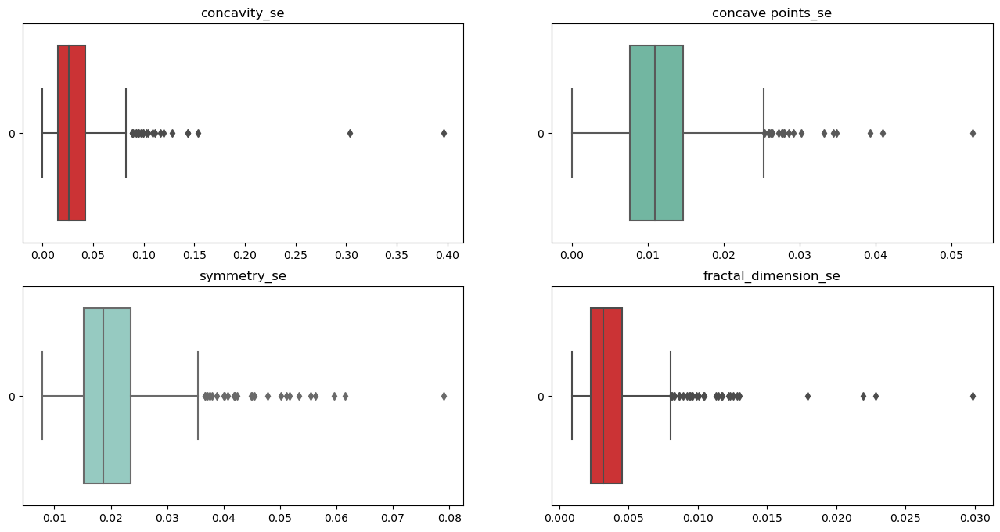

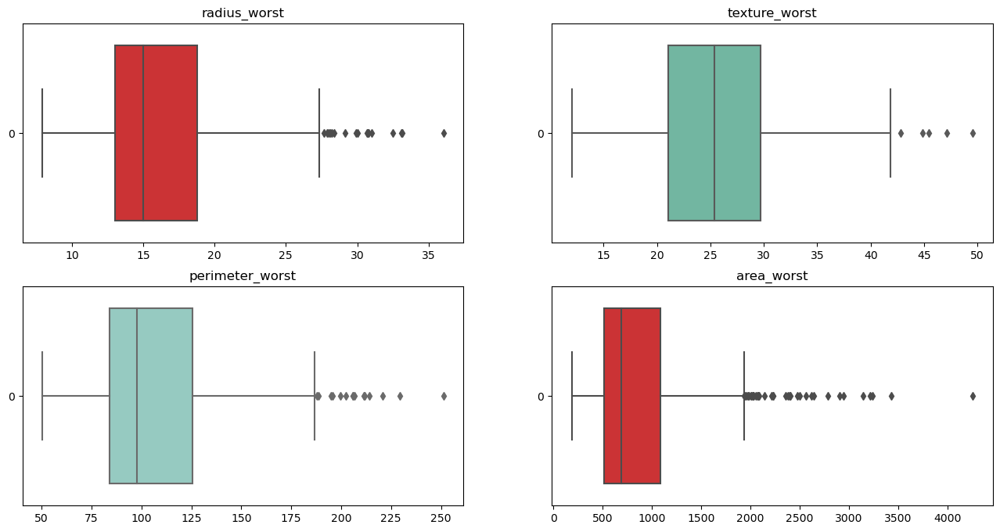

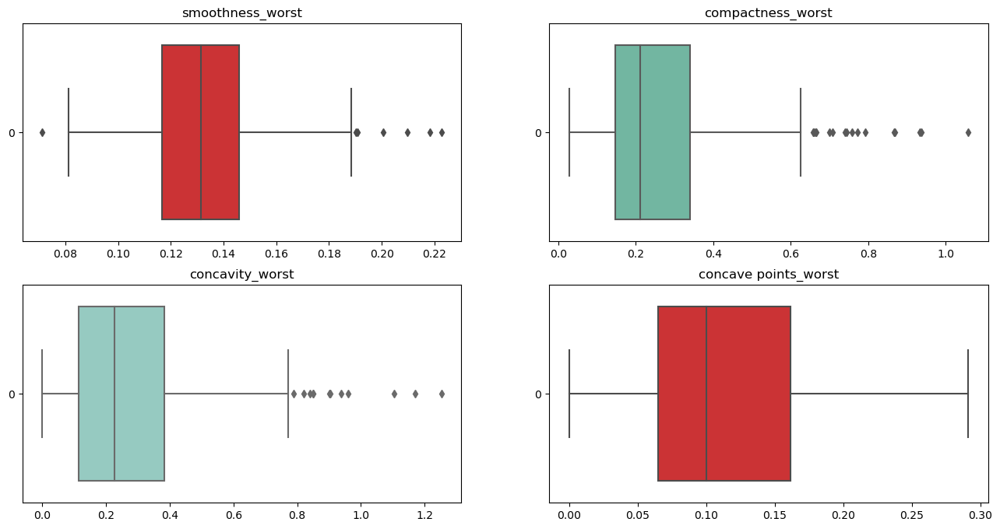

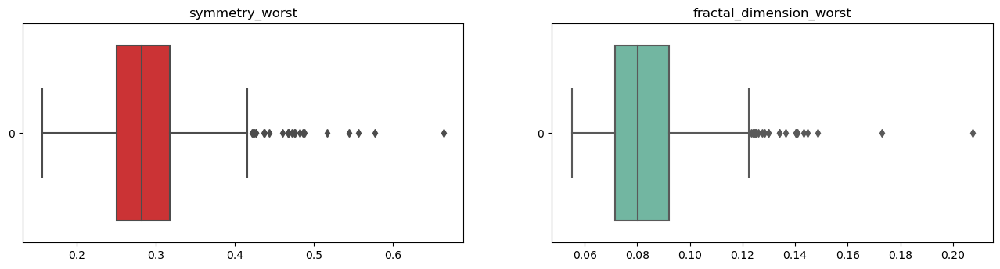

In [8]:
#Box plot for each feature to see the percentage of outlier in the data
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['radius_mean'],orient='h',palette="Set1").set(title='radius_mean')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['texture_mean'],orient='h',palette="Set2").set(title='texture_mean')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['perimeter_mean'],orient='h',palette="Set3").set(title='perimeter_mean')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['area_mean'],orient='h',palette="Set1").set(title='area_mean')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['smoothness_mean'],orient='h',palette="Set1").set(title='smoothness_mean')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['compactness_mean'],orient='h',palette="Set2").set(title='compactness_mean')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['concavity_mean'],orient='h',palette="Set3").set(title='concavity_mean')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['concave points_mean'],orient='h',palette="Set1").set(title='concave points_mean')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['symmetry_mean'],orient='h',palette="Set1").set(title='symmetry_mean')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['fractal_dimension_mean'],orient='h',palette="Set2").set(title='fractal_dimension_mean')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['radius_se'],orient='h',palette="Set3").set(title='radius_se')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['texture_se'],orient='h',palette="Set1").set(title='texture_se')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['perimeter_se'],orient='h',palette="Set1").set(title='perimeter_se')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['area_se'],orient='h',palette="Set2").set(title='area_se')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['smoothness_se'],orient='h',palette="Set3").set(title='smoothness_se')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['compactness_se'],orient='h',palette="Set1").set(title='compactness_se')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['concavity_se'],orient='h',palette="Set1").set(title='concavity_se')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['concave points_se'],orient='h',palette="Set2").set(title='concave points_se')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['symmetry_se'],orient='h',palette="Set3").set(title='symmetry_se')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['fractal_dimension_se'],orient='h',palette="Set1").set(title='fractal_dimension_se')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['radius_worst'],orient='h',palette="Set1").set(title='radius_worst')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['texture_worst'],orient='h',palette="Set2").set(title='texture_worst')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['perimeter_worst'],orient='h',palette="Set3").set(title='perimeter_worst')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['area_worst'],orient='h',palette="Set1").set(title='area_worst')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['smoothness_worst'],orient='h',palette="Set1").set(title='smoothness_worst')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['compactness_worst'],orient='h',palette="Set2").set(title='compactness_worst')
plt.subplot(2,2,3)
sns.boxplot(data = df_Cancergeometry['concavity_worst'],orient='h',palette="Set3").set(title='concavity_worst')
plt.subplot(2,2,4)
sns.boxplot(data = df_Cancergeometry['concave points_worst'],orient='h',palette="Set1").set(title='concave points_worst')
plt.show()
plt.figure(figsize=(16,8))
plt.subplot(2,2,1)
sns.boxplot(data = df_Cancergeometry['symmetry_worst'],orient='h',palette="Set1").set(title='symmetry_worst')
plt.subplot(2,2,2)
sns.boxplot(data = df_Cancergeometry['fractal_dimension_worst'],orient='h',palette="Set2").set(title='fractal_dimension_worst')
plt.show()


#### Calculate outlier percentage

In [9]:
for feature in df_Cancergeometry.columns:
    if(feature != None):        
        if(feature != 'id' and feature != 'diagnosis'):
            print(f'{feature} : {find_outliers_percentage(df_Cancergeometry[feature])}')

radius_mean : 0.02460456942003515
texture_mean : 0.012302284710017574
perimeter_mean : 0.022847100175746926
area_mean : 0.043936731107205626
smoothness_mean : 0.01054481546572935
compactness_mean : 0.028119507908611598
concavity_mean : 0.03163444639718805
concave points_mean : 0.01757469244288225
symmetry_mean : 0.026362038664323375
fractal_dimension_mean : 0.026362038664323375
radius_se : 0.06678383128295255
texture_se : 0.0351493848857645
perimeter_se : 0.06678383128295255
area_se : 0.11423550087873462
smoothness_se : 0.05272407732864675
compactness_se : 0.0492091388400703
concavity_se : 0.03866432337434095
concave points_se : 0.033391915641476276
symmetry_se : 0.04745166959578207
fractal_dimension_se : 0.0492091388400703
radius_worst : 0.029876977152899824
texture_worst : 0.008787346221441126
perimeter_worst : 0.026362038664323375
area_worst : 0.061511423550087874
smoothness_worst : 0.012302284710017574
compactness_worst : 0.028119507908611598
concavity_worst : 0.0210896309314587
co

#### Outlier percentage is not significant hence we can skip this for now and we will see the correlation is affecting due to outlier or not using both pearson and spearman correlation analysis. If both type of correlation are signifantly different then we will go for outlier removal

#### Show each feature wise mean and spread for different tumor type

In [10]:
print('========Highlight the each feature wise higher mean, max and min value======')
display(df_Cancergeometry[["diagnosis","radius_mean","texture_mean","perimeter_mean","area_mean","smoothness_mean","compactness_mean","concavity_mean","concave points_mean","symmetry_mean","fractal_dimension_mean","radius_se","texture_se","perimeter_se","area_se","smoothness_se","compactness_se","concavity_se","concave points_se","symmetry_se","fractal_dimension_se","radius_worst","texture_worst","perimeter_worst","area_worst","smoothness_worst","compactness_worst","concavity_worst","concave points_worst","symmetry_worst","fractal_dimension_worst"]].groupby(["diagnosis"]).agg(["max",'mean',"min"]).style.background_gradient(cmap="YlOrRd"))

========Highlight the each feature wise higher mean, max and min value======


#### Conclusive Statement 1 : Looking at the descriptive stats it is evident that if we are considering all features then fractal_dimension_mean, texture_se, smoothness_se, symmetry_se features has higher value for benign case compared to malignant.

#### Comparison of effective size to conclude two groups are different from each other or not

In [11]:
print('========Now verify the effective size of the features========')
for feature in df_Cancergeometry.columns:
    if(feature != None):        
        if(feature != 'id' and feature != 'diagnosis'):
            mean_diff = malignant_tumor_data[feature].mean() - benign_tumor_data[feature].mean()
            var_benign = benign_tumor_data[feature].var()
            var_malignant = malignant_tumor_data[feature].var()
            var_pooled = (len(benign_tumor_data)*var_benign +len(malignant_tumor_data)*var_malignant ) / float(len(benign_tumor_data)+ len(malignant_tumor_data))
            effect_size = mean_diff/np.sqrt(var_pooled)
            print(f"Effect size {feature}: ",effect_size)

========Now verify the effective size of the features========
Effect size radius_mean:  2.204858516504142
Effect size texture_mean:  0.9422854105647367
Effect size perimeter_mean:  2.288860779081179
Effect size area_mean:  2.0747649162508135
Effect size smoothness_mean:  0.7930532000054367
Effect size compactness_mean:  1.5342341463315061
Effect size concavity_mean:  2.0027617308321752
Effect size concave points_mean:  2.5443378299184864
Effect size symmetry_mean:  0.722953920334851
Effect size fractal_dimension_mean:  -0.026505879843037244
Effect size radius_se:  1.421028303295066
Effect size texture_se:  -0.017145472029568325
Effect size perimeter_se:  1.3809444086437452
Effect size area_se:  1.352666533789621
Effect size smoothness_se:  -0.1386796144533208
Effect size compactness_se:  0.6326733647440973
Effect size concavity_se:  0.5416734163797379
Effect size concave points_se:  0.9227929258871302
Effect size symmetry_se:  -0.013463091921153279
Effect size fractal_dimension_se:  0.

#### Conclusive Statement 1.1 : Effective size greater than 1 for any feature depicts two groups of tumor type has very different value for that particular feature, but now we have to check whether those features can be used for make conclusive statement or not. Those features are, radius_mean,perimeter_mean,area_mean,compactness_mean,concavity_mean,concave points_mean, radius_se, perimeter_se,area_se,radius_worst, texture_worst,area_worst,compactness_worst,concavity_worst,concave points_worst.

#### Create plot to see the variance in graphical way to identify the overlapping in the spread for different tumor type

========Now verify the spread of each feature value for diffent types of tumor to understand the variance========


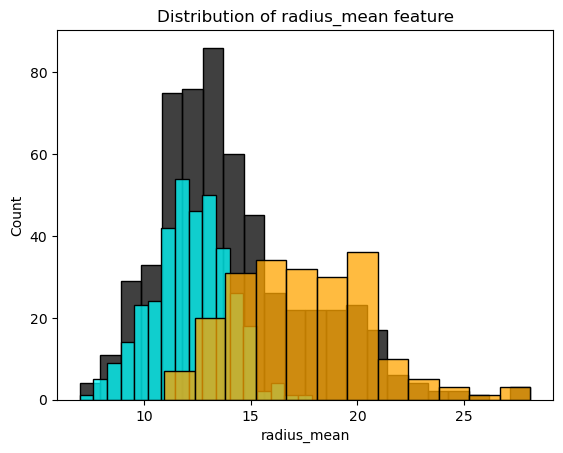

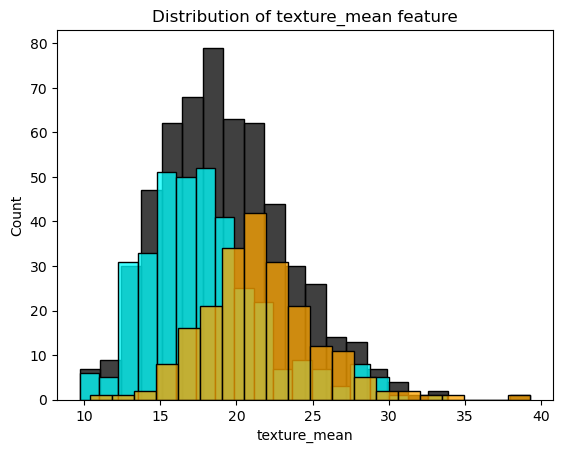

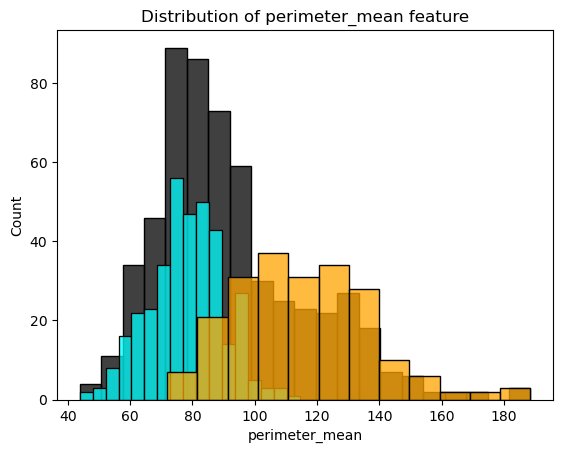

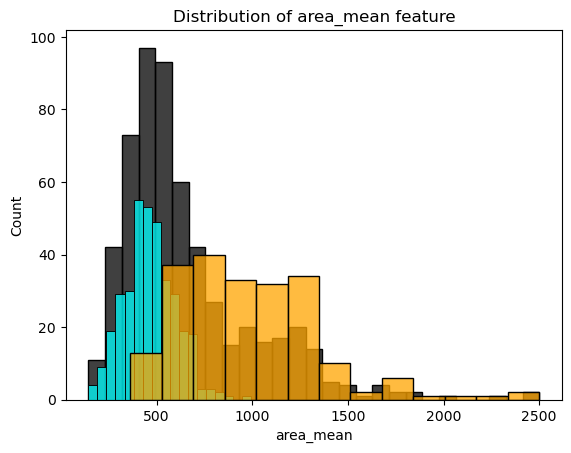

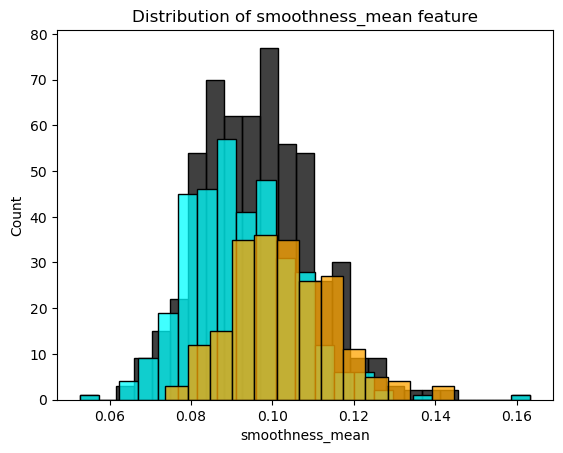

...

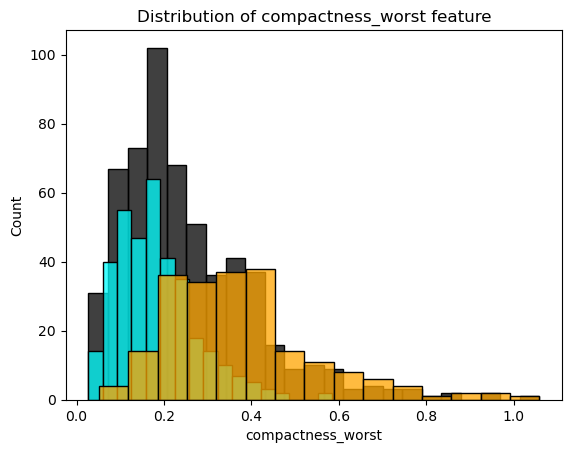

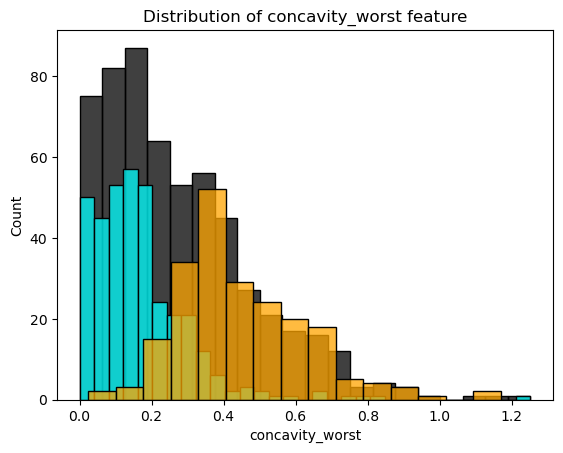

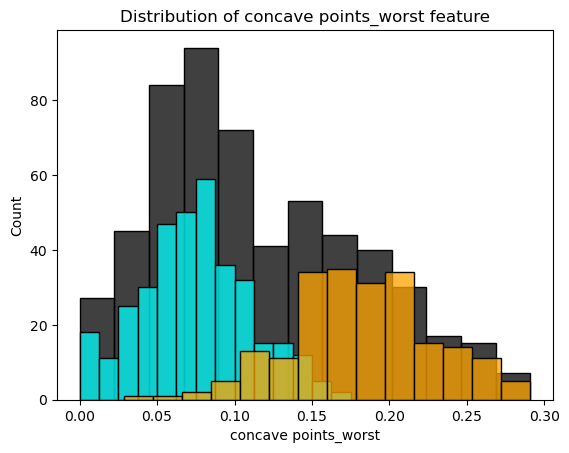

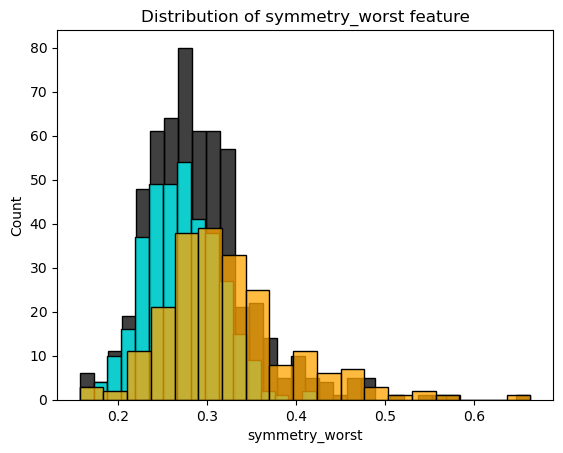

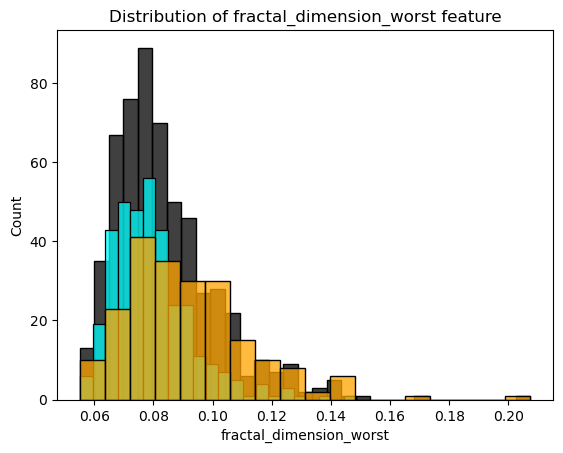

In [12]:
print('========Now verify the spread of each feature value for diffent types of tumor to understand the variance========')
for feature in df_Cancergeometry.columns:
    if(feature != None):        
        if(feature != 'id' and feature != 'diagnosis'):
            sns.histplot(df_Cancergeometry[feature], color="black") # For total set of data
            sns.histplot(benign_tumor_data[feature], color="cyan") # For only benign tumor
            sns.histplot(malignant_tumor_data[feature], color="orange") # For only malignant tumor
            plt.title(f"Distribution of {feature} feature")
            plt.show()

#### To understand which feature can be well suited for identifying the type of tumor we need to understand the conclusion drawn capability of that feature.
#### One way to look at it is identifying the minimum overlap in the distribution of benign and malignant tumor for each feature If there is very less or no overlap in distribution for any feature we can consider that feature as a conclusive feature in identifying tumor.

#### Create violin plot for verifying the overlapping percentage

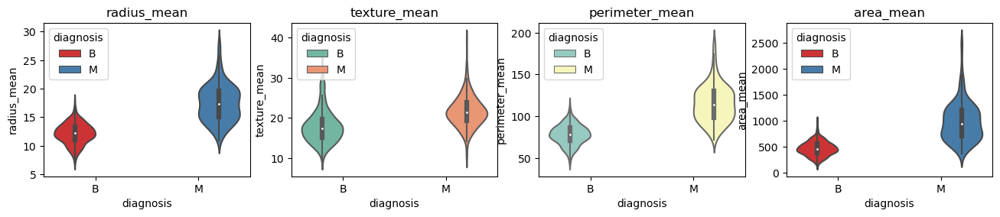

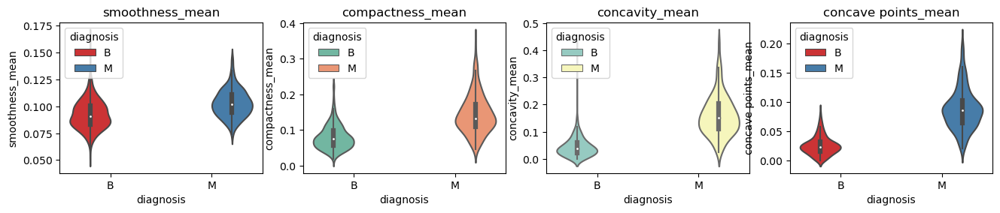

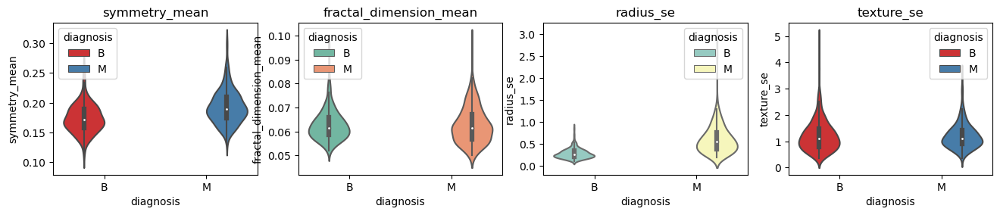

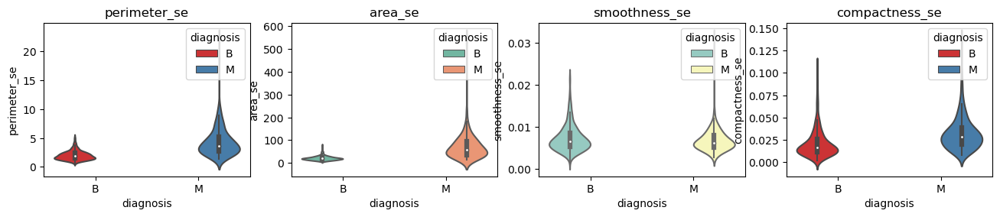

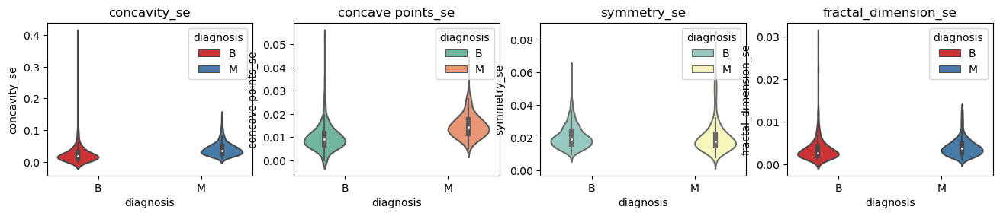

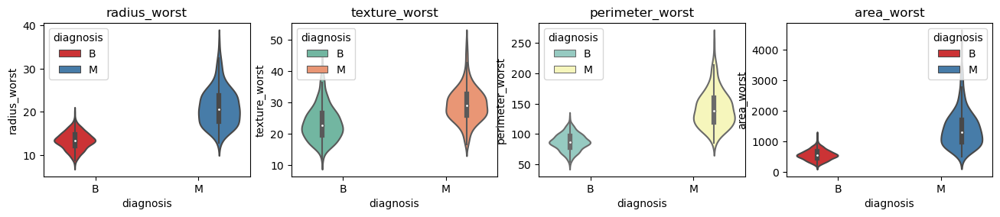

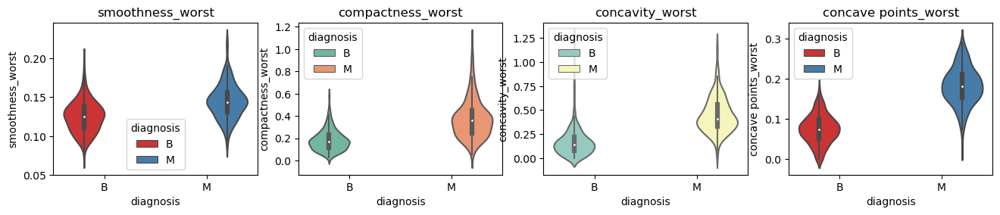

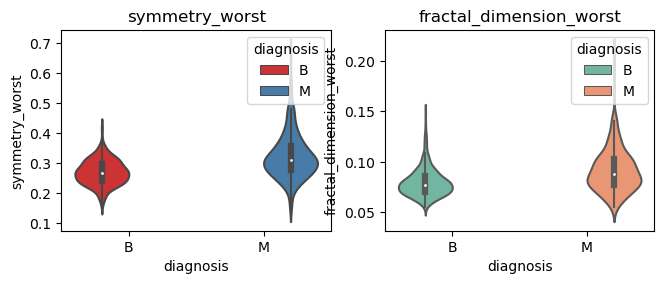

In [13]:
plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='radius_mean',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='radius_mean')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='texture_mean',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='texture_mean')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='perimeter_mean',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='perimeter_mean')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='area_mean',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='area_mean')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='smoothness_mean',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='smoothness_mean')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='compactness_mean',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='compactness_mean')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='concavity_mean',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='concavity_mean')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='concave points_mean',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='concave points_mean')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='symmetry_mean',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='symmetry_mean')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='fractal_dimension_mean',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='fractal_dimension_mean')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='radius_se',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='radius_se')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='texture_se',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='texture_se')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='perimeter_se',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='perimeter_se')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='area_se',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='area_se')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='smoothness_se',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='smoothness_se')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='compactness_se',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='compactness_se')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='concavity_se',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='concavity_se')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='concave points_se',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='concave points_se')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='symmetry_se',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='symmetry_se')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='fractal_dimension_se',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='fractal_dimension_se')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='radius_worst',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='radius_worst')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='texture_worst',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='texture_worst')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='perimeter_worst',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='perimeter_worst')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='area_worst',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='area_worst')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='smoothness_worst',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='smoothness_worst')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='compactness_worst',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='compactness_worst')
plt.subplot(4,4,3)
sns.violinplot(data = df_Cancergeometry,y='concavity_worst',x='diagnosis',orient='v',palette="Set3",hue='diagnosis').set(title='concavity_worst')
plt.subplot(4,4,4)
sns.violinplot(data = df_Cancergeometry,y='concave points_worst',x='diagnosis',orient='v',palette="Set1",hue='diagnosis').set(title='concave points_worst')
plt.show()

plt.figure(figsize=(16,12))
plt.subplot(4,4,1)
sns.violinplot(data = df_Cancergeometry,y='symmetry_worst',x='diagnosis',orient='v',palette="Set1", hue='diagnosis').set(title='symmetry_worst')
plt.subplot(4,4,2)
sns.violinplot(data = df_Cancergeometry,y='fractal_dimension_worst',x='diagnosis',orient='v',palette="Set2",hue='diagnosis').set(title='fractal_dimension_worst')
plt.show()

##### Conclusive Statement 1.2 : The violin plot is very efficient in comparing distributions of different variables. I can see below observation from the violin plot and histplot,
#####  1. mean radius, mean area, mean concave points, worst radius, worst perimeter, worst area, worst concave points are the good feature for classification problem because of their overlapping nature, though we have to verify the correlation behavior.
##### 2. For few feature the distribution looks very similar like mean smoothness, mean symmetry, mean fractual dimension, smoothness error, overlapping percentage will give clear picture for the same.
##### 3. Due to same distribution few feature definitely have high correlation too so we have to check the correlation for them also like mean perimeter vs. mean area, mean concavity vs. mean concave points, and worst symmetry vs. worst fractal dimension. According to PCA this is not required to keep highly correlated feature all together for model building which will leads to dimensionality curse problem. so only single feature can be considered as significant.

#### Pairplot for mean parameter

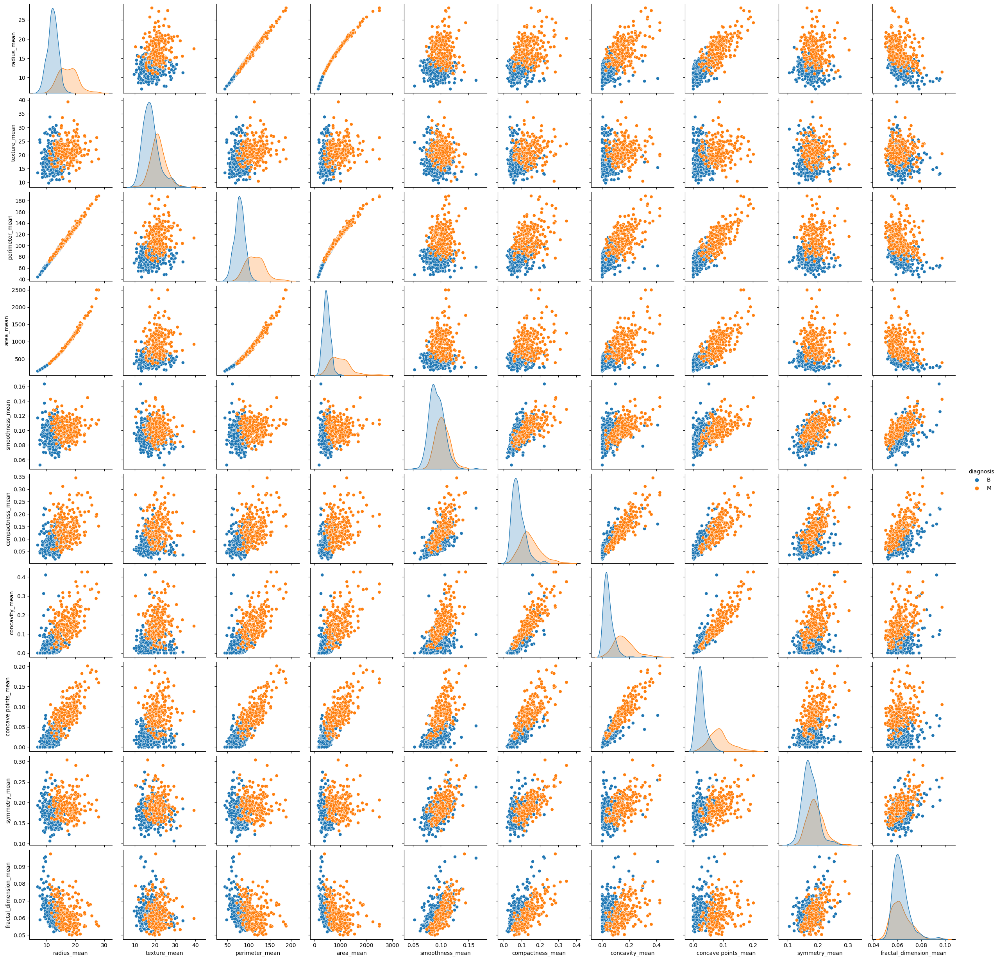

In [14]:
sns.pairplot(df_Cancergeometry[['diagnosis',"radius_mean","texture_mean","perimeter_mean","area_mean","smoothness_mean","compactness_mean","concavity_mean","concave points_mean","symmetry_mean","fractal_dimension_mean"]],hue="diagnosis")
plt.show()

#### Pairplot for SE parameter

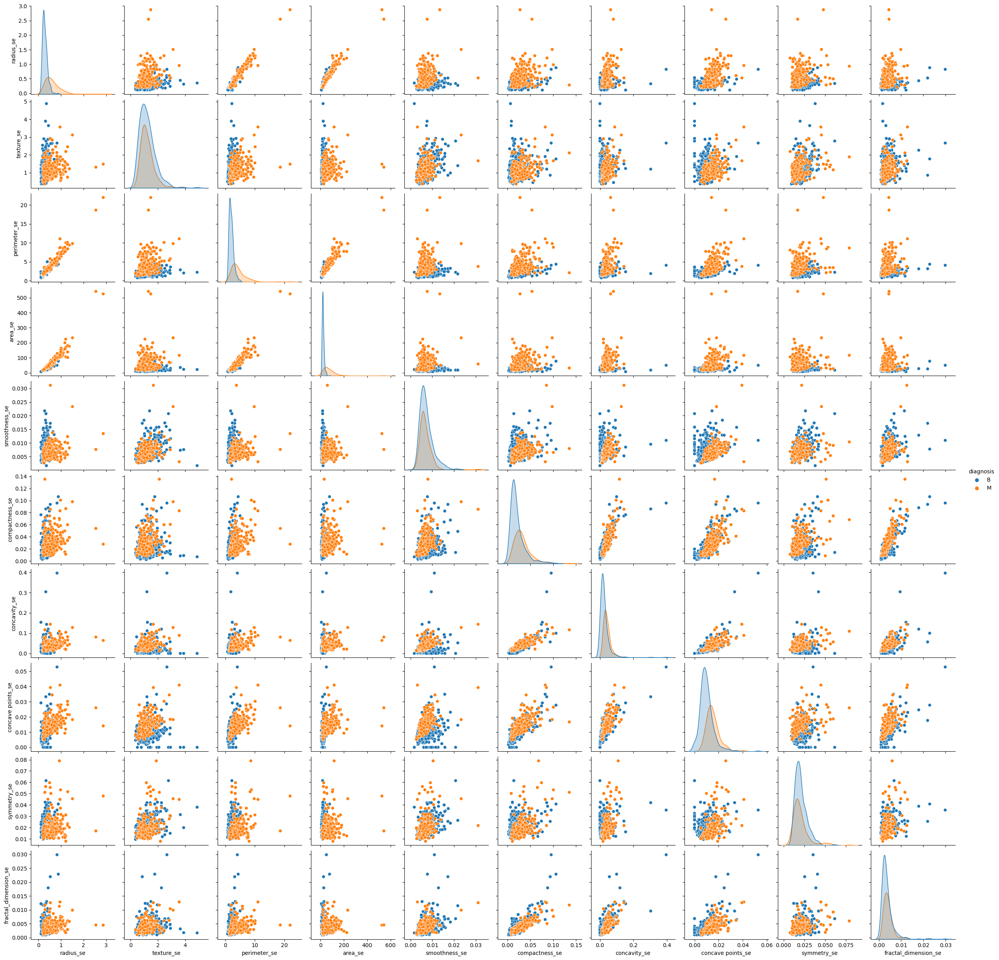

In [15]:
sns.pairplot(df_Cancergeometry[['diagnosis',"radius_se","texture_se","perimeter_se","area_se","smoothness_se","compactness_se","concavity_se","concave points_se","symmetry_se","fractal_dimension_se"]],hue="diagnosis")
plt.show()

#### Pairplot for Worst parameter

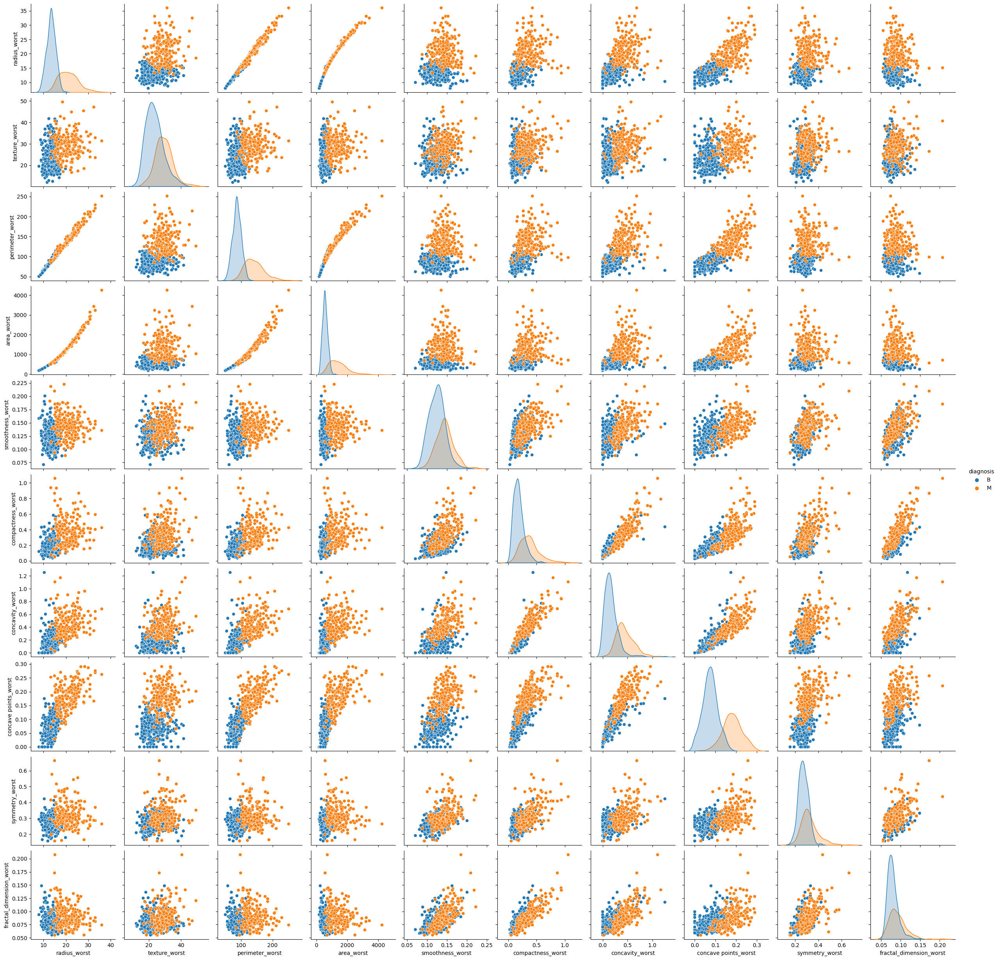

In [16]:
sns.pairplot(df_Cancergeometry[['diagnosis',"radius_worst","texture_worst","perimeter_worst","area_worst","smoothness_worst","compactness_worst","concavity_worst","concave points_worst","symmetry_worst","fractal_dimension_worst"]],hue="diagnosis")
plt.show()

#### Pairplot also giving same intuition like hist plot and violin, Now we have to perform analysis on the overlapping percentage for further conclusion.

#### Calculate the overlapping of the spread for different features

In [17]:
#Understanding the overlapping percentage to identify valuable feature in identifying the tumor type
df_Corr_overlappingPercentage = pd.DataFrame(columns=['Feature', 'OverlappingPercentage', 'Correlation']) 
for feature in df_Cancergeometry.columns:
    if(feature != None):        
        if(feature != 'id' and feature != 'diagnosis'):
            i1, i2 = [np.min(benign_tumor_data[feature]), np.max(benign_tumor_data[feature])], [np.min(malignant_tumor_data[feature]), np.max(malignant_tumor_data[feature])]
            print(f'Overlapping percentage of {feature} is {overlapping_percentage(i1, i2)}')
            df_intermediate_data = {'Feature': feature, 'OverlappingPercentage': overlapping_percentage(i1, i2), 'Correlation': 0}
            df_Corr_overlappingPercentage = pd.concat([df_Corr_overlappingPercentage, pd.DataFrame([df_intermediate_data])],ignore_index=True)
        


Overlapping percentage of radius_mean is 40%
Overlapping percentage of texture_mean is 81%
Overlapping percentage of perimeter_mean is 36%
Overlapping percentage of area_mean is 29%
Overlapping percentage of smoothness_mean is 100%
Overlapping percentage of compactness_mean is 59%
Overlapping percentage of concavity_mean is 96%
Overlapping percentage of concave points_mean is 35%
Overlapping percentage of symmetry_mean is 82%
Overlapping percentage of fractal_dimension_mean is 92%
Overlapping percentage of radius_se is 25%
Overlapping percentage of texture_se is 100%
Overlapping percentage of perimeter_se is 18%
Overlapping percentage of area_se is 11%
Overlapping percentage of smoothness_se is 67%
Overlapping percentage of compactness_se is 77%
Overlapping percentage of concavity_se is 100%
Overlapping percentage of concave points_se is 100%
Overlapping percentage of symmetry_se is 73%
Overlapping percentage of fractal_dimension_se is 100%
Overlapping percentage of radius_worst is 30%

#### Conclusive Statement 2 : Overlapping percentage is 100% for feature like smoothness_mean, texture_se(cant be consider as it has very low negative correlation), concavity_se, concave points_se, fractal_dimension_se, concavity_worst. hence these features can not be used for arriving any conclusion on tumor type as there is no unique region identified for benign and malignant tumor.

#### Scatter plot against each feature and target (diagnosis) value to reverify the overlapping percentage conclusion 

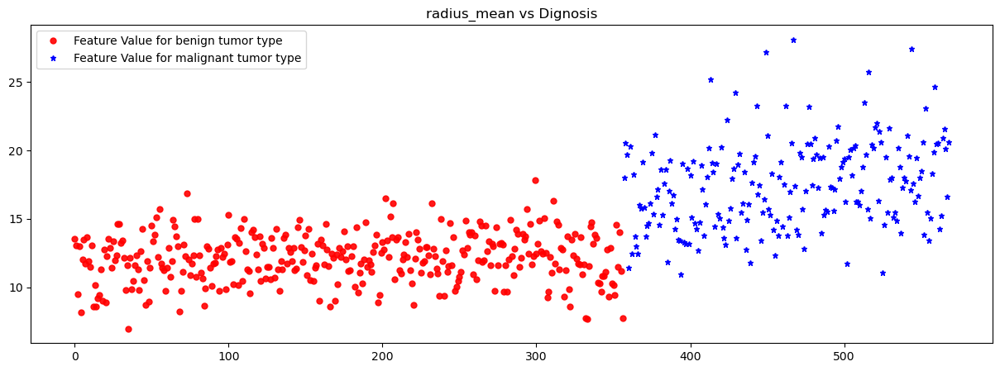

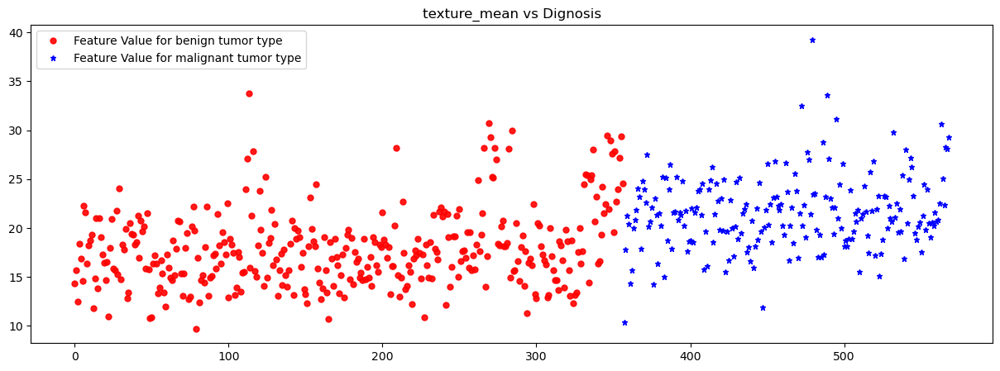

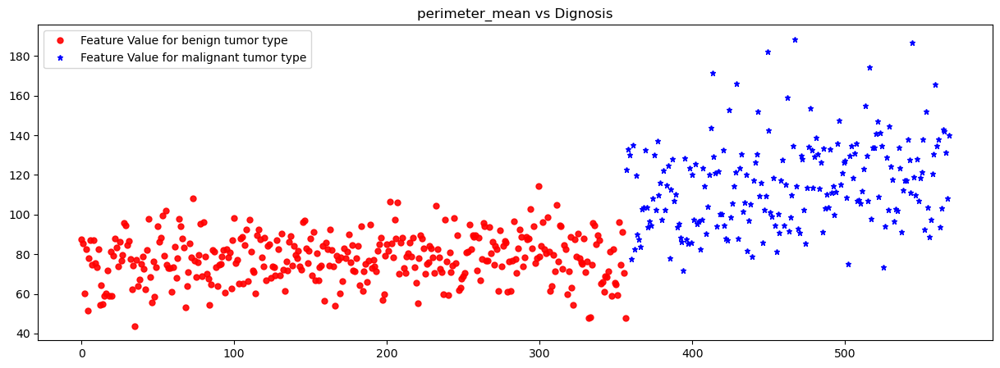

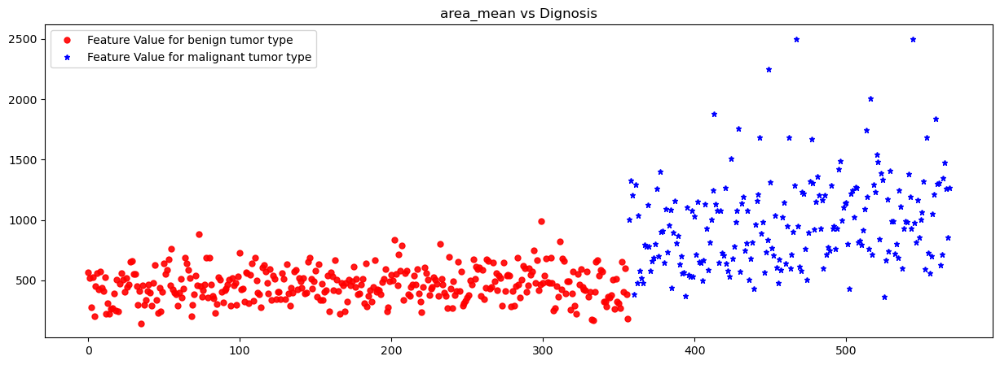

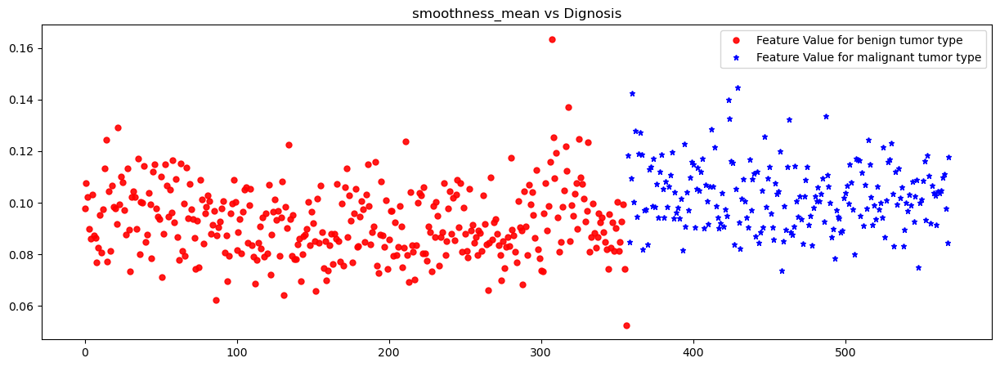

...

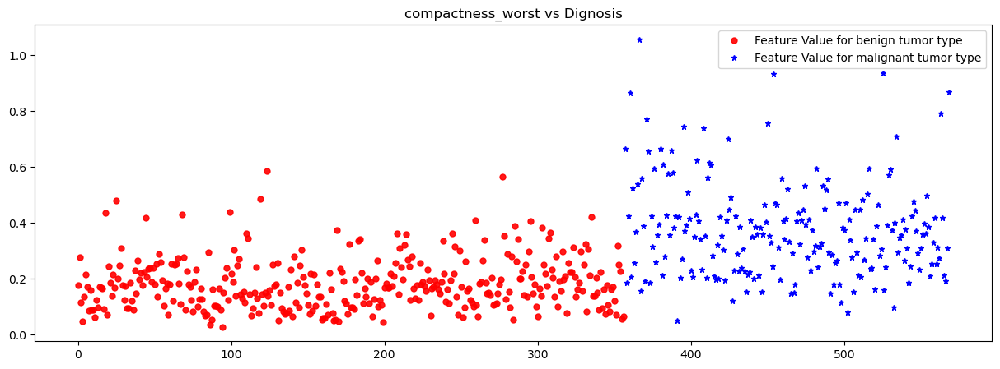

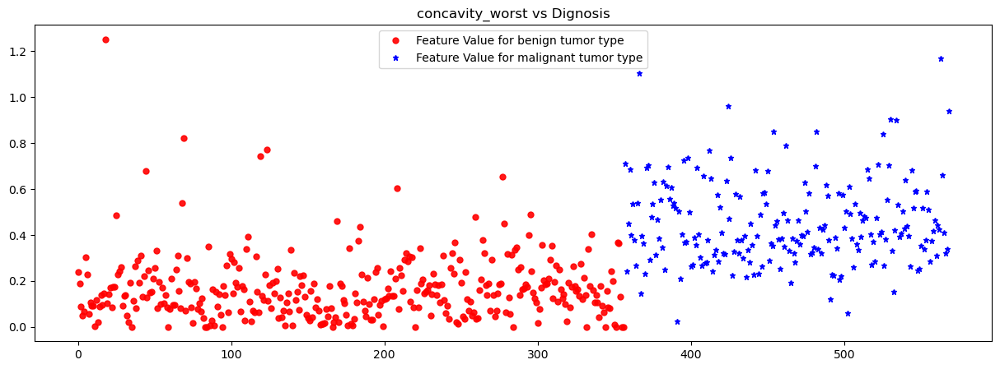

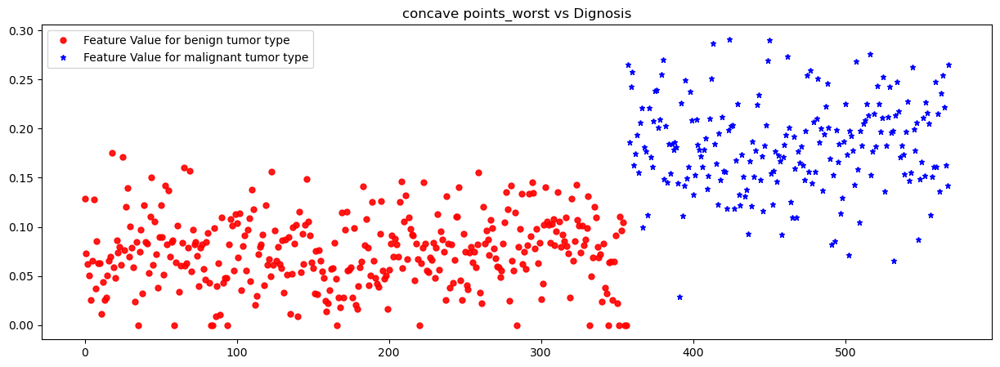

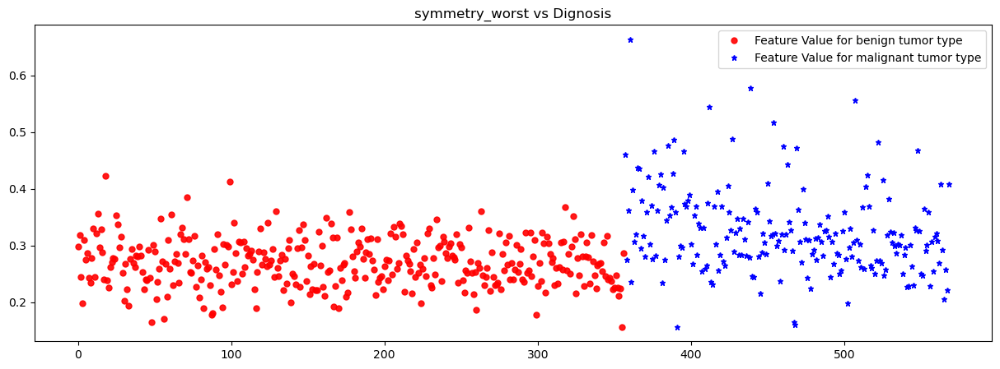

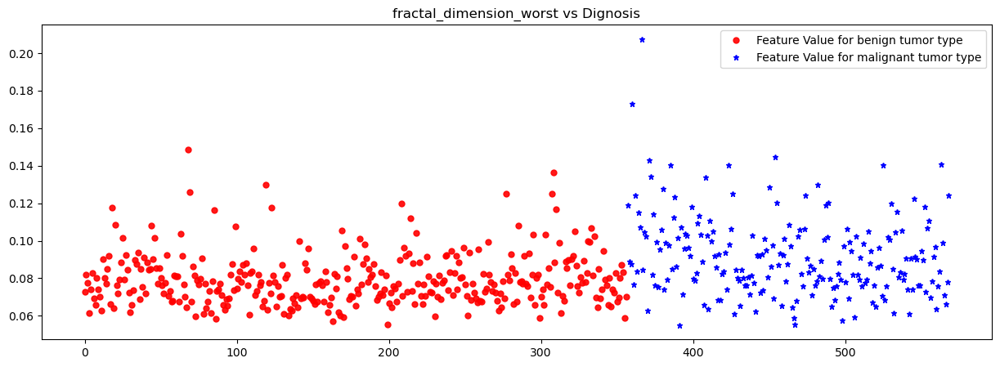

In [18]:
for feature in df_Cancergeometry.columns:
    if(feature != None):        
        if(feature != 'id' and feature != 'diagnosis'):
            plt.figure(figsize=(15,5))
            plt.plot(benign_tumor_data[feature],'.r',markersize=10,alpha=0.9,label='Feature Value for benign tumor type')
            plt.plot(malignant_tumor_data[feature],'b*',markersize=5,label='Feature Value for malignant tumor type')
            plt.legend()            
            plt.title(f'{feature} vs Dignosis')
            plt.show()

#### Overlapping percentage calculated using histplot and scatter plot are supporting each other, so we can strict to conclusive statement 2 even after revisiting the scatter plots

#### Calculate the correlation of different features with target variable & display using heat map

=========Check for the correlation between different feature==========


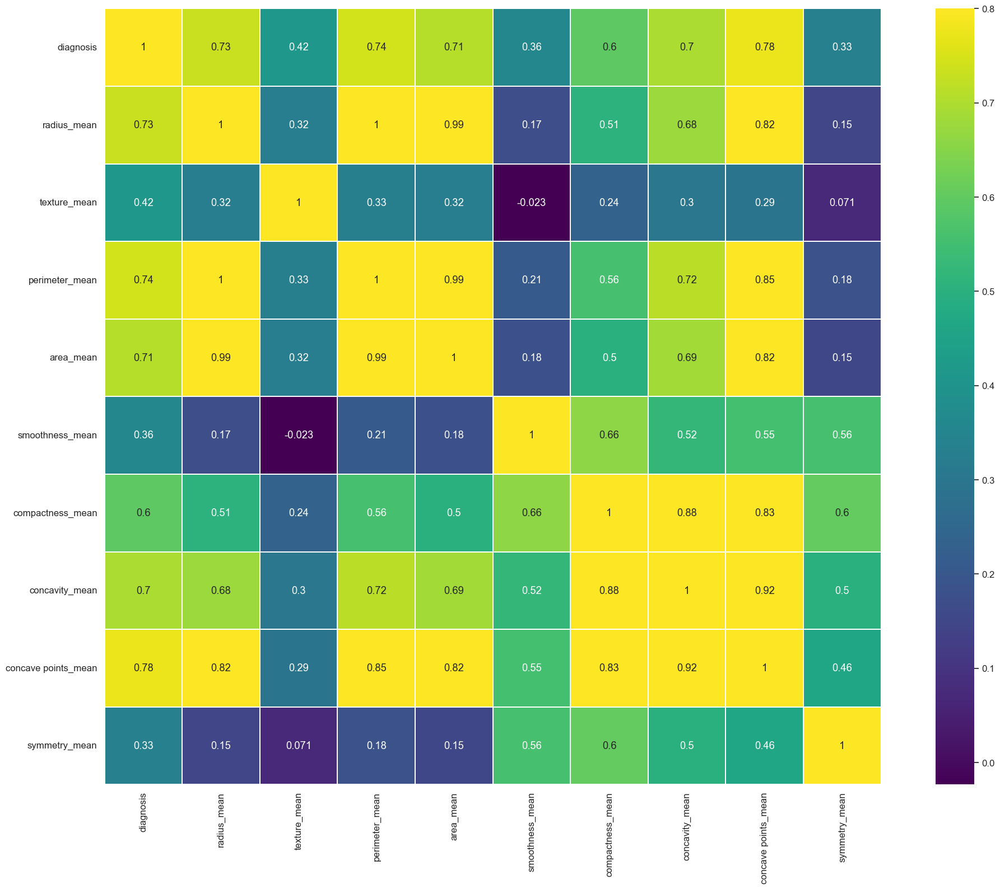

In [19]:
print('=========Check for the correlation between different feature==========')
#Apply encoding in categorical field diagnosis
df_Cancergeometry['diagnosis'] = df_Cancergeometry['diagnosis'].apply(encoder_diag)
#Creating heat map to see the correlation in a very clear way
correlationMatrix=df_Cancergeometry[["diagnosis","radius_mean","texture_mean","perimeter_mean","area_mean","smoothness_mean","compactness_mean",
                 "concavity_mean","concave points_mean","symmetry_mean"]].corr()
sns.set(font_scale=1.10)
plt.figure(figsize=(25, 18))
sns.heatmap(correlationMatrix, vmax=.8, linewidths=0.01,square=True,annot=True,cmap='viridis',linecolor="white")
plt.show()

=========Check for the correlation between different feature==========


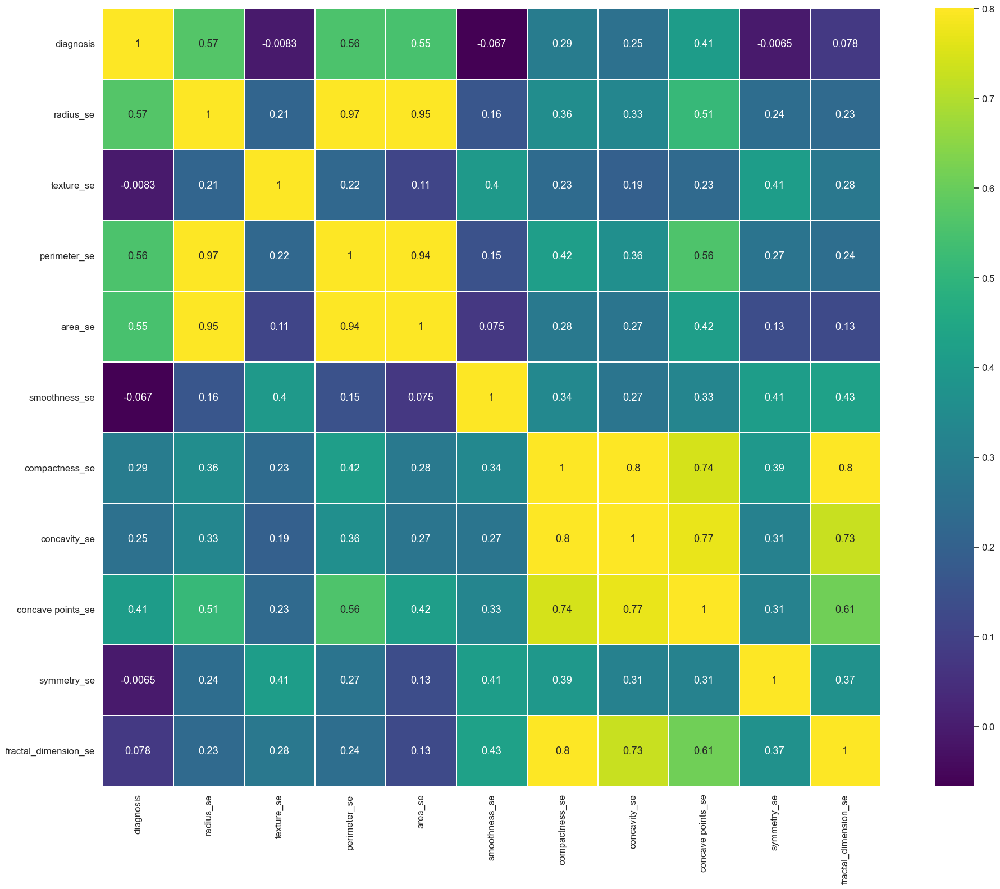

In [20]:
print('=========Check for the correlation between different feature==========')
#Creating heat map to see the correlation in a very clear way
correlationMatrix=df_Cancergeometry[["diagnosis","radius_se","texture_se",
                 "perimeter_se","area_se","smoothness_se","compactness_se","concavity_se","concave points_se","symmetry_se",
                 "fractal_dimension_se"]].corr()
sns.set(font_scale=1.10)
plt.figure(figsize=(25, 18))
sns.heatmap(correlationMatrix, vmax=.8, linewidths=0.01,square=True,annot=True,cmap='viridis',linecolor="white")
plt.show()

=========Check for the correlation between different feature==========


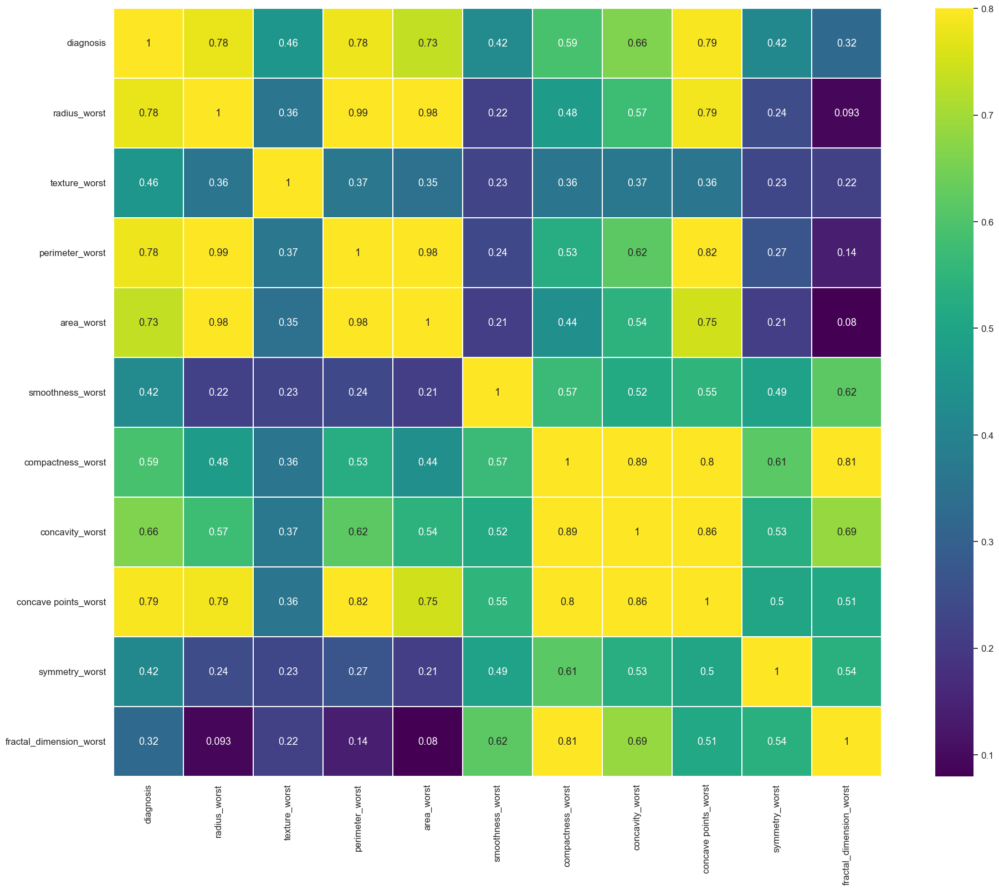

In [21]:
print('=========Check for the correlation between different feature==========')
#Creating heat map to see the correlation in a very clear way
correlationMatrix=df_Cancergeometry[["diagnosis","radius_worst","texture_worst","perimeter_worst","area_worst","smoothness_worst",
                 "compactness_worst","concavity_worst","concave points_worst","symmetry_worst","fractal_dimension_worst"]].corr()
sns.set(font_scale=1.10)
plt.figure(figsize=(25, 18))
sns.heatmap(correlationMatrix, vmax=.8, linewidths=0.01,square=True,annot=True,cmap='viridis',linecolor="white")
plt.show()

#### Looking at the correlation number we can observe that radius is highly correlated with perimeter, area, concavity, concave point. So as per PCA concept we can use only radius instead of all, which should give correct prediction. Further analysis is required for conclusion
#### Correlated features are : mean perimeter vs. mean area, mean concavity vs. mean concave points, and worst symmetry vs. worst fractal dimension

In [22]:
print('=========Correlation between dignosis column with other features for identifying the type of tumor=========')
#Calculate the correlation between dignosis column with other feature for detecting the type of tumor
correlation_cancerType_withFeature=df_Cancergeometry.corr()["diagnosis"]
correlation_cancerType_withFeature[np.argsort(correlation_cancerType_withFeature, axis=0)[:-1]]

for index, row in df_Corr_overlappingPercentage.iterrows():
    if(row['Feature'] == 'radius_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.radius_mean                
    if(row['Feature'] == 'texture_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.texture_mean 
    if(row['Feature'] == 'perimeter_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.perimeter_mean 
    if(row['Feature'] == 'area_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.area_mean                
    if(row['Feature'] == 'smoothness_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.smoothness_mean 
    if(row['Feature'] == 'compactness_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.compactness_mean    
    if(row['Feature'] == 'concavity_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.concavity_mean                
    if(row['Feature'] == 'concave points_mean'):
        row['Correlation'] = correlation_cancerType_withFeature['concave points_mean']
    if(row['Feature'] == 'symmetry_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.symmetry_mean 
    if(row['Feature'] == 'fractal_dimension_mean'):
        row['Correlation'] = correlation_cancerType_withFeature.fractal_dimension_mean                
    if(row['Feature'] == 'radius_se'):
        row['Correlation'] = correlation_cancerType_withFeature.radius_se 
    if(row['Feature'] == 'texture_se'):
        row['Correlation'] = correlation_cancerType_withFeature.texture_se    
    if(row['Feature'] == 'perimeter_se'):
        row['Correlation'] = correlation_cancerType_withFeature.perimeter_se                 
    if(row['Feature'] == 'area_se'):
        row['Correlation'] = correlation_cancerType_withFeature.area_se 
    if(row['Feature'] == 'smoothness_se'):
        row['Correlation'] = correlation_cancerType_withFeature.smoothness_se 
    if(row['Feature'] == 'compactness_se'):
        row['Correlation'] = correlation_cancerType_withFeature.compactness_se                
    if(row['Feature'] == 'concavity_se'):
        row['Correlation'] = correlation_cancerType_withFeature.concavity_se 
    if(row['Feature'] == 'concave points_se'):
        row['Correlation'] = correlation_cancerType_withFeature['concave points_se']    
    if(row['Feature'] == 'symmetry_se'):
        row['Correlation'] = correlation_cancerType_withFeature.symmetry_se                
    if(row['Feature'] == 'fractal_dimension_se'):
        row['Correlation'] = correlation_cancerType_withFeature.fractal_dimension_se 
    if(row['Feature'] == 'radius_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.radius_worst 
    if(row['Feature'] == 'texture_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.texture_worst                
    if(row['Feature'] == 'perimeter_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.perimeter_worst 
    if(row['Feature'] == 'area_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.area_worst    
    if(row['Feature'] == 'smoothness_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.smoothness_worst                
    if(row['Feature'] == 'compactness_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.compactness_worst 
    if(row['Feature'] == 'concavity_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.concavity_worst 
    if(row['Feature'] == 'concave points_worst'):
        row['Correlation'] = correlation_cancerType_withFeature['concave points_worst']                
    if(row['Feature'] == 'symmetry_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.symmetry_worst 
    if(row['Feature'] == 'fractal_dimension_worst'):
        row['Correlation'] = correlation_cancerType_withFeature.fractal_dimension_worst  
print(correlation_cancerType_withFeature)

=========Correlation between dignosis column with other features for identifying the type of tumor=========
id                         0.039769
diagnosis                  1.000000
radius_mean                0.730029
texture_mean               0.415185
perimeter_mean             0.742636
area_mean                  0.708984
smoothness_mean            0.358560
compactness_mean           0.596534
concavity_mean             0.696360
concave points_mean        0.776614
symmetry_mean              0.330499
fractal_dimension_mean    -0.012838
radius_se                  0.567134
texture_se                -0.008303
perimeter_se               0.556141
area_se                    0.548236
smoothness_se             -0.067016
compactness_se             0.292999
concavity_se               0.253730
concave points_se          0.408042
symmetry_se               -0.006522
fractal_dimension_se       0.077972
radius_worst               0.776454
texture_worst              0.456903
perimeter_worst            0

#### Calculate Spearman's Rank Correlation as this is works well if the relationship between features are linear and roughly normal. More over it is much robust, if there are outliers.

In [23]:
ranked_data = df_Cancergeometry.rank()
spearman_corr = ranked_data.loc[:,["diagnosis","radius_mean","texture_mean","perimeter_mean","area_mean","smoothness_mean","compactness_mean",
                 "concavity_mean","concave points_mean","symmetry_mean","fractal_dimension_mean","radius_se","texture_se",
                 "perimeter_se","area_se","smoothness_se","compactness_se","concavity_se","concave points_se","symmetry_se",
                 "fractal_dimension_se","radius_worst","texture_worst","perimeter_worst","area_worst","smoothness_worst",
                 "compactness_worst","concavity_worst","concave points_worst","symmetry_worst","fractal_dimension_worst"]].corr(method= "pearson")
print("Spearman's correlation: ")
spearman_corr

Spearman's correlation: 


,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,1.000000,0.732785,0.461971,0.748496,0.734122,0.371892,0.609288,0.733308,0.777877,0.332567,...,0.787933,0.476720,0.796319,0.786902,0.425513,0.606810,0.705734,0.781674,0.396843,0.311477
radius_mean,0.732785,1.000000,0.340956,0.997802,0.999602,0.148510,0.497578,0.645728,0.759702,0.120242,...,0.978604,0.314911,0.971555,0.978863,0.125789,0.491357,0.596043,0.727265,0.174698,0.044564
texture_mean,0.461971,0.340956,1.000000,0.348142,0.344145,0.024649,0.266499,0.342646,0.306891,0.110130,...,0.366547,0.909218,0.375273,0.368335,0.101401,0.290917,0.339725,0.319235,0.120693,0.116144
perimeter_mean,0.748496,0.997802,0.348142,1.000000,0.997068,0.182923,0.543925,0.681958,0.788629,0.150049,...,0.981244,0.323109,0.978980,0.980864,0.156611,0.534565,0.632106,0.757526,0.199007,0.088961
area_mean,0.734122,0.999602,0.344145,0.997068,1.000000,0.138053,0.488988,0.642557,0.755165,0.113928,...,0.979258,0.318178,0.971822,0.980264,0.119712,0.485813,0.593736,0.723390,0.170860,0.038758
smoothness_mean,0.371892,0.148510,0.024649,0.182923,0.138053,1.000000,0.678806,0.518511,0.565172,0.542228,...,0.203453,0.060645,0.226345,0.191735,0.796085,0.481384,0.429107,0.498868,0.393579,0.511457
compactness_mean,0.609288,0.497578,0.266499,0.543925,0.488988,0.678806,1.000000,0.896518,0.848295,0.552203,...,0.542626,0.255305,0.592254,0.531590,0.578902,0.901029,0.837921,0.825473,0.450333,0.688986
concavity_mean,0.733308,0.645728,0.342646,0.681958,0.642557,0.518511,0.896518,1.000000,0.927352,0.446793,...,0.682316,0.335866,0.722424,0.676628,0.488775,0.849985,0.938543,0.904938,0.383667,0.541838
concave points_mean,0.777877,0.759702,0.306891,0.788629,0.755165,0.565172,0.848295,0.927352,1.000000,0.423767,...,0.787411,0.300562,0.813960,0.780395,0.490035,0.758309,0.827281,0.937075,0.355477,0.421110
symmetry_mean,0.332567,0.120242,0.110130,0.150049,0.113928,0.542228,0.552203,0.446793,0.423767,1.000000,...,0.164552,0.118890,0.190526,0.154462,0.424230,0.440828,0.394481,0.397477,0.710359,0.410069


#### Spearman's correlation is little higher than pearson correlation, but there is no major difference which signifies no change to our conclusion made based on heat map analysis hence no outlier removal is required.


#### Conclusive Statement 3 : Tumor type is highly correlated with radius_mean, perimeter_mean, area_mean, concavity_mean, concave points_mean, radius_worst, perimeter_worst, area_worst, concavity_worst(cant be consider as overlapping percentage is 100% so not conclusive), concave points_worst features


#### Conclusive Statement 4 : fractal_dimension_mean, smoothness_se, symmetry_se features has very insignificant correlation with the type of tumor, so before concluding on rejecting these features we have to check whether this feature has any significant correlation with other feature

#### Analysis based on correlation continues here 

In [24]:
print('=========Correlation of fractal_dimension_mean feature with other fearures=========')
print(df_Cancergeometry.corr()["fractal_dimension_mean"])
print('=========Correlation of smoothness_se feature with other fearures=========')
print(df_Cancergeometry.corr()["smoothness_se"])
print('=========Correlation of symmetry_se feature with other fearures=========')
print(df_Cancergeometry.corr()["symmetry_se"])

=========Correlation of fractal_dimension_mean feature with other fearures=========
id                        -0.052511
diagnosis                 -0.012838
radius_mean               -0.311631
texture_mean              -0.076437
perimeter_mean            -0.261477
area_mean                 -0.283110
smoothness_mean            0.584792
compactness_mean           0.565369
concavity_mean             0.336783
concave points_mean        0.166917
symmetry_mean              0.479921
fractal_dimension_mean     1.000000
radius_se                  0.000111
texture_se                 0.164174
perimeter_se               0.039830
area_se                   -0.090170
smoothness_se              0.401964
compactness_se             0.559837
concavity_se               0.446630
concave points_se          0.341198
symmetry_se                0.345007
fractal_dimension_se       0.688132
radius_worst              -0.253691
texture_worst             -0.051269
perimeter_worst           -0.205151
area_worst      

#### Conclusive Statement 6 : fractal_dimension_mean, smoothness_se, symmetry_se features does not have any significant correlation with other features along with insignificant correlation with tumor type, hence we can say that this features can not be used as a conclusive feature in identifying the tumor type

#### Load the feature wise overlapping percentage in spread and correlation to conclude the important feature in identification of tumor type

In [25]:
#Create a dataframe with each feature and it's corresponding ov erlapping percentage and correlation 
print(df_Corr_overlappingPercentage)

                    Feature OverlappingPercentage Correlation
0               radius_mean                   40%    0.730029
1              texture_mean                   81%    0.415185
2            perimeter_mean                   36%    0.742636
3                 area_mean                   29%    0.708984
4           smoothness_mean                  100%     0.35856
5          compactness_mean                   59%    0.596534
6            concavity_mean                   96%     0.69636
7       concave points_mean                   35%    0.776614
8             symmetry_mean                   82%    0.330499
9    fractal_dimension_mean                   92%   -0.012838
10                radius_se                   25%    0.567134
11               texture_se                  100%   -0.008303
12             perimeter_se                   18%    0.556141
13                  area_se                   11%    0.548236
14            smoothness_se                   67%   -0.067016
15      

#### By looking at this table we can see the first 10 column is the mean of each feature and remaining columns are explaining the standard error and worst value of it

#### High Correlation between feature and tumor type along with overlapping percentage in distribution is displayed here:

In [26]:
orededSignificantFeature = df_Corr_overlappingPercentage[df_Corr_overlappingPercentage['Correlation']>0.58][['Feature','Correlation','OverlappingPercentage']]

#### Correlation Coefficient for significant feature eith Dignosis target feature

In [27]:
orededSignificantFeature[['Feature','Correlation']]

,Feature,Correlation
0,radius_mean,0.730029
2,perimeter_mean,0.742636
3,area_mean,0.708984
5,compactness_mean,0.596534
6,concavity_mean,0.69636
7,concave points_mean,0.776614
20,radius_worst,0.776454
22,perimeter_worst,0.782914
23,area_worst,0.733825
25,compactness_worst,0.590998


#### Ordering of the significant features are as below,

In [28]:
significant_feature = orededSignificantFeature.sort_values(['Correlation', 'OverlappingPercentage'],ascending = [False, False])
significant_feature

,Feature,Correlation,OverlappingPercentage
27,concave points_worst,0.793566,55%
22,perimeter_worst,0.782914,25%
7,concave points_mean,0.776614,35%
20,radius_worst,0.776454,30%
2,perimeter_mean,0.742636,36%
23,area_worst,0.733825,18%
0,radius_mean,0.730029,40%
3,area_mean,0.708984,29%
6,concavity_mean,0.69636,96%
26,concavity_worst,0.65961,100%


#### Concavity mean,concavity_worst can not be used as overlapping percentage is very high. Others feature can be used for tumor type identification. 
#### As per our previous analysis we can also see that  radius is highly correlated with perimeter, area, concavity, concave point, so any one of the feature can be used for further prediction as per principle component analysis concept

### And most importantly below is the order of the most significant features,

In [29]:
significant_feature['Feature']
#Lastly concavity feature like mean and worst value are highly correlated with tumor type but due to high overlapping percentage I am not considering this feature in top 10 most significat feature list.¶

27    concave points_worst
22         perimeter_worst
7      concave points_mean
20            radius_worst
2           perimeter_mean
23              area_worst
0              radius_mean
3                area_mean
6           concavity_mean
26         concavity_worst
5         compactness_mean
25       compactness_worst
Name: Feature, dtype: object

### Correlation coefficient of only very highly correlated features

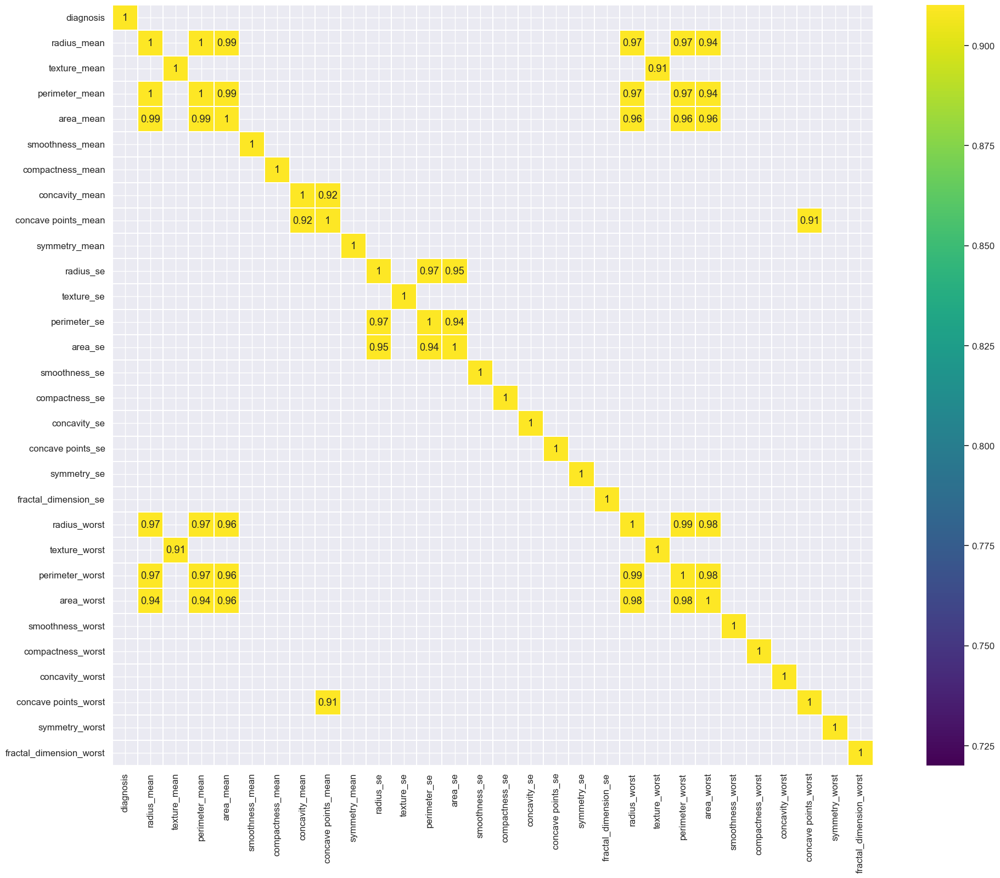

In [30]:
correlationMatrix=df_Cancergeometry[["diagnosis","radius_mean","texture_mean","perimeter_mean","area_mean","smoothness_mean","compactness_mean",
                 "concavity_mean","concave points_mean","symmetry_mean","radius_se","texture_se",
                 "perimeter_se","area_se","smoothness_se","compactness_se","concavity_se","concave points_se","symmetry_se",
                 "fractal_dimension_se","radius_worst","texture_worst","perimeter_worst","area_worst","smoothness_worst",
                 "compactness_worst","concavity_worst","concave points_worst","symmetry_worst","fractal_dimension_worst"]].corr()
high_correlationMatrix = correlationMatrix[correlationMatrix>0.9]
sns.set(font_scale=1.10)
plt.figure(figsize=(25, 18))
sns.heatmap(high_correlationMatrix, vmax=.8, linewidths=0.01,square=True,annot=True,cmap='viridis',linecolor="white")
plt.show()

### Question 1 - Conclusive Statement : As the question is mentioning to follow only descriptive statistical approach and plots to come to a conclusion, we can mention below conclusive statement for our analysis,

#### We are considering all the features including standard error and worst value column for our analysis.

#### Conclusive Statement 1 : Looking at the descriptive stats it is evident that if we are considering all features then fractal_dimension_mean, texture_se, smoothness_se, symmetry_se features has higher value for benign case compared to malignant.


##### Conclusive Statement 1.1 :  Effective size greater than 1 for any feature depicts two groups of tumor type has very different value for that particular feature, but now we have to check whether those features can be used for make conclusive statement or not. Those features are, radius_mean,perimeter_mean,area_mean,compactness_mean,concavity_mean,concave points_mean, radius_se, perimeter_se,area_se,radius_worst, texture_worst,area_worst,compactness_worst,concavity_worst,concave points_worst.


##### Conclusive Statement 1.2 : The violin plot is very efficient in comparing distributions of different variables. I can see below observation from the violin plot and histplot,
###### 1.2.1. mean radius, mean area, mean concave points, worst radius, worst perimeter, worst area, worst concave points are the good feature for classification problem because of their overlapping nature, though we have to verify the correlation behavior.
###### 1.2.2. For few feature the distribution looks very similar like mean smoothness, mean symmetry, mean fractual dimension, smoothness error, overlapping percentage will give clear picture for the same.
###### 1.2.3. Due to same distribution few feature definitely have high correlation too so we have to check the correlation for them also like mean perimeter vs. mean area, mean concavity vs. mean concave points, and worst symmetry vs. worst fractal dimension. According to PCA this is not required to keep highly correlated feature all together for model building which will leads to dimensionality curse problem. so only single feature can be considered as significant.


#### Conclusive Statement 2 : Overlapping percentage is 100% for feature like smoothness_mean, texture_se(cant be consider as it has very low negative correlation), concavity_se, concave points_se, fractal_dimension_se, concavity_worst. hence these features can not be used for arriving any conclusion on tumor type as there is no unique region identified for benign and malignant tumor.


#### Conclusive Statement 3 : Tumor type is highly correlated with radius_mean, perimeter_mean, area_mean, concavity_mean, concave points_mean, radius_worst, perimeter_worst, area_worst, concavity_worst(cant be consider as overlapping percentage is 100% so not conclusive), concave points_worst features.


#### Conclusive Statement 4 : fractal_dimension_mean, smoothness_se, symmetry_se features has very insignificant correlation with the type of tumor, so before concluding on rejecting these features we have to check whether this feature has any significant correlation with other feature.


#### Conclusive Statement 5 : fractal_dimension_mean, smoothness_se, symmetry_se features does not have any significant correlation with other features too, hence we can say that this features can not be used as a conclusive feature in identifying the tumor type.


#### Conclusive Statement 6:  radius is highly correlated with perimeter, area, concavity, concave point,so any one of the feature can be used for further prediction as per principle component analysis concept.

### Correlation coefficient of significant feature with target disgnosis feature: 

##### 1.	concave points_worst	 0.793566	
##### 2.	perimeter_worst	              0.782914	
##### 3.	concave points_mean      0.776614	
##### 4.	radius_worst	                 0.776454	
##### 5.	perimeter_mean	              0.742636	
##### 6.	area_worst	                       0.733825	
##### 7.	radius_mean	                     0.730029	
##### 8.	area_mean	                       0.708984	
##### 9.	concavity_mean	               0.69636	
##### 10.	concavity_worst	               0.65961	
##### 11.	compactness_mean	      0.596534	
##### 12.	compactness_worst	       0.590998	

### Final Conclusion : As per final conclusion, I am considering the high correlation between Diagnosis (Target variable) column and spread or variance overlapping percentage along with effect size analysis. Considering these factors we can say that below top 10 features are contributing significantly towards the identification of the tumor type,
#### 1. concave points_worst
#### 2. perimeter_worst
#### 3. concave points_mean
#### 4. radius_worst
#### 5. perimeter_mean
#### 6. area_worst
#### 7. radius_mean
#### 8. area_mean
#### 9. compactness_mean
#### 10. compactness_worst

#### Lastly concavity feature like mean and worst value are highly correlated with tumor type but due to high overlapping percentage I am not considering this feature in top 10 most significant feature list.

### Now, the team can use either radius or perimeter or area or concave points (As they are highly correlated with each other and play significant role in identifying tumor type) along with compactness feature as a significant geometrical aspects of the tumor which allow them to distinguish benign and malignant tumors in the future.



### Question 2

#### Q2 The data on the outbreaks have been collected by the Indian authority. The data set ”Outbreak India.csv” consists of different districts, states, diseases/Illnesses, no of cases, no of deaths, etc. information. Create the following plots for the data sets 
#### • Scattered plot and pie charts
#### • Word clouds of different outbreaks in different districts
#### • Geo-spatial plots for top 10 outbreaks in the assigned ”state”.
#### • For the assigned ”outbreak”, the geospatial plot for different states.
#### • Perform descriptive statistical analysis for the occurrence of the top 10 outbreaks in the assigned "states" and plot the ”death/# of the case” ratio in geospatial plots for the assigned states for each district.
#### Note: You might have to explore and install the packages wordcloud and geoplotlib to be able to create the appropriate plots. Feel free to contact us if you have any doubts.

In [31]:
#Import library 
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import os
from wordcloud import WordCloud, STOPWORDS
import geopandas as geopnda

#### Common Function

In [32]:
#Common reusable function

def dataframe_title(x):
    return x.title()

def remove_linebreak(x):
    return ' '.join(x.splitlines())

def remove_consecutive_space(x):
    return re.sub(' +', ' ', x)

def remove_bracket_inside_text(x):
    return re.sub("\(.*?\)","()",x).strip("[]{}()")

def remove_preeceding_zero(x):
    return x.lstrip('0')

def replace_special_char_and_string_with_space(x):
    intermediate_val = re.sub(r'[^0-9 ]','',x).strip()
    return intermediate_val.split(' ')[0]
        

#### Loading the India outbreak data

In [33]:
#Change the working directory 
os.chdir(OutbreakPath)
#Load the data set 
df_OutbreakIndia = pd.read_csv(OutbreakFileName)
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,? Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,madhya \n Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever with Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles \n & \n Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."
17650,17651.0,Nagaland,Zunheboto,Chickenpox,5,0,17-06-2019,18-06-2019,Under Surveillance,"Cases reported from Village Old Town Colony, Z..."
17651,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##### Display number of column in data set 

In [34]:
print(df_OutbreakIndia.columns)

Index(['Serial no', 'Name of State/UT', 'Name of District', 'Disease/Illness',
       'No. of Cases', 'No. of Deaths', 'Date of start of outbreak',
       'Date Reported', 'Current Status', 'Comments'],
      dtype='object')


#### Get the descriptive statistical value for outbreak data 

In [35]:
include =['object', 'float', 'int']
df_OutbreakIndia.describe(include=include)

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,17651.000000,17652,17651,17652,17649,17652,17652,17652,17649,17643
unique,NaN,39,1477,205,541,81,3717,3379,76,17612
top,NaN,Karnataka,Tumkur,Acute Diarrhoeal Disease,12,0,03-02-2016,Reported late,Under Control,missing
freq,NaN,1843,248,4562,670,15165,22,5613,5075,8
mean,8826.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,5095.549136,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,4413.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,8826.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,13238.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


###### Keep the data outbreak data as a copy

In [36]:
df_OutbreakIndia_copy = df_OutbreakIndia

#### Exploratory data analysis on outbreak data

#### Null and NA value check in the given dataset

In [37]:
df_OutbreakIndia.isna().sum().sort_values(ascending=False)

Comments                     10
No. of Cases                  4
Current Status                4
Serial no                     2
Name of District              2
Name of State/UT              1
Disease/Illness               1
No. of Deaths                 1
Date of start of outbreak     1
Date Reported                 1
dtype: int64

#### Dropping NA value from the data set

In [38]:
df_OutbreakIndia.dropna(axis = 0, inplace=True)

#### Reverify the given dataset for null and na value 

In [39]:
df_OutbreakIndia.isna().sum().sort_values(ascending=False)

Serial no                    0
Name of State/UT             0
Name of District             0
Disease/Illness              0
No. of Cases                 0
No. of Deaths                0
Date of start of outbreak    0
Date Reported                0
Current Status               0
Comments                     0
dtype: int64

#### Outbreak data does not have any NA or null value

In [40]:
df_OutbreakIndia
#New dataset have 17636 records

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,? Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,madhya \n Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever with Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles \n & \n Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


### Serial No.

#### Verifying Serial No. field in data set

In [41]:
df_OutbreakIndia.info()
np.unique(df_OutbreakIndia['Serial no'])

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17636 entries, 0 to 17650
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Serial no                  17636 non-null  float64
 1   Name of State/UT           17636 non-null  object 
 2   Name of District           17636 non-null  object 
 3   Disease/Illness            17636 non-null  object 
 4   No. of Cases               17636 non-null  object 
 5   No. of Deaths              17636 non-null  object 
 6   Date of start of outbreak  17636 non-null  object 
 7   Date Reported              17636 non-null  object 
 8   Current Status             17636 non-null  object 
 9   Comments                   17636 non-null  object 
dtypes: float64(1), object(9)
memory usage: 1.5+ MB


array([1.0000e+00, 2.0000e+00, 3.0000e+00, ..., 1.7649e+04, 1.7650e+04,
       1.7651e+04])

##### Serial numbers are containing only the floating value no further cleaning is required, it will be further clean with other column cleaning process

### Name of State/UT

#### Cleaning the Name of State/UT

In [42]:
np.unique(df_OutbreakIndia['Name of State/UT'])
#One state value is duplicate with non capitalize format (ex. madhya Pradesh)

array(['Andaman & \n Nicobar \n Islands', 'Andhra Pradesh',
       'Arunachal Pradesh', 'Assam', 'Bihar', 'Chandigarh',
       'Chhattisgarh', 'Dadar & \n Nagar Haveli', 'Daman & \n Diu',
       'Delhi', 'Goa', 'Gujarat', 'Haryana', 'Himachal \n Pradesh',
       'Jammu & \n Kashmir', 'Jharkhand', 'Karnataka', 'Kerala',
       'Lakshadweep', 'M\n anipur', 'Madhya \n Pradesh', 'Maharashtra',
       'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland',
       'Name of \n State/UT', 'Orissa', 'Puducherry', 'Punjab',
       'Rajasthan', 'Sikkim', 'Tamil Nadu', 'Telangana', 'Tripura',
       'Uttar \n Pradesh', 'Uttarakhand', 'West Bengal',
       'madhya \n Pradesh'], dtype=object)

#### Perform below operation:
##### 1. Make all the value of Name of State as Title
##### 2. Remove the line break in the Name of State
##### 3. Remove consecutive space from Name of State

In [43]:
#Make all the value of Name of State as Title
df_OutbreakIndia['Name of State/UT'] = df_OutbreakIndia['Name of State/UT'].apply(dataframe_title)
#Remove the line break in the Name of State
df_OutbreakIndia['Name of State/UT'] = df_OutbreakIndia['Name of State/UT'].apply(remove_linebreak)
#Remove consecutive space from Name of State
df_OutbreakIndia['Name of State/UT'] = df_OutbreakIndia['Name of State/UT'].apply(remove_consecutive_space)

##### Fix the issue with M Anipur

In [44]:
#Fix the issue with M Anipur
df_OutbreakIndia['Name of State/UT'] = np.where((df_OutbreakIndia['Name of State/UT'] == 'M Anipur'), 'Manipur', df_OutbreakIndia['Name of State/UT'])

In [45]:
np.unique(df_OutbreakIndia['Name of State/UT'])

array(['Andaman & Nicobar Islands', 'Andhra Pradesh', 'Arunachal Pradesh',
       'Assam', 'Bihar', 'Chandigarh', 'Chhattisgarh',
       'Dadar & Nagar Haveli', 'Daman & Diu', 'Delhi', 'Goa', 'Gujarat',
       'Haryana', 'Himachal Pradesh', 'Jammu & Kashmir', 'Jharkhand',
       'Karnataka', 'Kerala', 'Lakshadweep', 'Madhya Pradesh',
       'Maharashtra', 'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland',
       'Name Of State/Ut', 'Orissa', 'Puducherry', 'Punjab', 'Rajasthan',
       'Sikkim', 'Tamil Nadu', 'Telangana', 'Tripura', 'Uttar Pradesh',
       'Uttarakhand', 'West Bengal'], dtype=object)

In [46]:
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,? Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever with Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles \n & \n Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


#### Remove row containing unrelated junk data 

In [47]:
df_OutbreakIndia[df_OutbreakIndia['Name of State/UT'] == 'Name Of State/Ut']

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
11212,11213.0,Name Of State/Ut,Name of \n District,Name of Disease,No. of cases,No. of Deaths,Date of \n start of \n outbreak \n /EWS,Date of \n reporting,Current Status,Comments/ Action taken


###### Serial number 11213 is junk, so removing it - index value is 11212

In [48]:
df_OutbreakIndia.drop(11212, inplace=True)

In [49]:
df_OutbreakIndia[df_OutbreakIndia['Name of State/UT'] == 'Name Of State/Ut']

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments


#### Junk data is removed from the dataset

### Name of District

#### Cleaning the Name of District

In [50]:
#Remove the special character from name of district
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].str.replace('^[^A-Za-z0-9]|[^A-Za-z0-9]$', '', regex=True)

In [51]:
np.unique(df_OutbreakIndia['Name of District'])

array([' Shimoga', '09 Districts', '10 Districts', ..., 'Yavatma',
       'Yavatmal', 'Zunheboto'], dtype=object)

#### Perform below operation:
##### 1. Remove the line break in the Name of District
##### 2. Remove consecutive space from Name of District

In [52]:
#Remove the line break in the Name of District
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].apply(remove_linebreak)
#Remove consecutive space from Name of District
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].apply(remove_consecutive_space)

In [53]:
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever with Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles \n & \n Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


#### Clean the district of Meghalaya

In [54]:
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("RI- Bhoi (Nongpoh", 'Ri-Bhoi(Nongpoh)')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Ri Bhoi", 'Ri Bhoi')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Ribhoi", 'Ri Bhoi')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Ri-Bhoi", 'Ri Bhoi')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Ribhoi (Nongpoh", 'Ri Bhoi')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("RI-Bhoi (Nongpoh", 'Ri Bhoi')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Ri-Bhoi(Nongpoh)", 'Ri Bhoi')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("West Garo Hill", 'West Garo Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Jaintia hills", 'Jaintia Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Jaintia hills", 'Jaintia Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("Jantia Hills", 'Jaintia Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("West Jaintia Hills", 'Jaintia Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("West Jaintiahills", 'Jaintia Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("East Jaintia Hills", 'Jaintia Hills')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("West Khasi Hills (Nongstoin", 'West Khasi Hills (Nongstoin)')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace("West Khasi Hills (Nongstion", 'West Khasi Hills (Nongstoin)')
df_OutbreakIndia['Name of District'] = df_OutbreakIndia['Name of District'].replace('West Khasi Hills (Nongstoin)','West Khasi Hills')

### Disease/Illness

#### Cleaning the Disease/Illness

In [55]:
np.unique(df_OutbreakIndia['Disease/Illness'])

array(['ARI (H3N2)', 'Acute \n Encephaliti\n s Syndrome',
       'Acute \n Flaccid \n Paralysis', 'Acute \n Meningitis',
       'Acute \n Respiratory \n Illness',
       'Acute \n Respiratory \n Infection', 'Acute Diarrhoeal Disease',
       'Acute Encephalitis \n Syndrome', 'Acute Febrile \n Illness',
       'Acute Febrile Illness', 'Acute Febrile Illness Malaria',
       'Acute Flaccid \n Paralysis', 'Acute Gastro Enteritis',
       'Acute Jatropha curcas (Ratanjot)', 'Acute Respiratory Illness',
       'Acute Viral \n Hepatitis', 'Acute Viral \n Hepatitis E',
       'Acute Viral Conjunctivitis', 'Acute Viral Encephalitis',
       'Acute Viral Fever', 'Acute fever', 'Alcohol \n Poisoning',
       'Amoebic \n Dysentry', 'Anthrax', 'Bacillary \n Dysentery',
       'Brucellosis', 'CHPV', 'Castor Seed Poisoning', 'Chamoli',
       'Chandipura Viral Encephalitis', 'Chickenpox', 'Chikunguny\n a',
       'Cholera', 'Crimean \n Congo \n Haemorrhagic \n Fever',
       'Crimean \n Congo \n Hae

#### Perform below operation:
##### 1. Make all the value of Disease/Illness as Title
##### 2. Remove the line break in the Disease/Illness
##### 3. Remove consecutive space from Disease/Illness

In [56]:
#Make all the value of Disease/Illness as Title
df_OutbreakIndia['Disease/Illness'] = df_OutbreakIndia['Disease/Illness'].apply(dataframe_title)
#Remove the line break in the Disease/Illness
df_OutbreakIndia['Disease/Illness'] = df_OutbreakIndia['Disease/Illness'].apply(remove_linebreak)
#Remove consecutive space from Disease/Illness
df_OutbreakIndia['Disease/Illness'] = df_OutbreakIndia['Disease/Illness'].apply(remove_consecutive_space)

In [57]:
np.unique(df_OutbreakIndia['Disease/Illness'])

array(['Acute Diarrhoeal Disease', 'Acute Encephaliti S Syndrome',
       'Acute Encephalitis Syndrome', 'Acute Febrile Illness',
       'Acute Febrile Illness Malaria', 'Acute Fever',
       'Acute Flaccid Paralysis', 'Acute Gastro Enteritis',
       'Acute Jatropha Curcas (Ratanjot)', 'Acute Meningitis',
       'Acute Respiratory Illness', 'Acute Respiratory Infection',
       'Acute Viral Conjunctivitis', 'Acute Viral Encephalitis',
       'Acute Viral Fever', 'Acute Viral Hepatitis',
       'Acute Viral Hepatitis E', 'Alcohol Poisoning', 'Amoebic Dysentry',
       'Anthrax', 'Ari (H3N2)', 'Bacillary Dysentery', 'Brucellosis',
       'Castor Seed Poisoning', 'Chamoli',
       'Chandipura Viral Encephalitis', 'Chickenpox', 'Chikunguny A',
       'Cholera', 'Chpv', 'Crimean Congo Haemorrhagic Fever',
       'Cutaneous Anthrax', 'Dengue', 'Dengue & Chikungunya',
       'Dengue & Je', 'Dengue & Leptospirosis', 'Dengue Fever',
       'Diarrhea', 'Diarrheal', 'Diarrhoea', 'Diphtheria', 'D

In [58]:
#df_OutbreakIndia[df_OutbreakIndia['Disease/Illness'] == 'Disease'] # 1 record
#df_OutbreakIndia[df_OutbreakIndia['Disease/Illness'] == 'Poisoning'] # 1 record
#df_OutbreakIndia[df_OutbreakIndia['Disease/Illness'] == 'Viral'] # 3 records

##### There are 5 records are present in the data which really does not play any further role as the Diseases/Illness column not containing any specific significant disease name. So either we can remove those details or keep as is but not use in further operation. I have taken the next option for this exercise and kept those values but not used in analysis.

#### Perform below operation:
##### 1. Cleaning the diseases name based on domain knowledge
##### 2. Cleaning place name in disease column 

In [59]:
#Cleaning the diseases name based on domain knowledge
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Acute Encephaliti S Syndrome", 'Acute Encephalitis Syndrome')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Acute Diarrhoeal Disease", 'Acute Diarrhea Disease')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("F Ood Poisoning", 'Food Poisoning')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Food Poisioning", 'Food Poisoning')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Leptospiro Sis", 'Leptospirosis')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Pertusis", 'Pertussis')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Rubell A", 'Rubella')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Rubell A & Measles", 'Rubella & Measles')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Seasonal Influenza A(H1N1)", 'Seasonal Influenza (H1N1)')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Trichinell A", 'Trichinella')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Chikunguny A", 'Chikungunya')


#Cleaning place name in disease column 
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Purulia", '')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("South 24 Parganas", '')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("South Goa", '')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("South West", '')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Chamoli", '')
df_OutbreakIndia['Disease/Illness']  = df_OutbreakIndia['Disease/Illness'].replace("Nadia", '')

#### Verifying the changes done in the disease data 

In [60]:
np.unique(df_OutbreakIndia['Disease/Illness'])

array(['', 'Acute Diarrhea Disease', 'Acute Encephalitis Syndrome',
       'Acute Febrile Illness', 'Acute Febrile Illness Malaria',
       'Acute Fever', 'Acute Flaccid Paralysis', 'Acute Gastro Enteritis',
       'Acute Jatropha Curcas (Ratanjot)', 'Acute Meningitis',
       'Acute Respiratory Illness', 'Acute Respiratory Infection',
       'Acute Viral Conjunctivitis', 'Acute Viral Encephalitis',
       'Acute Viral Fever', 'Acute Viral Hepatitis',
       'Acute Viral Hepatitis E', 'Alcohol Poisoning', 'Amoebic Dysentry',
       'Anthrax', 'Ari (H3N2)', 'Bacillary Dysentery', 'Brucellosis',
       'Castor Seed Poisoning', 'Chandipura Viral Encephalitis',
       'Chickenpox', 'Chikungunya', 'Cholera', 'Chpv',
       'Crimean Congo Haemorrhagic Fever', 'Cutaneous Anthrax', 'Dengue',
       'Dengue & Chikungunya', 'Dengue & Je', 'Dengue & Leptospirosis',
       'Dengue Fever', 'Diarrhea', 'Diarrheal', 'Diarrhoea', 'Diphtheria',
       'Disease', 'Dog Bite', 'Drug Side Effects', 'Dvd', 

###### index name of the diseases column which contains empty space which is replaced from location name

In [61]:
#index name of the diseases column which contains empty space which is replaced from location name
index_names_blank_Disease = df_OutbreakIndia[df_OutbreakIndia['Disease/Illness'] == '' ].index
index_names_blank_Disease

Int64Index([3024, 10796, 12939, 15041, 15106, 15123], dtype='int64')

###### Remove the blank diseases row

In [62]:
#Remove the blank diseases row
df_OutbreakIndia.drop(index_names_blank_Disease, inplace = True)

In [63]:
np.unique(df_OutbreakIndia['Disease/Illness'])

array(['Acute Diarrhea Disease', 'Acute Encephalitis Syndrome',
       'Acute Febrile Illness', 'Acute Febrile Illness Malaria',
       'Acute Fever', 'Acute Flaccid Paralysis', 'Acute Gastro Enteritis',
       'Acute Jatropha Curcas (Ratanjot)', 'Acute Meningitis',
       'Acute Respiratory Illness', 'Acute Respiratory Infection',
       'Acute Viral Conjunctivitis', 'Acute Viral Encephalitis',
       'Acute Viral Fever', 'Acute Viral Hepatitis',
       'Acute Viral Hepatitis E', 'Alcohol Poisoning', 'Amoebic Dysentry',
       'Anthrax', 'Ari (H3N2)', 'Bacillary Dysentery', 'Brucellosis',
       'Castor Seed Poisoning', 'Chandipura Viral Encephalitis',
       'Chickenpox', 'Chikungunya', 'Cholera', 'Chpv',
       'Crimean Congo Haemorrhagic Fever', 'Cutaneous Anthrax', 'Dengue',
       'Dengue & Chikungunya', 'Dengue & Je', 'Dengue & Leptospirosis',
       'Dengue Fever', 'Diarrhea', 'Diarrheal', 'Diarrhoea', 'Diphtheria',
       'Disease', 'Dog Bite', 'Drug Side Effects', 'Dvd', 'Dys

#### No blank diseases are left and now diseases/illness column is cleaner compared to initial data

### No. of Cases

#### Cleaning of No. of Cases

In [64]:
np.unique(df_OutbreakIndia['No. of Cases'])

array(['*6', '---', '-----', '-------', '----------', '0', '04*',
       '07\n (confi rmed Deng ue)', '1', '10',
       '10 (only \n lab \n confirme\n d)', '100',
       '100 \n (14 \n were \n lab \n confirm\n ed)', '101', '102', '103',
       '104', '105', '1053', '106', '107',
       '107 \n (lab \n confir\n med \n cases )', '108', '109',
       '109 \n (cases \n upto \n 12/10/\n 12)', '11', '110',
       '110 (cases \n upto \n 22/06/12)', '1100', '111',
       '111 \n ( cases \n from 6th \n March \n to 22nd \n May, \n 13)',
       '112', '1123', '1127', '113', '114', '115', '115 \n Disease',
       '116', '117', '118', '119', '12', '12 ( \n lab \n confir\n med)',
       '120', '1200', '121', '122', '123', '124',
       '124 \n (Cases \n reported \n from \n Muzaffa\n rpur)', '125',
       '1251', '126', '126 \n cases \n (18 lab \n confirn\n ed \n cases)',
       '127', '128', '129', '129 \n (6 lab \n confir\n med \n cases)',
       '1292', '13', '13 (6 \n confir\n med)', '130',
     

#### Perform below operation:
##### 1. Remove the line break in the No. of Cases
##### 2. Remove consecutive space from No. of Cases

In [65]:
#Remove the line break in the No. of Cases
df_OutbreakIndia['No. of Cases'] = df_OutbreakIndia['No. of Cases'].apply(remove_linebreak)
#Remove consecutive space from No. of Cases
df_OutbreakIndia['No. of Cases'] = df_OutbreakIndia['No. of Cases'].apply(remove_consecutive_space)

#### Perform below operation:
##### 1. Remove text inside the bracket including bracket
##### 2. Remove preceding zeros from a number
##### 3. Remove special character and string from the no of cases 

In [66]:
#Remove text inside the bracket including bracket
df_OutbreakIndia['No. of Cases'] = df_OutbreakIndia['No. of Cases'].apply(remove_bracket_inside_text)
#Remove preeceding zeros from a number
df_OutbreakIndia['No. of Cases'] = df_OutbreakIndia['No. of Cases'].apply(remove_preeceding_zero)
#Remove special character and string from the no of cases 
df_OutbreakIndia['No. of Cases'] = df_OutbreakIndia['No. of Cases'].apply(replace_special_char_and_string_with_space)

#### Perform below operation:
##### 1. Find the index of row containing '' as No of Cases

In [67]:
#Find the index of row containing '' as No of Cases
index_names = df_OutbreakIndia[df_OutbreakIndia['No. of Cases'] == '' ].index
index_names

Int64Index([453, 456, 2756, 9054, 9532, 12997, 14655], dtype='int64')

#### Perform below operation:
##### 1. Drop the row containing space in no of cases

In [68]:
#Drop the row containing space in no of cases
df_OutbreakIndia.drop(index_names, inplace = True)

In [69]:
np.unique(df_OutbreakIndia['No. of Cases'])

array(['1', '10', '100', '101', '102', '103', '104', '105', '1053', '106',
       '107', '108', '109', '11', '110', '1100', '111', '112', '1123',
       '1127', '113', '114', '115', '116', '117', '118', '119', '12',
       '120', '1200', '121', '122', '123', '124', '125', '1251', '126',
       '127', '128', '129', '1292', '13', '130', '1305', '131', '132',
       '133', '134', '1345', '135', '1350', '136', '137', '138', '1388',
       '139', '14', '140', '141', '142', '1422', '143', '1430', '144',
       '145', '146', '147', '148', '149', '1496', '15', '150', '151',
       '152', '153', '154', '155', '156', '157', '158', '159', '16',
       '160', '161', '1614', '162', '163', '1634', '164', '165', '166',
       '1665', '167', '168', '169', '17', '170', '171', '172', '173',
       '174', '1748', '175', '176', '177', '178', '179', '18', '180',
       '181', '182', '183', '184', '185', '186', '188', '189', '19',
       '190', '191', '192', '193', '194', '195', '196', '198', '199', '2',
  

In [70]:
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever With Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles & Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


### No. of Deaths

#### Cleaning of No. of Deaths

In [71]:
np.unique(df_OutbreakIndia['No. of Deaths'])

array(['-1', '0', '0 #', '01\n (5yrs/', '01\n (Se x/A ge)', '01 (10/F)',
       '01 (11/M)', '01 (14/F)', '01 (28/F)', '01 (40/M)', '01 (55/M)',
       '01 (6/M)', '01 (70/F)', '01 (75/F)', '01(14/ M)', '01(18/ M)',
       '01(65/ F)', '01(8/M)', '01(9M\n /M)', '1',
       '1 \n (Death\n s \n reporte\n d from \n 02/04/\n 12 to \n 15/04/\n 12)',
       '1 (31M)', '1(9\n month)', '1(M/1\n 5)', '10', '11', '12', '121',
       '13', '15', '153', '16', '17', '177', '18',
       '18 \n (deaths \n upto \n 16/10/\n 12)', '19', '2',
       '2 \n ( from \n 4 Jan -\n 1st \n June \n 2012)',
       '2 (1 lab \n confirm\n ed)', '20', '22', '23', '24', '25', '28',
       '29', '3', '3 \n (deaths \n upto \n 28/07/\n 12)', '3*',
       '32 \n (Deaths \n reported \n from \n Muzaffa\n rpur)', '327*',
       '38 \n (deaths \n till \n 17/12/\n 12)',
       '39 \n (deaths \n upto \n 22/06/1\n 2)', '39*', '4',
       '4 \n (death\n s upto \n 19/9/1\n 2)', '42', '45', '459*', '5',
       '5 (2 \n confir\n med

#### Perform below operation:
##### 1. Remove the line break in the No. of Deaths
##### 2. Remove consecutive space from No. of Deaths

In [72]:
#Remove the line break in the No. of Deaths
df_OutbreakIndia['No. of Deaths'] = df_OutbreakIndia['No. of Deaths'].apply(remove_linebreak)
#Remove consecutive space from No. of Deaths
df_OutbreakIndia['No. of Deaths'] = df_OutbreakIndia['No. of Deaths'].apply(remove_consecutive_space)

#### Perform below operation:
##### 1. Remove text inside the bracket including bracket
##### 2. Remove preceding zeros from a number
##### 3. Remove special character and string from the no of Deaths 

In [73]:
#Remove text inside the bracket including bracket
df_OutbreakIndia['No. of Deaths'] = df_OutbreakIndia['No. of Deaths'].apply(remove_bracket_inside_text)
#Remove preeceding zeros from a number
df_OutbreakIndia['No. of Deaths'] = df_OutbreakIndia['No. of Deaths'].apply(remove_preeceding_zero)
#Remove special character and string from the no of Deaths 
df_OutbreakIndia['No. of Deaths'] = df_OutbreakIndia['No. of Deaths'].apply(replace_special_char_and_string_with_space)

#### Perform below operation:
##### 1. Replace blank value in no of death column with zeros

In [74]:
#Replace blank value in no of death column with zeros
df_OutbreakIndia['No. of Deaths'] = df_OutbreakIndia['No. of Deaths'].replace("", 0)
df_OutbreakIndia['No. of Deaths'].value_counts()

0      15147
1       1598
2        475
3        169
4         74
5         43
7         22
6         20
8         12
9         10
10         9
15         4
18         4
12         3
11         3
23         2
39         2
16         2
24         2
19         2
13         1
85         1
22         1
121        1
45         1
153        1
32         1
28         1
177        1
25         1
550        1
38         1
29         1
459        1
42         1
55         1
20         1
327        1
17         1
Name: No. of Deaths, dtype: int64

##### Find the index of row containing '' as No of Deaths

In [75]:
#Find the index of row containing '' as No of Deaths
df_OutbreakIndia[df_OutbreakIndia['No. of Deaths'] == 0]

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
5,6.0,West Bengal,24North Parganas,Acute Diarrhea Disease,76,0,13-07-2011,20-07-2011,Under \n control,"Outbreak \n reported \n from Padrihata, RBC Rd..."
...,...,...,...,...,...,...,...,...,...,...
17645,17646.0,Maharashtra,Yavatmal,Food Poisoning,24,0,20-10-2018,23-10-2018,Under Control,"Cases reported from Village Rohtek, SC Waki Du..."
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever With Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles & Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


In [76]:
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever With Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles & Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


### Date Reported

#### Cleaning of Date Reported

In [77]:
np.unique(df_OutbreakIndia['Date Reported'])

array(['#VALUE!', '00-01-00', '01-01-2010', ..., '??', 'Not Given',
       'Reported late'], dtype=object)

In [78]:
df_OutbreakIndia['Date Reported']

0        Reported late
1        Reported late
2        Reported late
3        Reported late
4           01-05-2018
             ...      
17646    Reported late
17647    Reported late
17648       08-01-2017
17649    Reported late
17650       18-06-2019
Name: Date Reported, Length: 17622, dtype: object

##### Find the index of row containing some unsupported Date Reported value to clean it

In [79]:
#Find the index of row containing some unsupported Date Reported value to clean it
index_names_number_Value = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '#VALUE!'].index
index_names_number_under = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == 'Under'].index
index_names_number_notaDate = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '00-01-00'].index
index_names_number_notaDate_23 = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '23/2/201'].index
index_names_number_notaDate_2122 = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '21/22'].index
index_names_number_notaDate_40695 = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '40695'].index
index_names_number_notaDate_questionmark = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '??'].index
index_names_number_notaDate_junk = df_OutbreakIndia[df_OutbreakIndia['Serial no'] == 11213].index

index_names_number_Value,index_names_number_under,index_names_number_notaDate,index_names_number_notaDate_23,index_names_number_notaDate_2122,index_names_number_notaDate_40695,index_names_number_notaDate_questionmark,index_names_number_notaDate_junk

(Int64Index([4266, 6932, 10890, 11184, 11185, 11874, 17004], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([2920], dtype='int64'),
 Int64Index([9550], dtype='int64'),
 Int64Index([14112], dtype='int64'),
 Int64Index([15442], dtype='int64'),
 Int64Index([3522], dtype='int64'),
 Int64Index([], dtype='int64'))

##### Drop the row containing above mentioned wrong value in Date Reported column

In [80]:
#Drop the row containing above mentioned worng value in Date Reported column
df_OutbreakIndia.drop(index_names_number_Value, inplace = True)
df_OutbreakIndia.drop(index_names_number_under, inplace = True)
df_OutbreakIndia.drop(index_names_number_notaDate, inplace = True)
df_OutbreakIndia.drop(index_names_number_notaDate_23, inplace = True)
df_OutbreakIndia.drop(index_names_number_notaDate_2122, inplace = True)
df_OutbreakIndia.drop(index_names_number_notaDate_40695, inplace = True)
df_OutbreakIndia.drop(index_names_number_notaDate_questionmark, inplace = True)
df_OutbreakIndia.drop(index_names_number_notaDate_junk, inplace = True)

In [81]:
#Verification
index_names_number_Value = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '#VALUE!'].index
index_names_number_under = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == 'Under'].index
index_names_number_notaDate = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '00-01-00'].index
index_names_number_notaDate_23 = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '23/2/201'].index
index_names_number_notaDate_2122 = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '21/22'].index
index_names_number_notaDate_40695 = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '40695'].index
index_names_number_notaDate_questionmark = df_OutbreakIndia[df_OutbreakIndia['Date Reported'] == '??'].index
index_names_number_notaDate_junk = df_OutbreakIndia[df_OutbreakIndia['Serial no'] == 11213].index

index_names_number_Value,index_names_number_under,index_names_number_notaDate,index_names_number_notaDate_23,index_names_number_notaDate_2122,index_names_number_notaDate_40695,index_names_number_notaDate_questionmark,index_names_number_notaDate_junk

(Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'),
 Int64Index([], dtype='int64'))

In [82]:
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under \n Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillanc e,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever With Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles & Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


### Current Status 

#### Cleaning of Current Status

In [83]:
np.unique(df_OutbreakIndia['Current Status'])

array(['. \n  \n Under \n Control', '26.05.10', '37606', '???',
       'Investigati\n on Open', 'Investigatio n close',
       'Investigatio n closed', 'Investigation \n Open',
       'Investigation Open', 'Investigation closed',
       'No new cases reported', 'Open', 'Situation \n under control',
       'U\n nder \n Surveillance', 'U\n nder \n control',
       'U\n nder \n surveillance', 'U\n nder Control', 'U\n nder control',
       'U nder control', 'Und er\n Surveillance', 'Unde \n r control',
       'Under', 'Under \n Conrol', 'Under \n Control',
       'Under \n Controlled', 'Under \n Investigation',
       'Under \n Observat\n ion', 'Under \n Observation',
       'Under \n Surveilla\n nce', 'Under \n Surveillan\n ce',
       'Under \n Surveillanc\n e', 'Under \n Surveillance',
       'Under \n closed', 'Under \n conrol', 'Under \n control',
       'Under \n control.', 'Under \n control`', 'Under \n observation',
       'Under \n sureillan\n ce', 'Under \n surveill\n ance',
    

#### Perform below operation:
##### 1. Make all the value of Current Status as Title
##### 2. Remove the line break in the Current Status
##### 3. Remove consecutive space from Current Status
##### 4. Remove text inside the bracket including bracket

In [84]:
#Make all the value of Current Status as Title
df_OutbreakIndia['Current Status'] = df_OutbreakIndia['Current Status'].apply(dataframe_title)
#Remove the line break in the Current Status
df_OutbreakIndia['Current Status'] = df_OutbreakIndia['Current Status'].apply(remove_linebreak)
#Remove consecutive space from Current Status
df_OutbreakIndia['Current Status'] = df_OutbreakIndia['Current Status'].apply(remove_consecutive_space)
#Remove text inside the bracket including bracket
df_OutbreakIndia['Current Status'] = df_OutbreakIndia['Current Status'].apply(remove_bracket_inside_text)

In [85]:
np.unique(df_OutbreakIndia['Current Status'])

array(['. Under Control', '26.05.10', '37606', '???',
       'Investigati On Open', 'Investigatio N Close',
       'Investigatio N Closed', 'Investigation Closed',
       'Investigation Open', 'No New Cases Reported', 'Open',
       'Situation Under Control', 'U Nder Control', 'U Nder Surveillance',
       'Und Er Surveillance', 'Unde R Control', 'Under', 'Under Closed',
       'Under Conrol', 'Under Control', 'Under Control & Surveillance',
       'Under Control Cases', 'Under Control.', 'Under Control`',
       'Under Controlled', 'Under Investigation', 'Under Observat Ion',
       'Under Observation', 'Under Sruveillance',
       'Under Strict Surveillance', 'Under Sureillan Ce',
       'Under Surveill Ance', 'Under Surveilla Nce',
       'Under Surveilla Nce.', 'Under Surveillan Ce',
       'Under Surveillanc E', 'Under Surveillance', 'Under Surveillance ',
       'Under Surveillance .', 'Under Surveillance.',
       'Under Survellan Ce', 'Uneder Surveillance', 'Unser Surveillance'

##### Fixing few specific cases in Current Status 

In [86]:
#Fixing few specific cases in Current Status 
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Investigati On Open", 'Investigation Open')

df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Investigatio N Close", 'Investigation Close')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Investigatio N Closed", 'Investigation Close')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Investigation Closed", 'Investigation Close')

df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("U Nder Control", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Unde R Control", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Conrol", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Control Cases", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Control.", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Control`", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Controlled", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("` Under Control", 'Under Control')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace(". Under Control", 'Under Control')

df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Observat Ion", 'Under Observation')

df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Sureillan Ce", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveill Ance", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveilla Nce", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveilla Nce.", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveillan Ce", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("U Nder Surveillance", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Und Er Surveillance", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveillanc E", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveillance ", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveillance .", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Surveillance.", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Survellan Ce", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Uneder Surveillance", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Unser Surveillance", 'Under Surveillance')
df_OutbreakIndia['Current Status']  = df_OutbreakIndia['Current Status'].replace("Under Sruveillance", 'Under Surveillance')



In [87]:
np.unique(df_OutbreakIndia['Current Status'])

array(['26.05.10', '37606', '???', 'Investigation Close',
       'Investigation Open', 'No New Cases Reported', 'Open',
       'Situation Under Control', 'Under', 'Under Closed',
       'Under Control', 'Under Control & Surveillance',
       'Under Investigation', 'Under Observation',
       'Under Strict Surveillance', 'Under Surveillance'], dtype=object)

##### Further cleaning of current status based on the unrealistic values 

In [88]:
#Find the index of row containing number and special character in Current Status
index_names_number_specialcharacter = df_OutbreakIndia[df_OutbreakIndia['Current Status'] == '26.05.10'].index
index_names_questionmark = df_OutbreakIndia[df_OutbreakIndia['Current Status'] == '???'].index
index_names_number = df_OutbreakIndia[df_OutbreakIndia['Current Status'] == '37606'].index
index_names_under = df_OutbreakIndia[df_OutbreakIndia['Current Status'] == 'Under'].index
index_names_number_specialcharacter,index_names_questionmark,index_names_number,index_names_under

(Int64Index([7033], dtype='int64'),
 Int64Index([15713], dtype='int64'),
 Int64Index([13256], dtype='int64'),
 Int64Index([3561, 6915, 7676, 9847, 10029, 10905, 12597, 12844, 14044, 14932,
             14999],
            dtype='int64'))

###### Dropping unrealistic values from current status 

In [89]:
#Drop the above mentioned rows
df_OutbreakIndia.drop(index_names_number_specialcharacter, inplace = True)
df_OutbreakIndia.drop(index_names_questionmark, inplace = True)
df_OutbreakIndia.drop(index_names_number, inplace = True)
df_OutbreakIndia.drop(index_names_under, inplace = True)

In [90]:
np.unique(df_OutbreakIndia['Current Status'])

array(['Investigation Close', 'Investigation Open',
       'No New Cases Reported', 'Open', 'Situation Under Control',
       'Under Closed', 'Under Control', 'Under Control & Surveillance',
       'Under Investigation', 'Under Observation',
       'Under Strict Surveillance', 'Under Surveillance'], dtype=object)

In [91]:
df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under Surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under Surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillance,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever With Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles & Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


#### Assign clean data to a new variable for further analysis

In [92]:
clean_df_OutbreakIndia = df_OutbreakIndia

#Change the data type of No. of cases and No. of Deaths into integer
clean_df_OutbreakIndia["No. of Cases"] = clean_df_OutbreakIndia["No. of Cases"].astype("int")
clean_df_OutbreakIndia["No. of Deaths"] = clean_df_OutbreakIndia["No. of Deaths"].astype("int")

print(f'Dimenstion of clean data {clean_df_OutbreakIndia.shape}')

Dimenstion of clean data (17596, 10)


In [93]:
#Verify the data type change
clean_df_OutbreakIndia.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17596 entries, 0 to 17650
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Serial no                  17596 non-null  float64
 1   Name of State/UT           17596 non-null  object 
 2   Name of District           17596 non-null  object 
 3   Disease/Illness            17596 non-null  object 
 4   No. of Cases               17596 non-null  int32  
 5   No. of Deaths              17596 non-null  int32  
 6   Date of start of outbreak  17596 non-null  object 
 7   Date Reported              17596 non-null  object 
 8   Current Status             17596 non-null  object 
 9   Comments                   17596 non-null  object 
dtypes: float64(1), int32(2), object(7)
memory usage: 1.3+ MB


In [94]:
clean_df_OutbreakIndia

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
0,1.0,Karnataka,Shimoga,Typhoid Fever,38,0,10-05-2014,Reported late,Under Control,Cases of fever reported from Surya Nursing Col...
1,2.0,Madhya Pradesh,09 Districts,Dengue,66,0,02-09-2015,Reported late,Under Surveillance,Cases of fever with headache and body ache wer...
2,3.0,Jharkhand,10 Districts,Japanease Encephalitis,180,2,18-04-2015,Reported late,Under Surveillance,"Cases of fever reported from Ranchi,East, Sing..."
3,4.0,Jharkhand,20 Districts,Dengue,169,0,21-07-2015,Reported late,Under Surveillance,Cases of fever with joint pain reported from R...
4,5.0,West Bengal,24 South Paragnas,Food Poisoning,65,0,30-04-2018,01-05-2018,Under Surveillance,Cases of vomiting with loose stools reported a...
...,...,...,...,...,...,...,...,...,...,...
17646,17647.0,Maharashtra,Yavatmal,Measles,6,0,01-11-2018,Reported late,Under Control,"Cases reported from Village Digras, PHC Harsul..."
17647,17648.0,Maharashtra,Yavatmal,Viral Fever,13,1,19-11-2018,Reported late,Under Control,"Cases reported from Village Loni, SC Sawanga, ..."
17648,17649.0,Andhra Pradesh,YSR Kadapa,Fever With Rash,22,0,03-01-2017,08-01-2017,Under Surveillance,"Cases reported from Village Kamasamudram, SC o..."
17649,17650.0,Nagaland,Zunheboto,Measles & Rubella,243,0,17-05-2015,Reported late,Under Surveillance,"Cases reported from Village Zunhebot, Block Sa..."


#### • Scattered plot and pie charts

In [95]:
#Pie Chart:
#1. No. of Cases against State, District, Disease
#2. No. of Deaths against State, District, Disease

colors = sns.color_palette('hls')[0:4]
colors = sns.color_palette('pastel')[0:5]

### No of cases Vs Name of State/UT

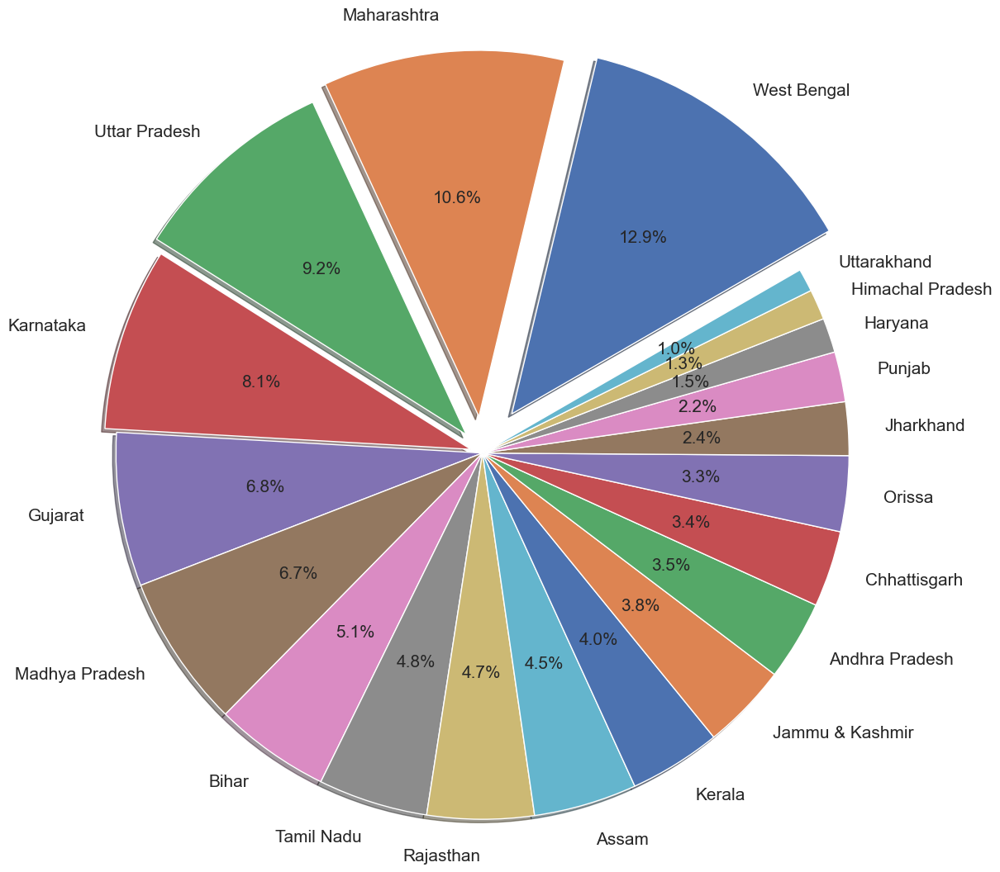

In [96]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Name of State/UT','No. of Cases']]
intermediate_data = intermediate_data.groupby('Name of State/UT').sum()
#As the record is too high so keeping all the record make the plot cumbersome, hence taking top 20 values for plotting
intermediate_sorted_data = pd.DataFrame(intermediate_data['No. of Cases'].sort_values(ascending=False)[:20])
explode = (0.4, 0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)
plt.pie(intermediate_sorted_data['No. of Cases'], labels = intermediate_sorted_data.index, autopct='%1.1f%%', radius=3,textprops={'fontsize': 15},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

### No of cases Vs Name of District

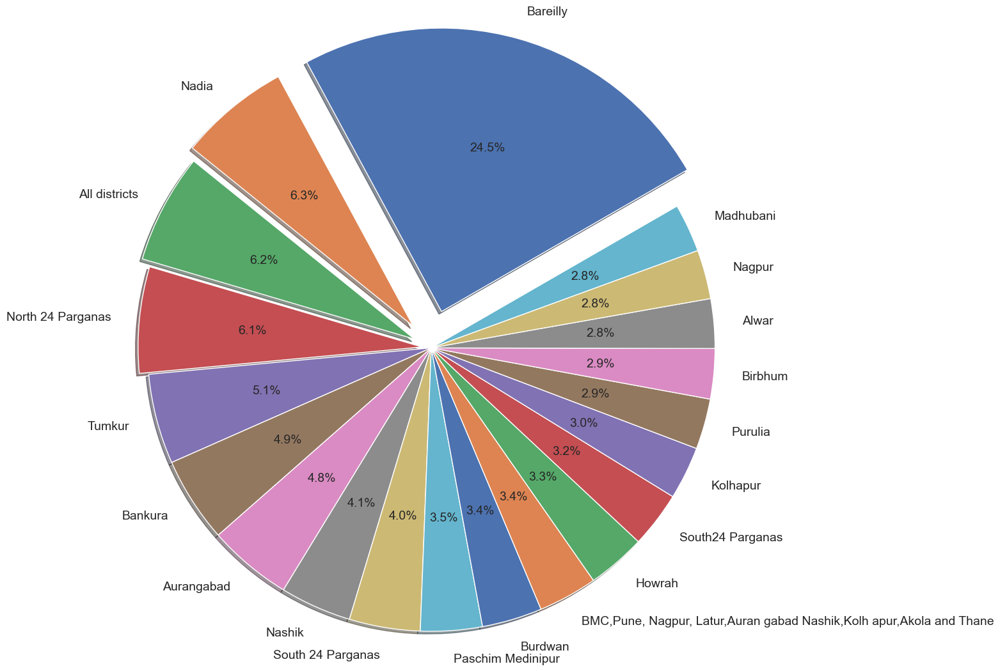

In [97]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Name of District','No. of Cases']]
intermediate_data = intermediate_data.groupby('Name of District').sum()
#As the record is too high so keeping all the record make the plot cumbersome, hence taking top 20 values for plotting
intermediate_sorted_data = pd.DataFrame(intermediate_data['No. of Cases'].sort_values(ascending=False)[:20])
explode = (0.4, 0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)
plt.pie(intermediate_sorted_data['No. of Cases'], labels = intermediate_sorted_data.index, autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

### No of cases Vs Disease/Illness

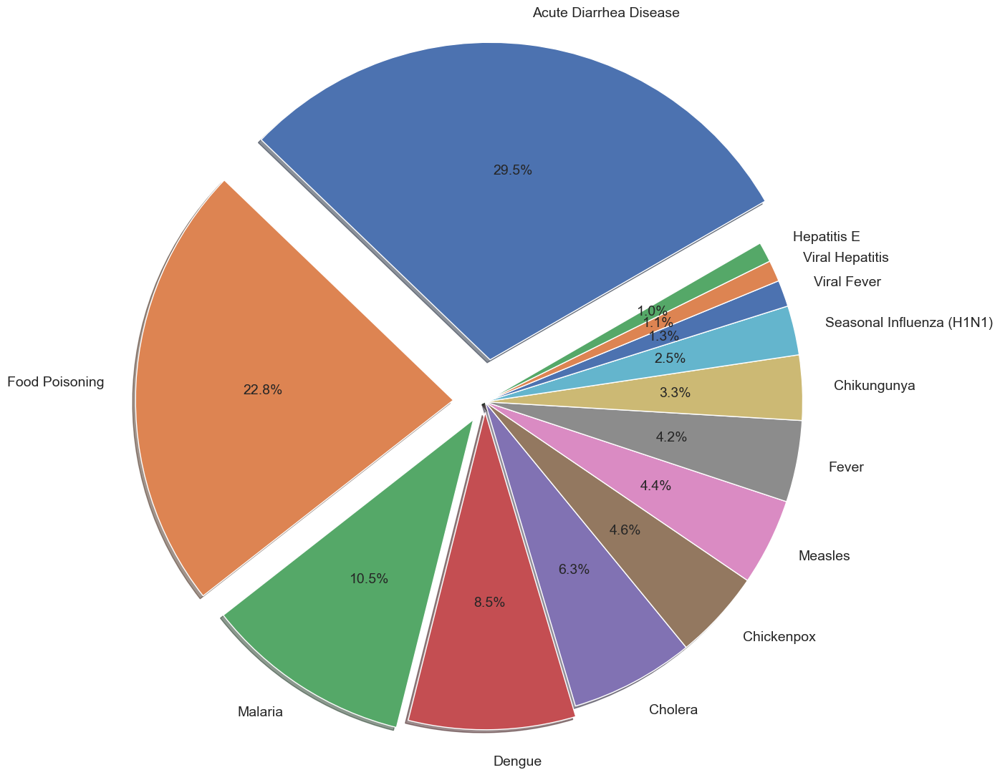

In [98]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Disease/Illness','No. of Cases']]
intermediate_data = intermediate_data.groupby('Disease/Illness').sum()
#As the record is too high so keeping all the record make the plot cumbersome, hence taking top 13 values for plotting
intermediate_sorted_data = pd.DataFrame(intermediate_data['No. of Cases'].sort_values(ascending=False)[:13])
explode = (0.4, 0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0)
plt.pie(intermediate_sorted_data['No. of Cases'], labels = intermediate_sorted_data.index, autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

### No. of Deaths Vs Name of State/UT

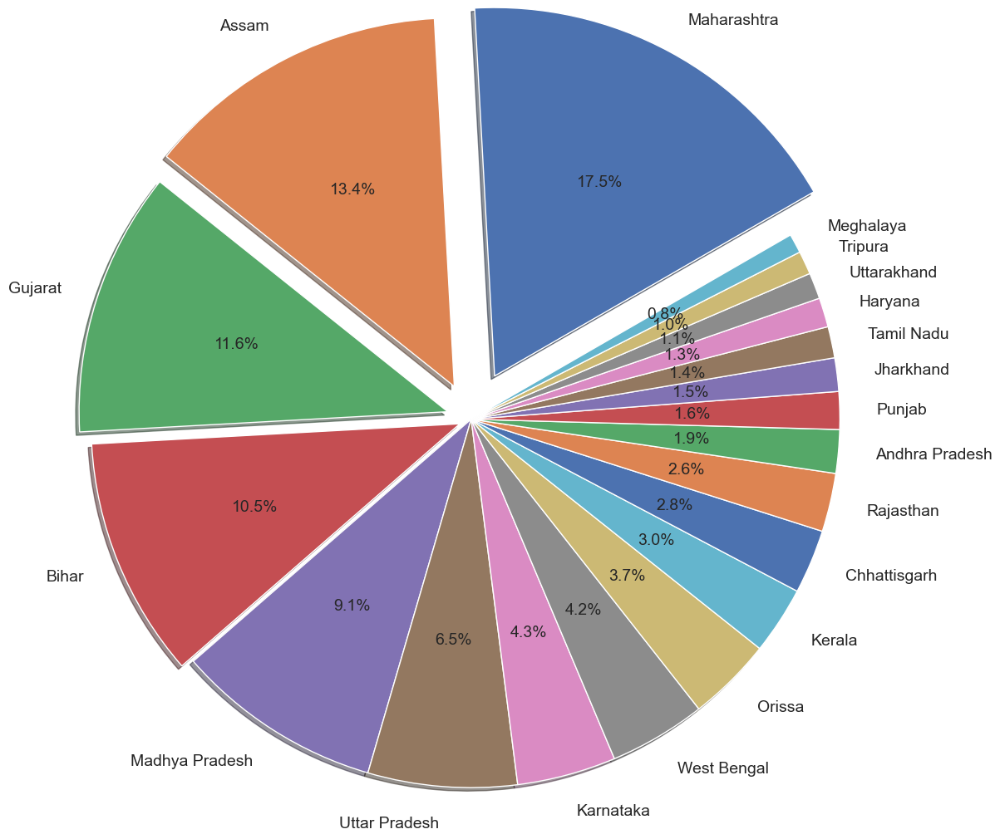

In [99]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Name of State/UT','No. of Deaths']]
intermediate_data = intermediate_data.groupby('Name of State/UT').sum()
#As the record is too high so keeping all the record make the plot cumbersome, hence taking top 20 values for plotting
intermediate_sorted_data = pd.DataFrame(intermediate_data['No. of Deaths'].sort_values(ascending=False)[:20])
explode = (0.4, 0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)
plt.pie(intermediate_sorted_data['No. of Deaths'], labels = intermediate_sorted_data.index, autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

### No. of Deaths Vs Name of District

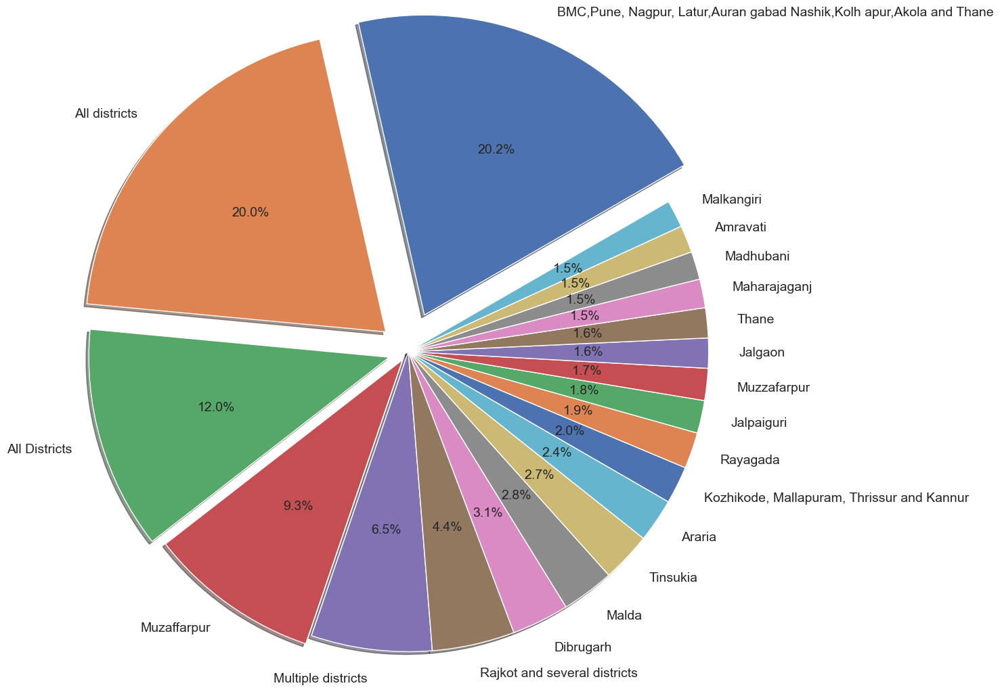

In [100]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Name of District','No. of Deaths']]
intermediate_data = intermediate_data.groupby('Name of District').sum()
#As the record is too high so keeping all the record make the plot cumbersome, hence taking top 20 values for plotting
intermediate_sorted_data = pd.DataFrame(intermediate_data['No. of Deaths'].sort_values(ascending=False)[:20])
explode = (0.4, 0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)
plt.pie(intermediate_sorted_data['No. of Deaths'], labels = intermediate_sorted_data.index, autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

### No. of Deaths Vs Disease/Illness

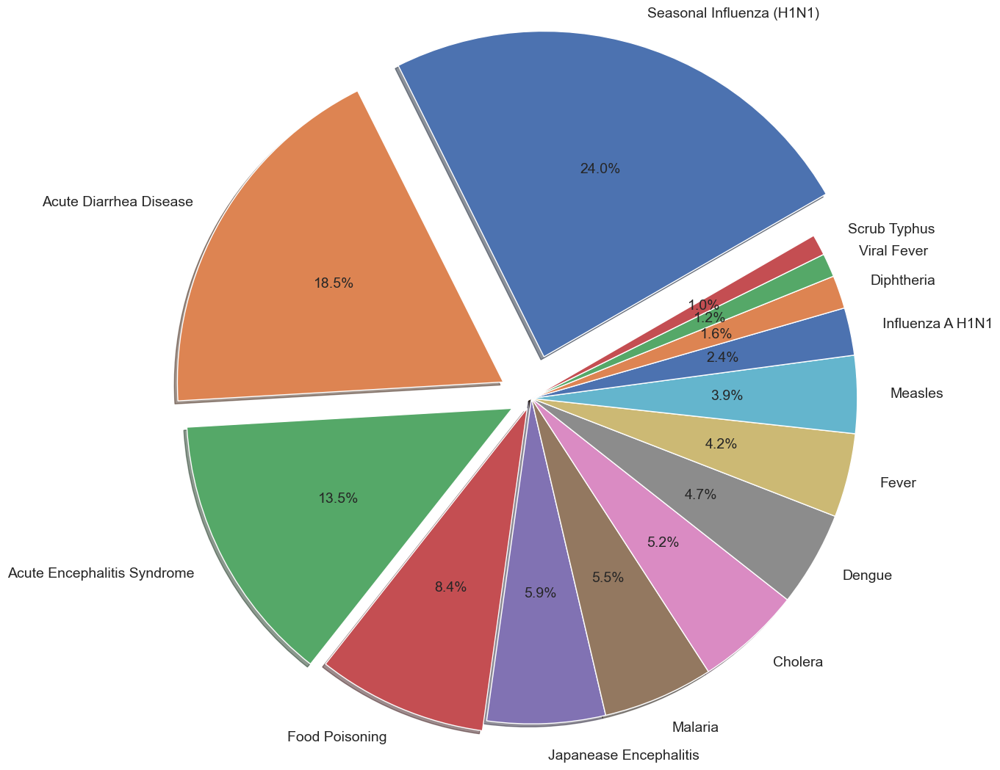

In [101]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Disease/Illness','No. of Deaths']]
intermediate_data = intermediate_data.groupby('Disease/Illness').sum()
#As the record is too high so keeping all the record make the plot cumbersome, hence taking top 14 values for plotting
intermediate_sorted_data = pd.DataFrame(intermediate_data['No. of Deaths'].sort_values(ascending=False)[:14])
explode = (0.4, 0.3, 0.2, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)
plt.pie(intermediate_sorted_data['No. of Deaths'], labels = intermediate_sorted_data.index, autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

In [102]:
#Scatter Plot:
#1. No. of  Death Vs No. of Cases for State, District

In [103]:
intermediate_data = clean_df_OutbreakIndia.loc[:,['Name of State/UT','Name of District','No. of Cases','No. of Deaths','Current Status']]
intermediate_data

,Name of State/UT,Name of District,No. of Cases,No. of Deaths,Current Status
0,Karnataka,Shimoga,38,0,Under Control
1,Madhya Pradesh,09 Districts,66,0,Under Surveillance
2,Jharkhand,10 Districts,180,2,Under Surveillance
3,Jharkhand,20 Districts,169,0,Under Surveillance
4,West Bengal,24 South Paragnas,65,0,Under Surveillance
...,...,...,...,...,...
17646,Maharashtra,Yavatmal,6,0,Under Control
17647,Maharashtra,Yavatmal,13,1,Under Control
17648,Andhra Pradesh,YSR Kadapa,22,0,Under Surveillance
17649,Nagaland,Zunheboto,243,0,Under Surveillance


### Scatter plot of State wise No. of Cases Vs No. of Deaths

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\132498348.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  statewisedata = intermediate_data.groupby(['Name of State/UT']).sum()


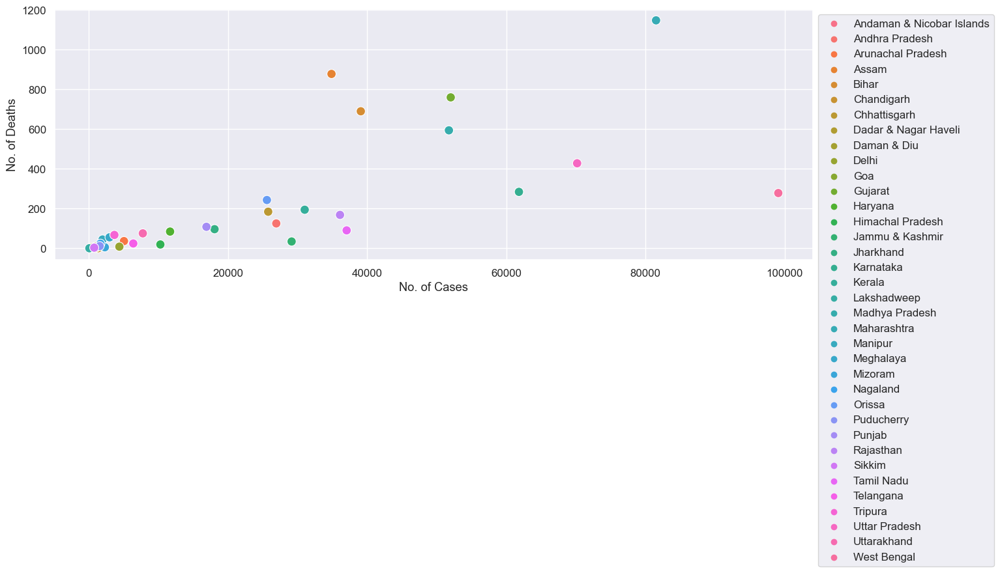

In [104]:
statewisedata = intermediate_data.groupby(['Name of State/UT']).sum()
plt.figure(figsize=(15,5))
sns.scatterplot(data=statewisedata, x="No. of Cases", y="No. of Deaths",hue="Name of State/UT", legend='full',s=100)
plt.legend(bbox_to_anchor = (1,1))
#plt.title('Scatter plot of State wise No. of Cases Vs No. of Deaths')
plt.show()

### Scatter plot of District wise No. of Cases Vs No. of Deaths

In [105]:
statewisedata = intermediate_data.groupby(['Name of District']).sum()
plt.figure(figsize=(15,5))
sns.scatterplot(data=statewisedata, x="No. of Cases", y="No. of Deaths",hue="Name of District", legend='full',s=100)
plt.legend(bbox_to_anchor = (1,1))
#plt.title('Scatter plot of District wise No. of Cases Vs No. of Deaths')
plt.show()

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\1268354719.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  statewisedata = intermediate_data.groupby(['Name of District']).sum()


#### • Word clouds of different outbreaks in different districts

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:13: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  OrderedDistrict_BasedofNoofCases = pd.DataFrame(wordcloud_intermediate_data.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False).index)
C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in Jaintia Hills district


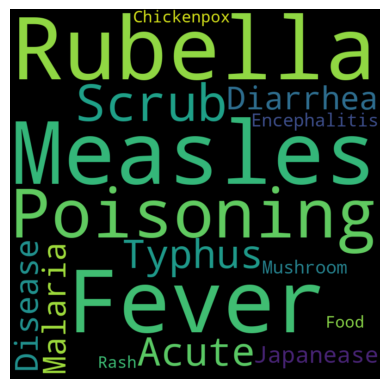

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in West Khasi Hills district


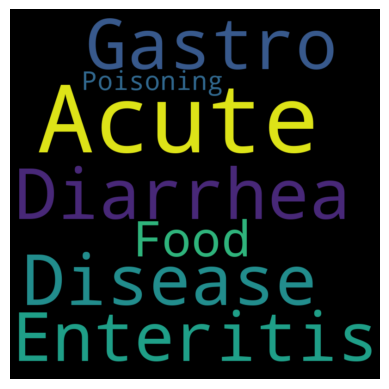

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in Ri Bhoi district


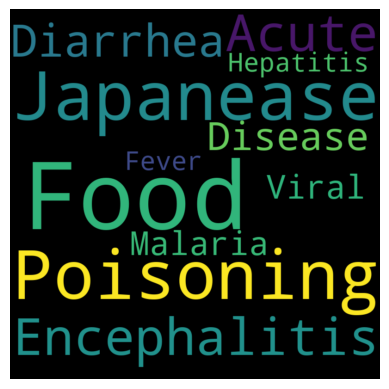

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in West Garo Hills district


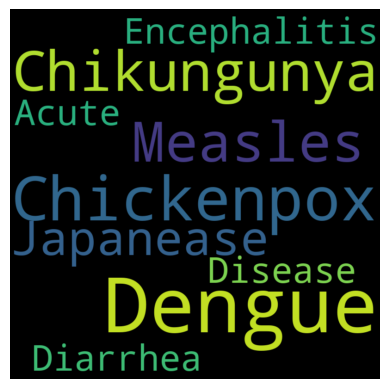

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in East Khasi Hills district


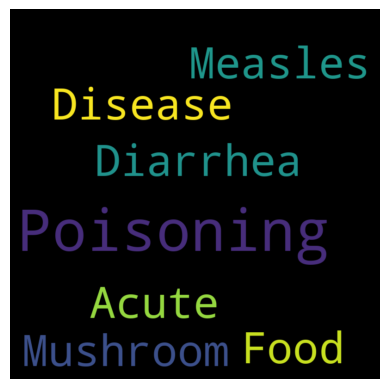

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in East Garo Hills district


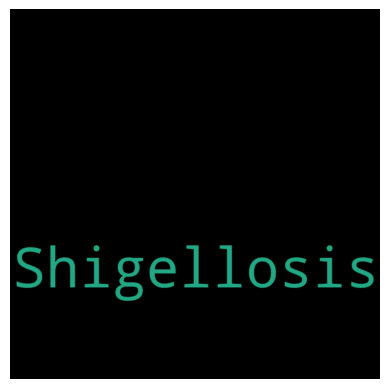

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in Garo Hills district


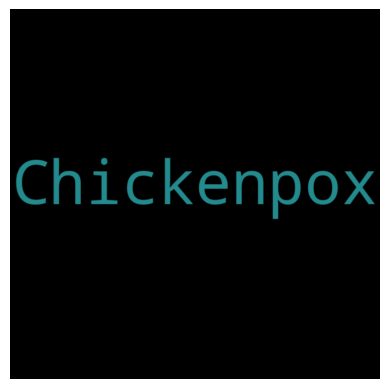

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills district


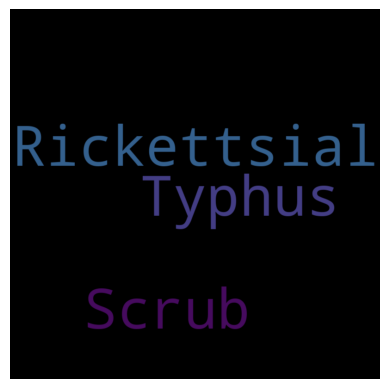

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in South Garo Hills district


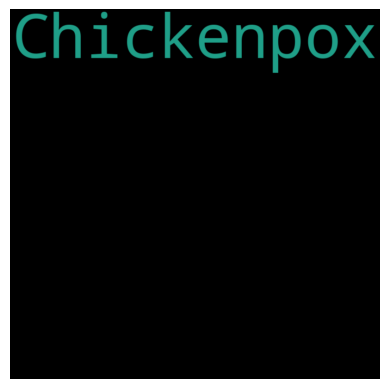

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in Jaintia Hills & West Kashi Hills district


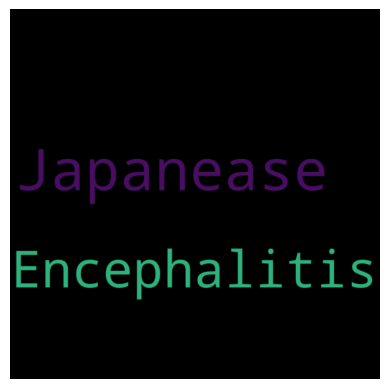

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2914475922.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


Different outbreak in South West Garo Hills district


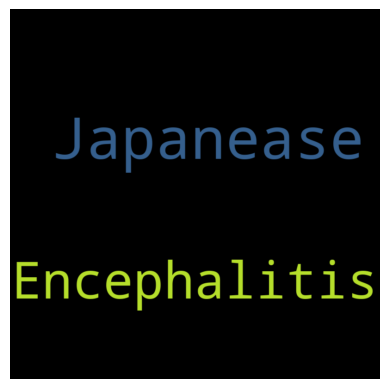

In [106]:
#Algo:
#    1. Group the district name with higher to lower no of cases
#    2. loop through the district and get maximum diseases for each of them and plot based on the district

#Data required for word cloud plot
if onlyAssignedDist == True:
    filter_clean_df_OutbreakIndia_Intermediate = clean_df_OutbreakIndia[clean_df_OutbreakIndia["Name of State/UT"] == filtering_state]
else:
    filter_clean_df_OutbreakIndia_Intermediate = clean_df_OutbreakIndia
    
wordcloud_intermediate_data = filter_clean_df_OutbreakIndia_Intermediate.loc[:,['Name of District','Disease/Illness','No. of Cases']]
#Ordered sequence of district based on outbreak
OrderedDistrict_BasedofNoofCases = pd.DataFrame(wordcloud_intermediate_data.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False).index)
stopwords = set(STOPWORDS)
#wordcloud object creation 
objwordcloud = WordCloud(width = 800, height = 800,background_color ='black',stopwords = stopwords,min_font_size = 12)
#Loop through each district and plot word cloud based on the different outbreak diseases based on severity of impact
for each_district in OrderedDistrict_BasedofNoofCases['Name of District']:
    each_district_wisedata = wordcloud_intermediate_data[wordcloud_intermediate_data['Name of District'] == each_district]
    #print(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)
    diseases = pd.DataFrame(each_district_wisedata.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)
    comma_seperated_diseases = ''
    for each_disease in diseases['Disease/Illness']:
        comma_seperated_diseases += each_disease + ','   
    print(f'Different outbreak in {each_district} district')
    objwordcloud.generate(comma_seperated_diseases.rstrip(comma_seperated_diseases[-1]))
    plt.imshow(objwordcloud, interpolation='bilinear')
    plt.title = each_district
    plt.axis("off")
    plt.show()      


#### Diseases wise wordcloud based on no of cases

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2198197301.py:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  DiseaseWiseCase = pd.DataFrame(wordcloud_intermediate_data.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)


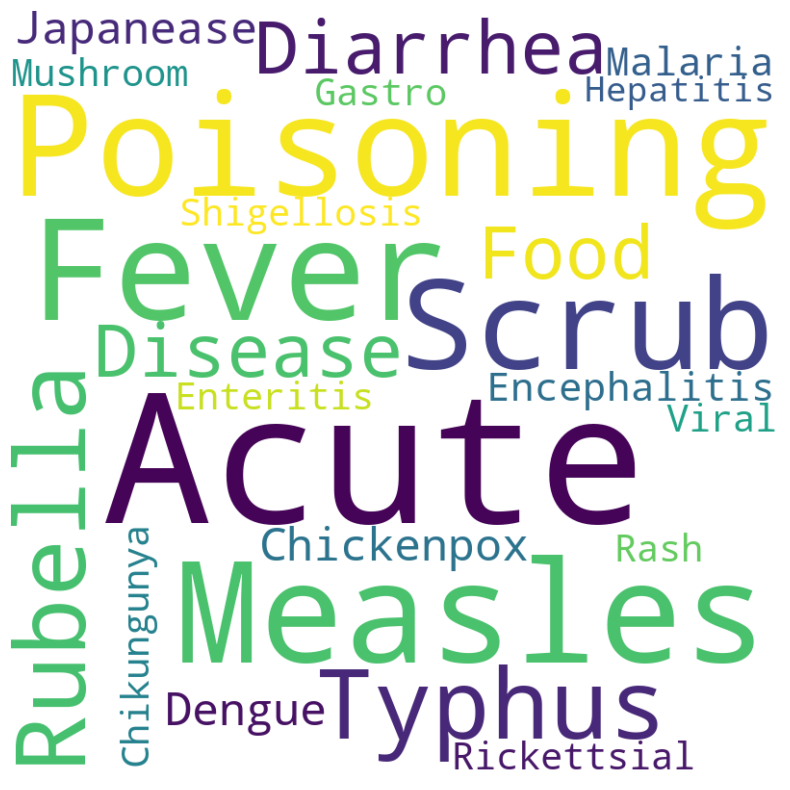

In [107]:
stopwords = set(STOPWORDS)
#wordcloud object creation 
objwordcloud_diseases = WordCloud(width = 800, height = 800,background_color ='white',stopwords = stopwords,min_font_size = 12)
DiseaseWiseCase = pd.DataFrame(wordcloud_intermediate_data.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)
comma_seperated_diseases_noofcase = ''
for each_disease in DiseaseWiseCase['Disease/Illness']:
    comma_seperated_diseases_noofcase += each_disease + ','
objwordcloud_diseases.generate(comma_seperated_diseases_noofcase.rstrip(comma_seperated_diseases_noofcase[-1]))
plt.figure(figsize=(10,10), facecolor=None)
plt.imshow(objwordcloud_diseases, interpolation='bilinear')
plt.axis("off")
plt.show()  

#### District wise word cloud based on no of cases

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3862933262.py:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  DistrictWiseCase = pd.DataFrame(wordcloud_intermediate_data.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False).index)


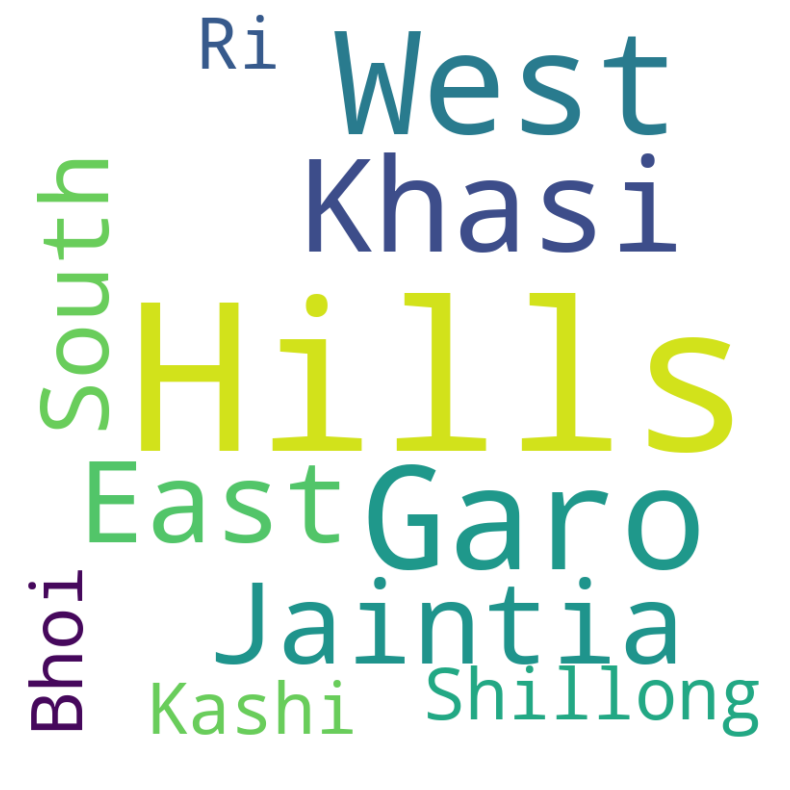

In [108]:
stopwords = set(STOPWORDS)
#wordcloud object creation 
objwordcloud_district = WordCloud(width = 800, height = 800,background_color ='white',stopwords = stopwords,min_font_size = 12)
DistrictWiseCase = pd.DataFrame(wordcloud_intermediate_data.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False).index)
comma_seperated_district_noofcase = ''
for each_district in DistrictWiseCase['Name of District']:
    comma_seperated_district_noofcase += each_district + ','
objwordcloud_district.generate(comma_seperated_district_noofcase.rstrip(comma_seperated_district_noofcase[-1]))
plt.figure(figsize=(10,10), facecolor=None)
plt.imshow(objwordcloud_district, interpolation='bilinear')
plt.axis("off")
plt.show()  

#### • Geo-spatial plots for top 10 outbreaks in the assigned state - Meghalaya

In [109]:
#Filter for Meghalaya 
clean_df_OutbreakIndia_Meghalaya = clean_df_OutbreakIndia[clean_df_OutbreakIndia["Name of State/UT"] == filtering_state]

In [110]:
np.unique(clean_df_OutbreakIndia_Meghalaya['Name of District']) 

array(['East Garo Hills', 'East Khasi Hills', 'Garo Hills',
       'Jaintia Hills', 'Jaintia Hills & West Kashi Hills', 'Ri Bhoi',
       'Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills',
       'South Garo Hills', 'South West Garo Hills', 'West Garo Hills',
       'West Khasi Hills'], dtype=object)

#### Top 10 outbreak for Meghalaya of all time

In [111]:
OrderedDiseases_BasedofNoofCases_Meghalaya = pd.DataFrame(clean_df_OutbreakIndia_Meghalaya.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False))
OrderedDiseases_BasedofNoofCases_Meghalaya.reset_index(level=0, inplace=True)
OrderedDiseases_BasedofNoofCases_Meghalaya[:10]

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3807737510.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  OrderedDiseases_BasedofNoofCases_Meghalaya = pd.DataFrame(clean_df_OutbreakIndia_Meghalaya.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False))


,Disease/Illness,No. of Cases
0,Acute Diarrhea Disease,907
1,Food Poisoning,480
2,Measles,321
3,Chickenpox,200
4,Dengue,189
5,Fever,182
6,Japanease Encephalitis,137
7,Scrub Typhus,119
8,Malaria,77
9,Measles & Rubella,76


In [112]:
OrderedDistrict_BasedofNoofCases_Meghalaya = pd.DataFrame(clean_df_OutbreakIndia_Meghalaya.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))
OrderedDistrict_BasedofNoofCases_Meghalaya_noIndex = OrderedDistrict_BasedofNoofCases_Meghalaya.reset_index(level=0)
OrderedDistrict_BasedofNoofCases_Meghalaya_noIndex[:10]

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\2933694496.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  OrderedDistrict_BasedofNoofCases_Meghalaya = pd.DataFrame(clean_df_OutbreakIndia_Meghalaya.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


,Name of District,No. of Cases
0,Jaintia Hills,1024
1,West Khasi Hills,713
2,Ri Bhoi,451
3,West Garo Hills,406
4,East Khasi Hills,254
5,East Garo Hills,66
6,Garo Hills,41
7,"Shillong, East Khasi Hills, West Khasi Hills &...",16
8,South Garo Hills,14
9,Jaintia Hills & West Kashi Hills,5


In [113]:
OrderedDistrict_BasedofNoofCases_Meghalaya

,No. of Cases
Name of District,
Jaintia Hills,1024
West Khasi Hills,713
Ri Bhoi,451
West Garo Hills,406
East Khasi Hills,254
East Garo Hills,66
Garo Hills,41
"Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills",16
South Garo Hills,14


#### Load the SHP file for Meghalaya

In [114]:
path = districtSHPPath
india_shp_df = geopnda.read_file(path)
india_shp_df_Meghalaya = india_shp_df[india_shp_df['ST_NM'] == filtering_state] 
india_shp_df_Meghalaya

,DISTRICT,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry
167,East Garo Hills,Meghalaya,17,2,294,"POLYGON ((91.03234 25.88749, 91.03220 25.87930..."
170,East Khasi Hills,Meghalaya,17,6,298,"POLYGON ((92.01985 25.18684, 92.01391 25.18854..."
238,Jaintia Hills,Meghalaya,17,7,299,"POLYGON ((92.66161 25.57945, 92.66152 25.56794..."
482,Ri Bhoi,Meghalaya,17,5,297,"POLYGON ((92.18042 26.07789, 92.18305 26.07455..."
545,South Garo Hills,Meghalaya,17,3,295,"POLYGON ((90.97256 25.17201, 90.95847 25.16973..."
613,West Garo Hills,Meghalaya,17,1,293,"POLYGON ((90.32286 25.46537, 90.31025 25.43463..."
616,West Khasi Hills,Meghalaya,17,4,296,"POLYGON ((91.81149 25.64286, 91.81036 25.63488..."


#### As per the SHP file it is not possible to map couple of district properly, hence we have get rid of couple of data. below is the mapping I have done as per my understanding.

##### 1.  West Khasi Hills -----> West Khasi Hills
##### 2. Jaintia Hills	----->                Jaintia Hills
##### 3. Ri-Bhoi ----->	                        Ri Bhoi
##### 4.  West Garo Hill ----->	                West Garo Hills
##### 5. West Jaintia Hills ----->	            Jaintia Hills
##### 6. East Khasi Hills ----->	            East Khasi Hills
##### 7. West Khasi Hills (Nongstoin) -----> 	West Khasi Hills
##### 8. East Garo Hills ----->	                East Garo Hills
##### 9. East Jaintia Hills ----->	            Jaintia Hills
##### 10. Ri-Bhoi(Nongpoh) ----->	            Ri Bhoi
##### 11. Garo Hills ----->	                    Not possible to map (41)
##### 12. West Jaintiahills ----->	            Jaintia Hills
##### 13. West Garo Hills ----->	                West Garo Hills   
##### 14. Shillong, East Khasi Hills,
##### West Khasi Hills 
##### & Jaintia Hills	----->                Not possible to map (16)
##### 15. South Garo Hills	-----> 			South Garo Hills
##### 16. Jaintia Hills 
##### & West Kashi Hills	----->            Not possible to map (5)
##### 17. South West Garo Hills ----->	        Not possible to map (4)

##### Total number of data sacrificed due to impossibility of matching of district is (41+16+5+4) = 66

In [115]:
merged_data_Meghalaya = india_shp_df_Meghalaya.set_index('DISTRICT').join(OrderedDistrict_BasedofNoofCases_Meghalaya)
merged_data_Meghalaya
#There is no NAN value is present so further clean up is not required.

,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry,No. of Cases
DISTRICT,,,,,,
East Garo Hills,Meghalaya,17,2,294,"POLYGON ((91.03234 25.88749, 91.03220 25.87930...",66
East Khasi Hills,Meghalaya,17,6,298,"POLYGON ((92.01985 25.18684, 92.01391 25.18854...",254
Jaintia Hills,Meghalaya,17,7,299,"POLYGON ((92.66161 25.57945, 92.66152 25.56794...",1024
Ri Bhoi,Meghalaya,17,5,297,"POLYGON ((92.18042 26.07789, 92.18305 26.07455...",451
South Garo Hills,Meghalaya,17,3,295,"POLYGON ((90.97256 25.17201, 90.95847 25.16973...",14
West Garo Hills,Meghalaya,17,1,293,"POLYGON ((90.32286 25.46537, 90.31025 25.43463...",406
West Khasi Hills,Meghalaya,17,4,296,"POLYGON ((91.81149 25.64286, 91.81036 25.63488...",713


#### Geo spatial plot for Meghalaya based on top 10 outbreak diseases of all time

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


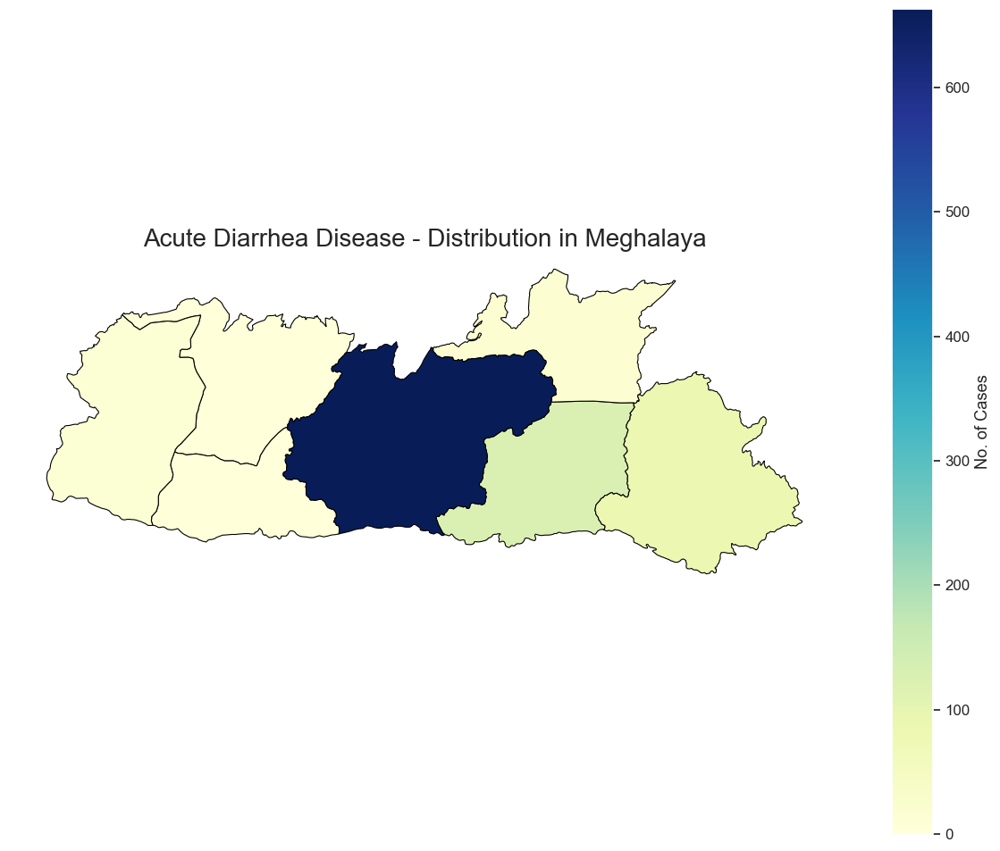

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


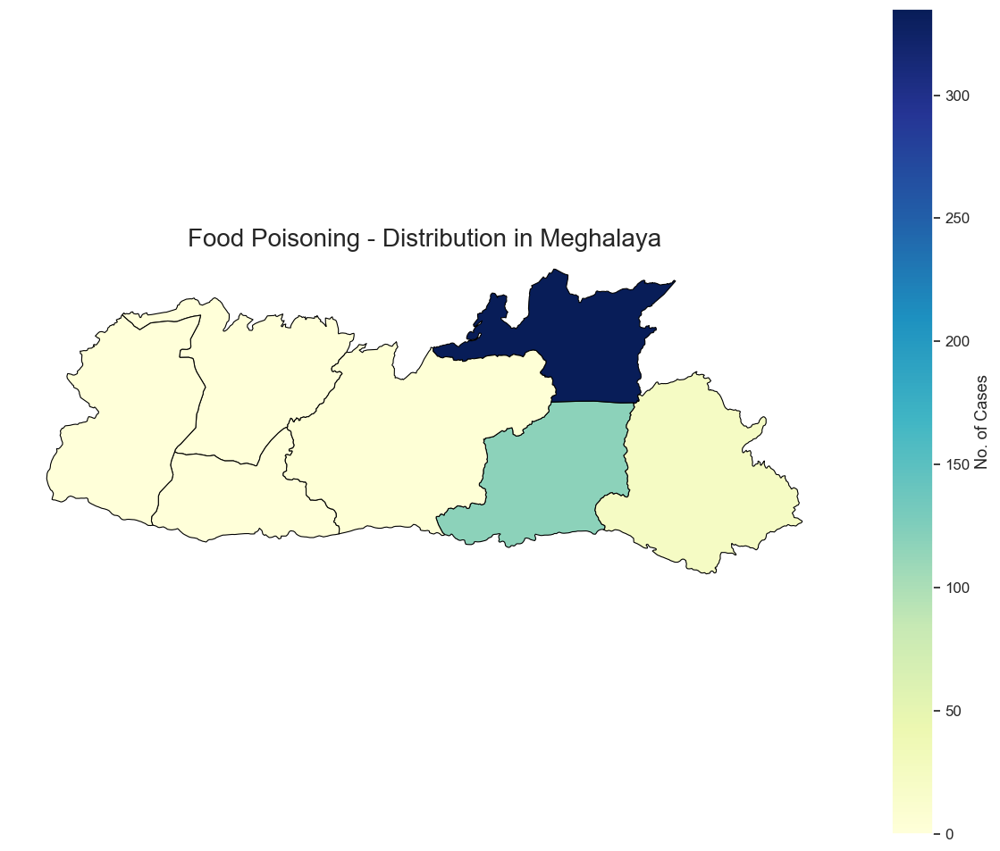

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


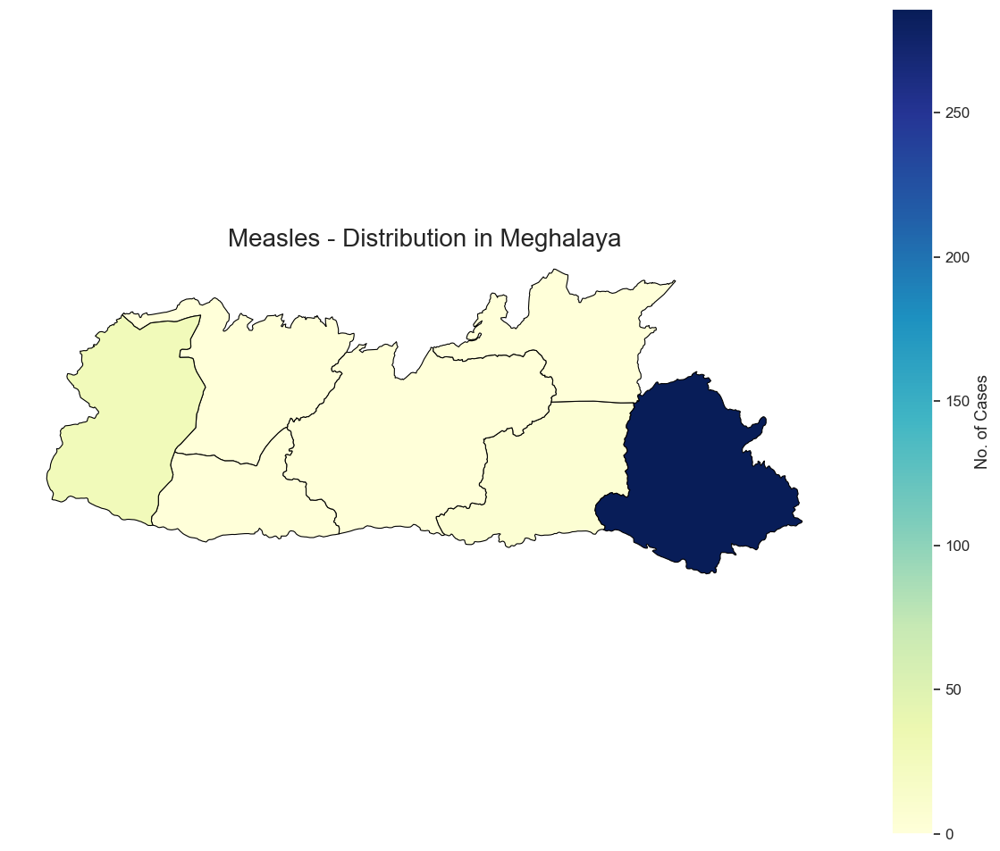

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


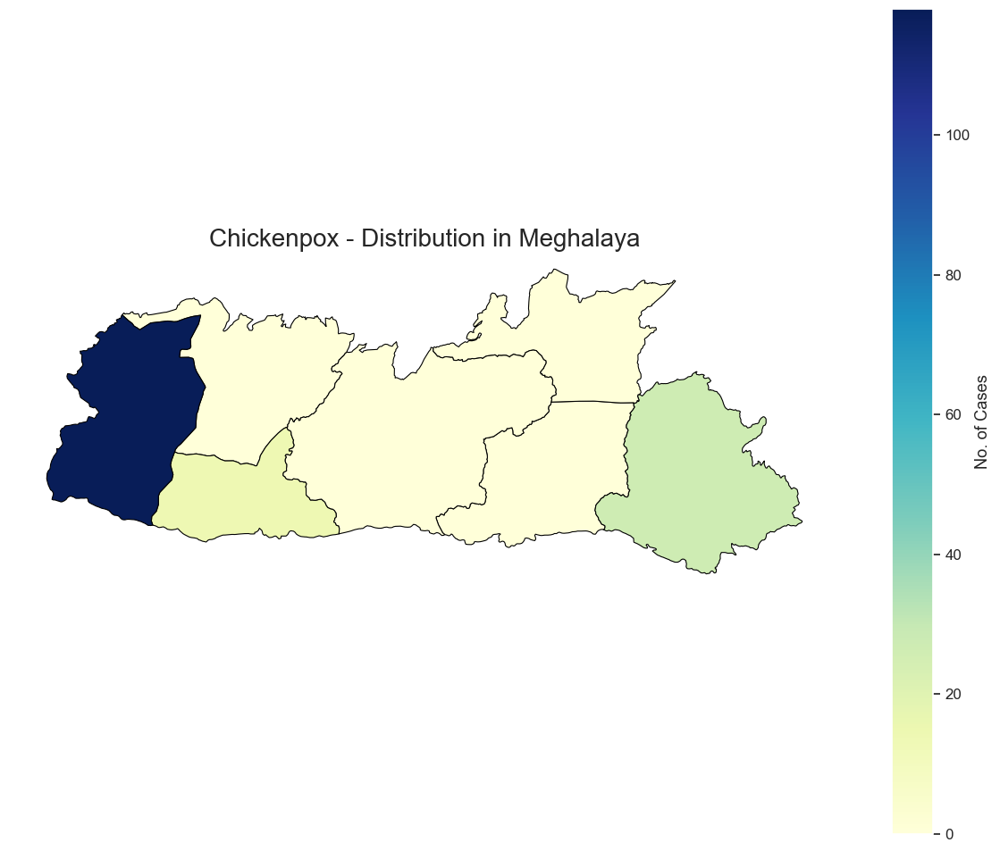

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


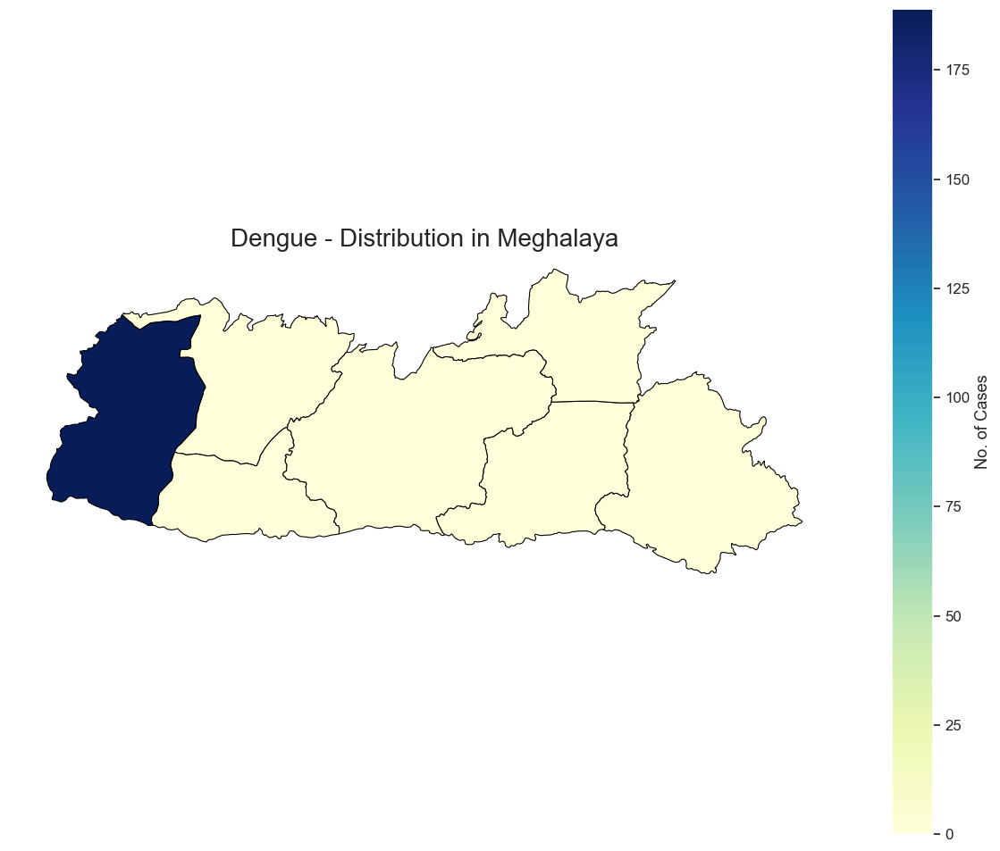

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


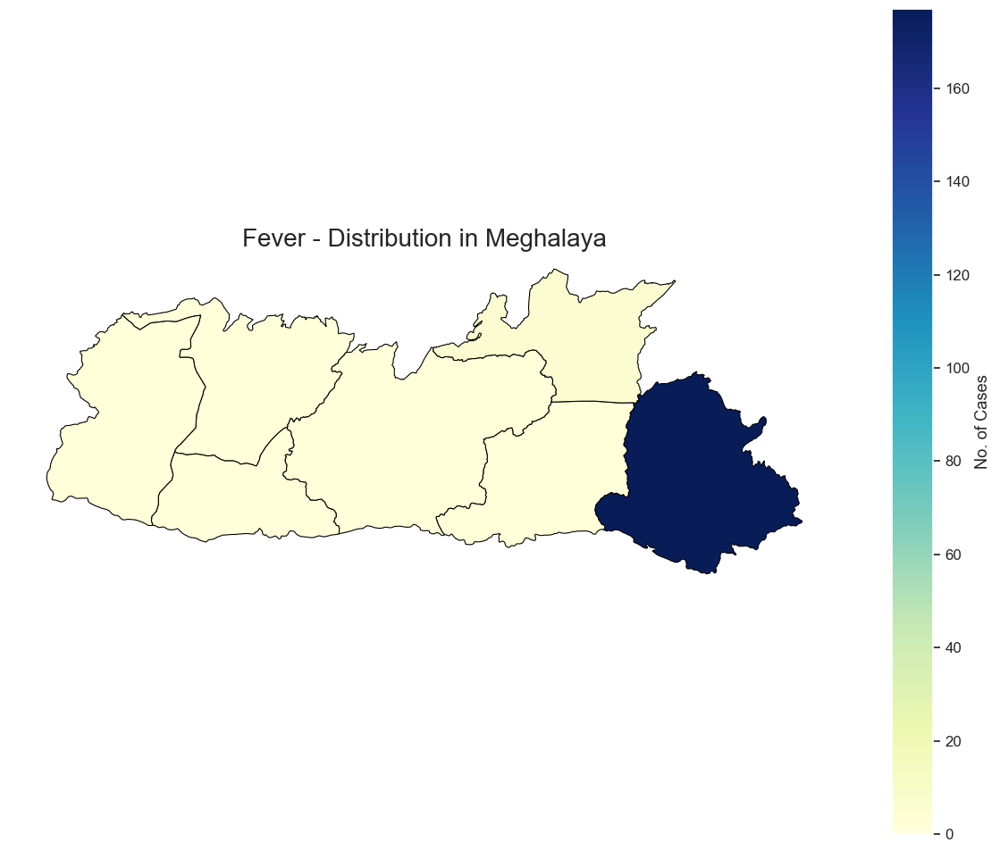

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


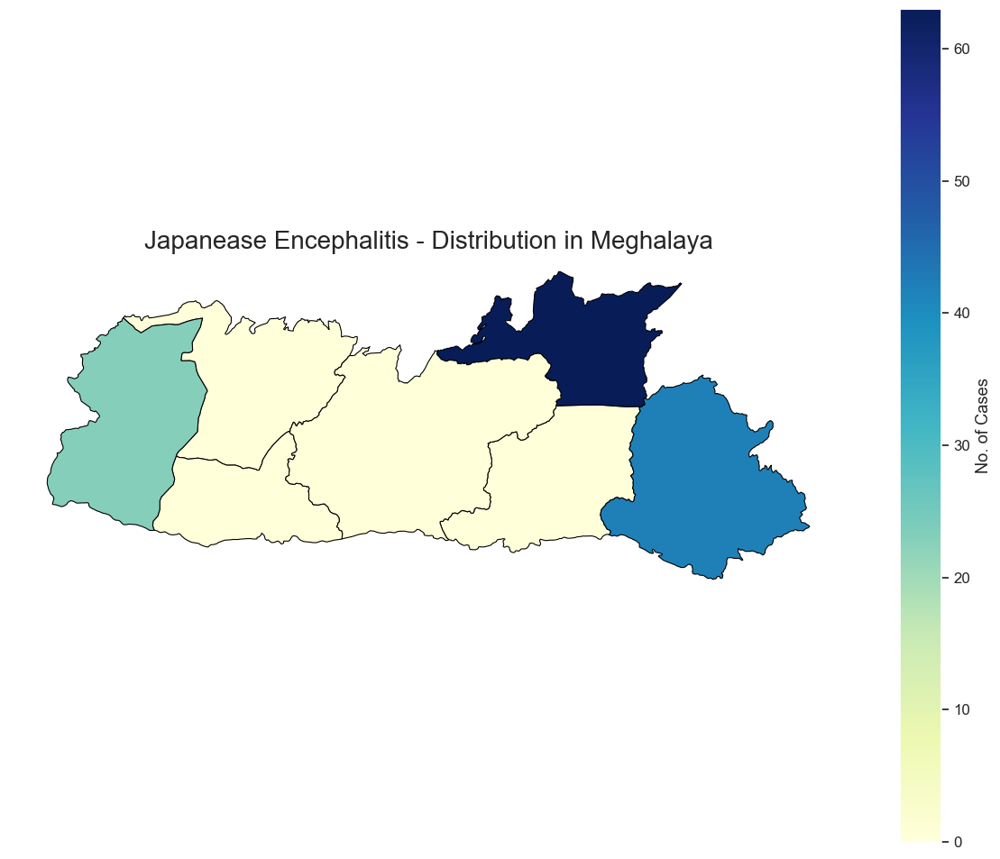

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


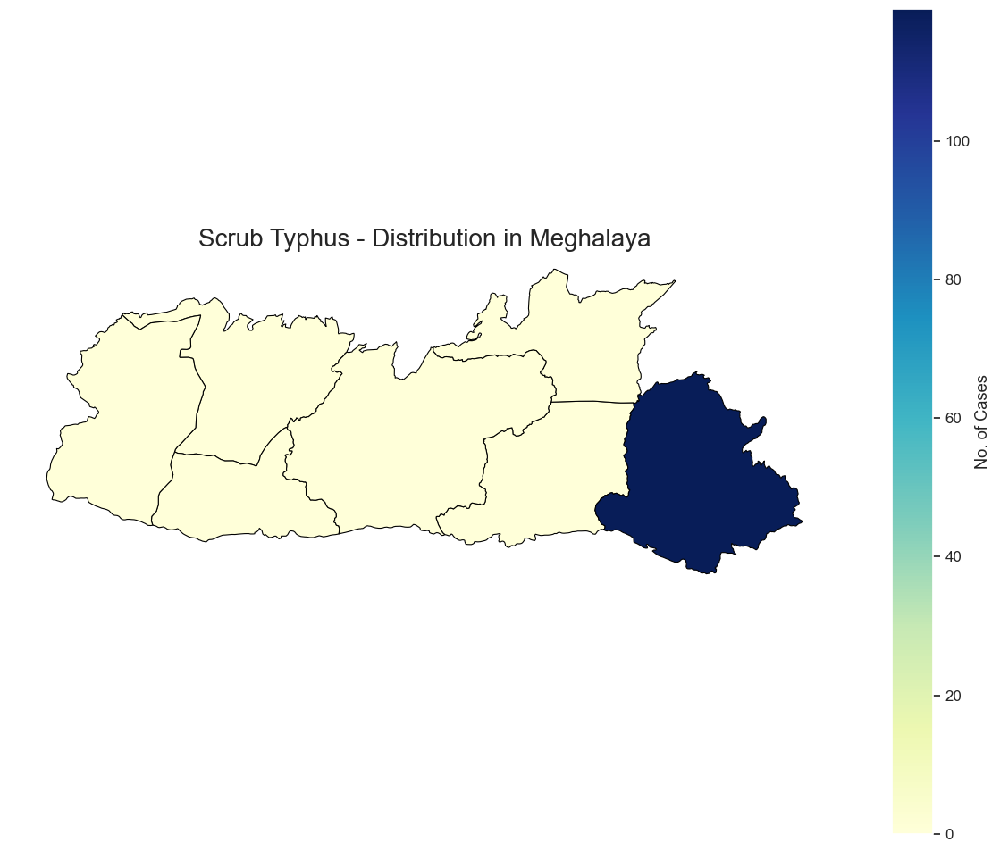

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


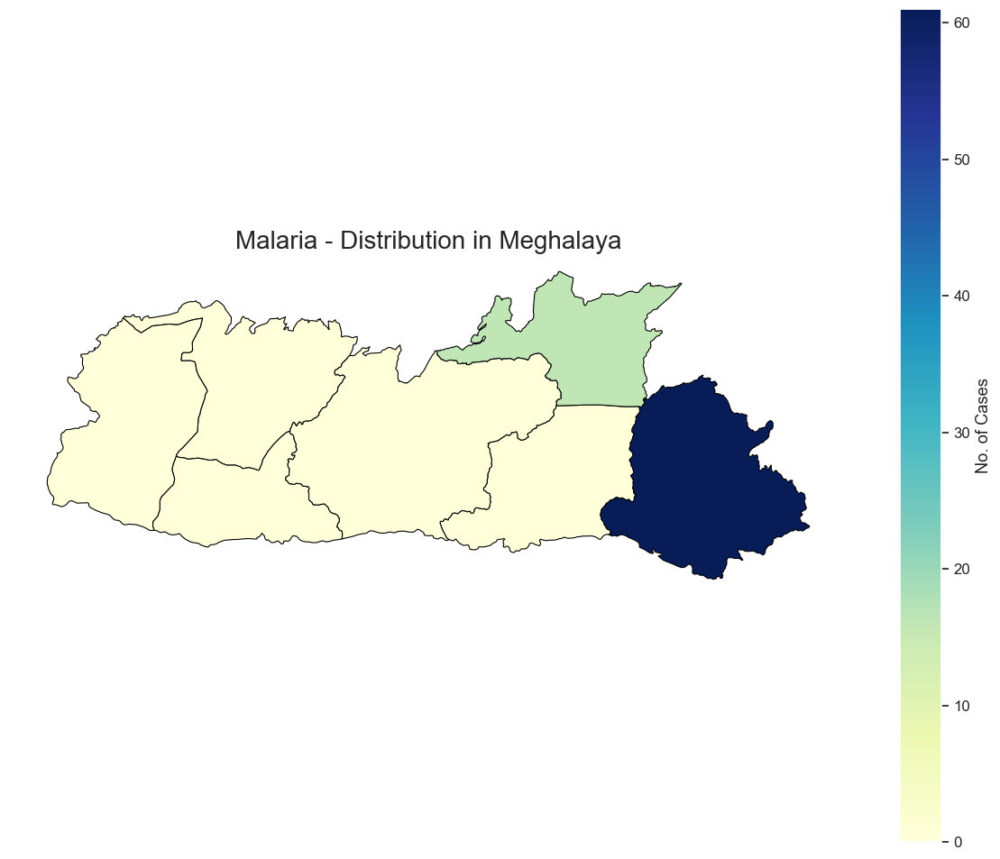

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\3711973780.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))


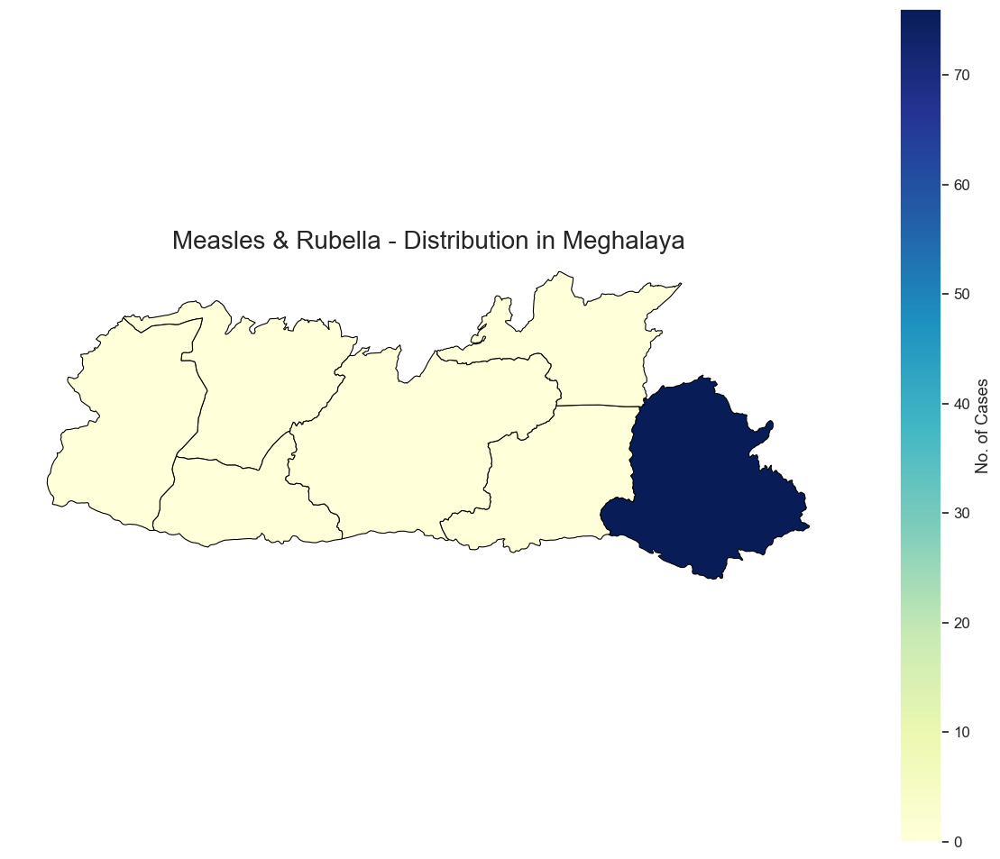

In [116]:
top10_Outbreak_in_Meghalaya = OrderedDiseases_BasedofNoofCases_Meghalaya[:10]
#top10_Outbreak_in_Meghalaya
for disease in top10_Outbreak_in_Meghalaya['Disease/Illness']:    
    filterData = clean_df_OutbreakIndia_Meghalaya[clean_df_OutbreakIndia_Meghalaya['Disease/Illness'] == disease]    
    disaseswisedata = pd.DataFrame(filterData.groupby('Name of District').sum()['No. of Cases'].sort_values(ascending=False))
    mergeddisaseswisedata_Meghalaya = india_shp_df_Meghalaya.set_index('DISTRICT').join(disaseswisedata)
    mergeddisaseswisedata_Meghalaya_replaceNA = mergeddisaseswisedata_Meghalaya.replace(np.nan, 0)
    fig, ax = plt.subplots(1, figsize=(15, 12))
    ax.axis('off')
    ax.set_title(f'{disease} - Distribution in {filtering_state}', fontdict={'fontsize': '20', 'fontweight' : '10'})
    mergeddisaseswisedata_Meghalaya_replaceNA.plot(column='No. of Cases',cmap='YlGnBu', linewidth=0.8, ax=ax, edgecolor='0',legend=True,markersize=[39.739192, -104.990337], legend_kwds={'label': "No. of Cases"})
    plt.show()

#### Geo spatial plot for Meghalaya based on most affected district by outbreak of all time

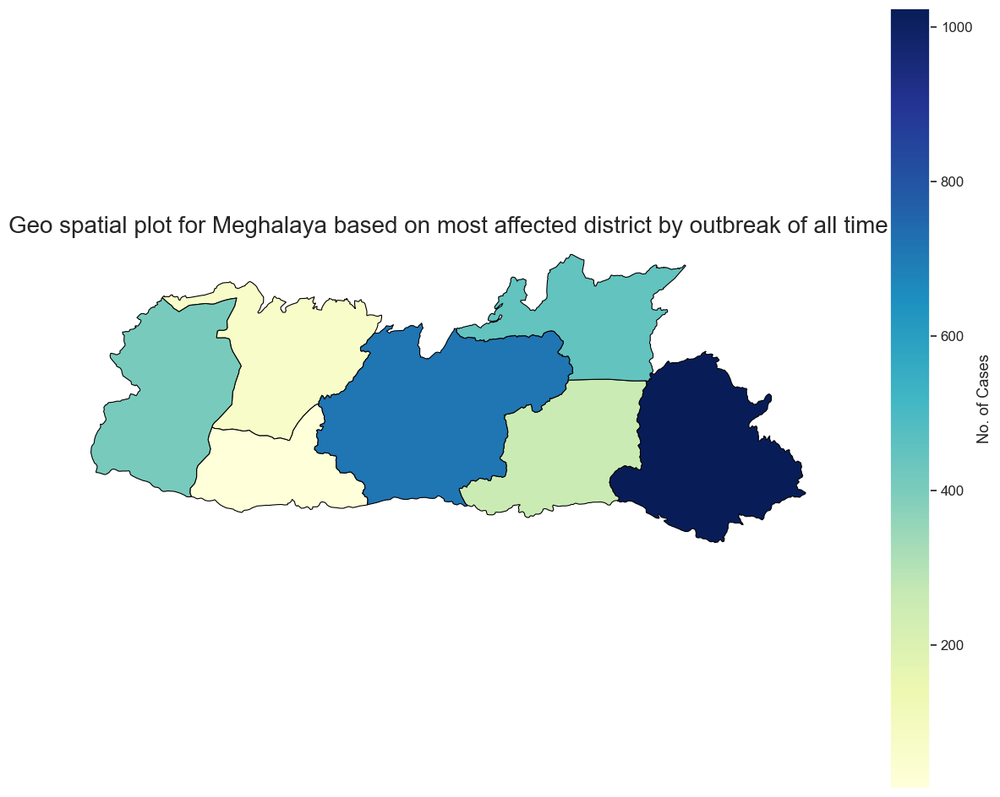

In [117]:
fig, ax = plt.subplots(1, figsize=(15, 12))
ax.axis('off')
ax.set_title(f'Geo spatial plot for {filtering_state} based on most affected district by outbreak of all time', fontdict={'fontsize': '20', 'fontweight' : '10'})
merged_data_Meghalaya.plot(column='No. of Cases',cmap='YlGnBu', linewidth=0.8, ax=ax, edgecolor='0',legend=True,markersize=[39.739192, -104.990337], legend_kwds={'label': "No. of Cases"})
plt.show()

#### For the assigned ”outbreak”, the geospatial plot for different states. #fever

#### Load India shp file for plotting the geospatial plot

In [118]:
path = indiaSHPPath
india_shp_df = geopnda.read_file(path)

In [119]:
#Chaging the state name based on our data set 
india_shp_df['st_nm'] = india_shp_df['st_nm'].replace( "Dadra and Nagar Haveli", "Dadar & Nagar Haveli" )
india_shp_df['st_nm'] = india_shp_df['st_nm'].replace( "Jammu and Kashmir", "Jammu & Kashmir" )
india_shp_df['st_nm'] = india_shp_df['st_nm'].replace( "Odisha", "Orissa" )

In [120]:
india_shp_df

,id,st_nm,geometry
0,None,Andaman and Nicobar Islands,"MULTIPOLYGON (((93.84831 7.24028, 93.92705 7.0..."
1,None,Arunachal Pradesh,"POLYGON ((95.23643 26.68105, 95.19594 27.03612..."
2,None,Assam,"POLYGON ((95.19594 27.03612, 95.08795 26.94578..."
3,None,Bihar,"POLYGON ((88.11357 26.54028, 88.28006 26.37640..."
4,None,Chandigarh,"POLYGON ((76.84208 30.76124, 76.83758 30.72552..."
5,None,Chhattisgarh,"POLYGON ((83.94694 23.62196, 83.95594 23.62406..."
6,None,Dadar & Nagar Haveli,"POLYGON ((73.20640 20.12165, 73.20865 20.10695..."
7,None,Daman and Diu,"POLYGON ((72.80144 20.37378, 72.84418 20.47463..."
8,None,Goa,"POLYGON ((74.11982 15.65278, 74.24806 15.65698..."
9,None,Gujarat,"MULTIPOLYGON (((68.35808 23.80475, 68.41658 23..."


#### Filter entire data with fever outbreak

In [121]:
filter_clean_df_OutbreakIndia_fever = clean_df_OutbreakIndia[clean_df_OutbreakIndia['Disease/Illness'] == assignedOutbreak]
filter_clean_df_OutbreakIndia_fever

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
142,143.0,Maharashtra,Ahmednagar,Fever,137,0,22-08-2012,Reported late,Under Control,"Cases reported form Village Karjat Gavthan, SC..."
143,144.0,Maharashtra,Ahmednagar,Fever,64,0,06-09-2012,Reported late,Under Control,"Outbreak reported from SC Bagvatipur, PHC Kola..."
145,146.0,Maharashtra,Ahmednagar,Fever,21,0,24-09-2012,Reported late,Under Control,"Outbreak reported from Village/SC Nagardevale,..."
146,147.0,Maharashtra,Ahmednagar,Fever,44,0,03-10-2012,Reported late,Under Control,"Outbreak reported from Village Satral, PHC Guh..."
147,148.0,Maharashtra,Ahmednagar,Fever,28,0,04-10-2012,Reported late,Under Control,"Outbreak reported from Village Hingangaon, PHC..."
...,...,...,...,...,...,...,...,...,...,...
17614,17615.0,Maharashtra,Yavatmal,Fever,20,1,15-10-2014,Reported late,Under Control,"Cases reported from Village Narli, SC Amdapur,..."
17615,17616.0,Maharashtra,Yavatmal,Fever,25,1,17-10-2014,Reported late,Under Surveillance,Cases of \n fever \n reported \n from Village ...
17616,17617.0,Maharashtra,Yavatmal,Fever,16,1,27-10-2014,05-11-2014,Under Surveillance,Cases \n reported \n from \n Village \n Talega...
17617,17618.0,Maharashtra,Yavatmal,Fever,10,1,28-10-2014,Reported late,Under Surveillance,"Cases of fever reported Village / SC Dhanoda, ..."


#### Group the data Name of State/UT wise by No of cases

In [122]:
ord_grp_filter_clean_df_OutbreakIndia_fever = filter_clean_df_OutbreakIndia_fever.groupby(['Name of State/UT']).sum().sort_values(by = 'No. of Cases',ascending=False)
ord_grp_filter_clean_df_OutbreakIndia_fever

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\4044243350.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ord_grp_filter_clean_df_OutbreakIndia_fever = filter_clean_df_OutbreakIndia_fever.groupby(['Name of State/UT']).sum().sort_values(by = 'No. of Cases',ascending=False)


,Serial no,No. of Cases,No. of Deaths
Name of State/UT,,,
Maharashtra,1938556.0,9315,164
Karnataka,1231679.0,4483,5
Tamil Nadu,1471581.0,2902,5
Madhya Pradesh,478118.0,2390,2
West Bengal,247490.0,1939,8
Rajasthan,54649.0,1494,0
Andhra Pradesh,410337.0,1403,14
Uttar Pradesh,211306.0,1397,13
Assam,161973.0,857,4


#### Delete the No. of Deaths column as it is not necessary for further operation

In [123]:
ord_grp_filter_clean_df_OutbreakIndia_fever.drop('No. of Deaths',axis=1, inplace=True)
ord_grp_filter_clean_df_OutbreakIndia_fever

,Serial no,No. of Cases
Name of State/UT,,
Maharashtra,1938556.0,9315
Karnataka,1231679.0,4483
Tamil Nadu,1471581.0,2902
Madhya Pradesh,478118.0,2390
West Bengal,247490.0,1939
Rajasthan,54649.0,1494
Andhra Pradesh,410337.0,1403
Uttar Pradesh,211306.0,1397
Assam,161973.0,857


#### Merge the map data with the no of cases 

In [124]:
merged_data_stateWise = india_shp_df.set_index('st_nm').join(ord_grp_filter_clean_df_OutbreakIndia_fever)
merged_data_stateWise

,id,geometry,Serial no,No. of Cases
st_nm,,,,
Andaman and Nicobar Islands,None,"MULTIPOLYGON (((93.84831 7.24028, 93.92705 7.0...",NaN,NaN
Arunachal Pradesh,None,"POLYGON ((95.23643 26.68105, 95.19594 27.03612...",34372.0,108.0
Assam,None,"POLYGON ((95.19594 27.03612, 95.08795 26.94578...",161973.0,857.0
Bihar,None,"POLYGON ((88.11357 26.54028, 88.28006 26.37640...",7776.0,2.0
Chandigarh,None,"POLYGON ((76.84208 30.76124, 76.83758 30.72552...",NaN,NaN
Chhattisgarh,None,"POLYGON ((83.94694 23.62196, 83.95594 23.62406...",NaN,NaN
Dadar & Nagar Haveli,None,"POLYGON ((73.20640 20.12165, 73.20865 20.10695...",NaN,NaN
Daman and Diu,None,"POLYGON ((72.80144 20.37378, 72.84418 20.47463...",NaN,NaN
Goa,None,"POLYGON ((74.11982 15.65278, 74.24806 15.65698...",26952.0,56.0


#### Replace the NAN value with 0 in the merged data to make it clean before geospatial plot

In [125]:
merged_data_stateWise['No. of Cases'] = merged_data_stateWise['No. of Cases'].replace(np.nan, 0)
merged_data_stateWise

,id,geometry,Serial no,No. of Cases
st_nm,,,,
Andaman and Nicobar Islands,None,"MULTIPOLYGON (((93.84831 7.24028, 93.92705 7.0...",NaN,0.0
Arunachal Pradesh,None,"POLYGON ((95.23643 26.68105, 95.19594 27.03612...",34372.0,108.0
Assam,None,"POLYGON ((95.19594 27.03612, 95.08795 26.94578...",161973.0,857.0
Bihar,None,"POLYGON ((88.11357 26.54028, 88.28006 26.37640...",7776.0,2.0
Chandigarh,None,"POLYGON ((76.84208 30.76124, 76.83758 30.72552...",NaN,0.0
Chhattisgarh,None,"POLYGON ((83.94694 23.62196, 83.95594 23.62406...",NaN,0.0
Dadar & Nagar Haveli,None,"POLYGON ((73.20640 20.12165, 73.20865 20.10695...",NaN,0.0
Daman and Diu,None,"POLYGON ((72.80144 20.37378, 72.84418 20.47463...",NaN,0.0
Goa,None,"POLYGON ((74.11982 15.65278, 74.24806 15.65698...",26952.0,56.0


#### Geo spatial plot for fever diseases through out different states of India

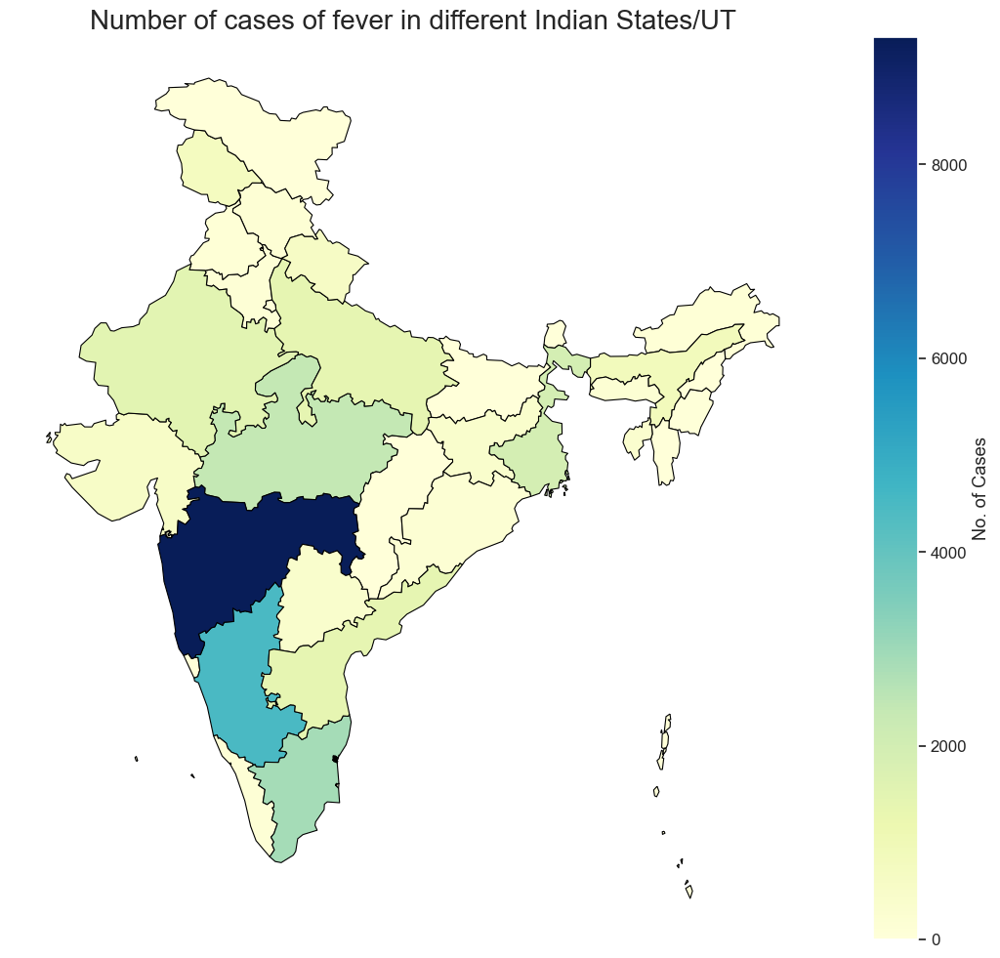

In [126]:
fig, ax = plt.subplots(1, figsize=(15, 12))
ax.axis('off')
ax.set_title('Number of cases of fever in different Indian States/UT', fontdict={'fontsize': '20', 'fontweight' : '10'})
merged_data_stateWise.plot(column='No. of Cases',cmap='YlGnBu', linewidth=0.8, ax=ax, edgecolor='0',legend=True,markersize=[39.739192, -104.990337], legend_kwds={'label': "No. of Cases"})
plt.show()

#### Perform descriptive statistical analysis for the occurrence of the top 10 outbreaks in the assigned states

In [127]:
top10_Outbreak_in_Meghalaya = pd.DataFrame(clean_df_OutbreakIndia_Meghalaya.groupby('Disease/Illness').sum()[['No. of Cases','No. of Deaths']].sort_values(by = 'No. of Cases',ascending=False))[:10]
top10_Outbreak_in_Meghalaya.reset_index(level=0, inplace=True)
top10_Outbreak_in_Meghalaya

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\1407619114.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  top10_Outbreak_in_Meghalaya = pd.DataFrame(clean_df_OutbreakIndia_Meghalaya.groupby('Disease/Illness').sum()[['No. of Cases','No. of Deaths']].sort_values(by = 'No. of Cases',ascending=False))[:10]


,Disease/Illness,No. of Cases,No. of Deaths
0,Acute Diarrhea Disease,907,7
1,Food Poisoning,480,11
2,Measles,321,6
3,Chickenpox,200,0
4,Dengue,189,0
5,Fever,182,0
6,Japanease Encephalitis,137,14
7,Scrub Typhus,119,0
8,Malaria,77,7
9,Measles & Rubella,76,0


#### Pie chart for mortal diseases in Meghalaya and its percentage of contribution in no of deaths

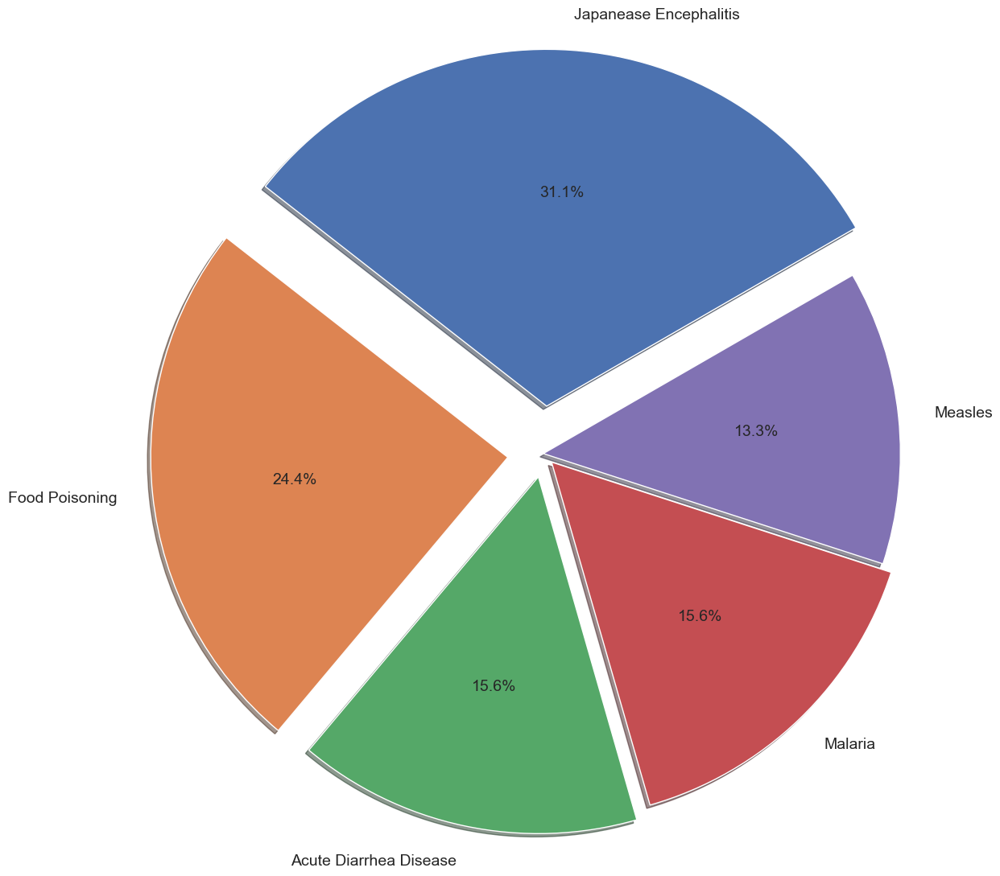

In [128]:
intermediate_data = top10_Outbreak_in_Meghalaya.sort_values(by = 'No. of Deaths',ascending=False)
intermediate_data = intermediate_data[intermediate_data['No. of Deaths']>0][:5]
explode = (0.4, 0.3, 0.2, 0.1, 0)
plt.pie(intermediate_data['No. of Deaths'], labels = intermediate_data['Disease/Illness'], autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

#### Pie chart for most impacted diseases in Meghalaya and its percentage of contribution in no of cases

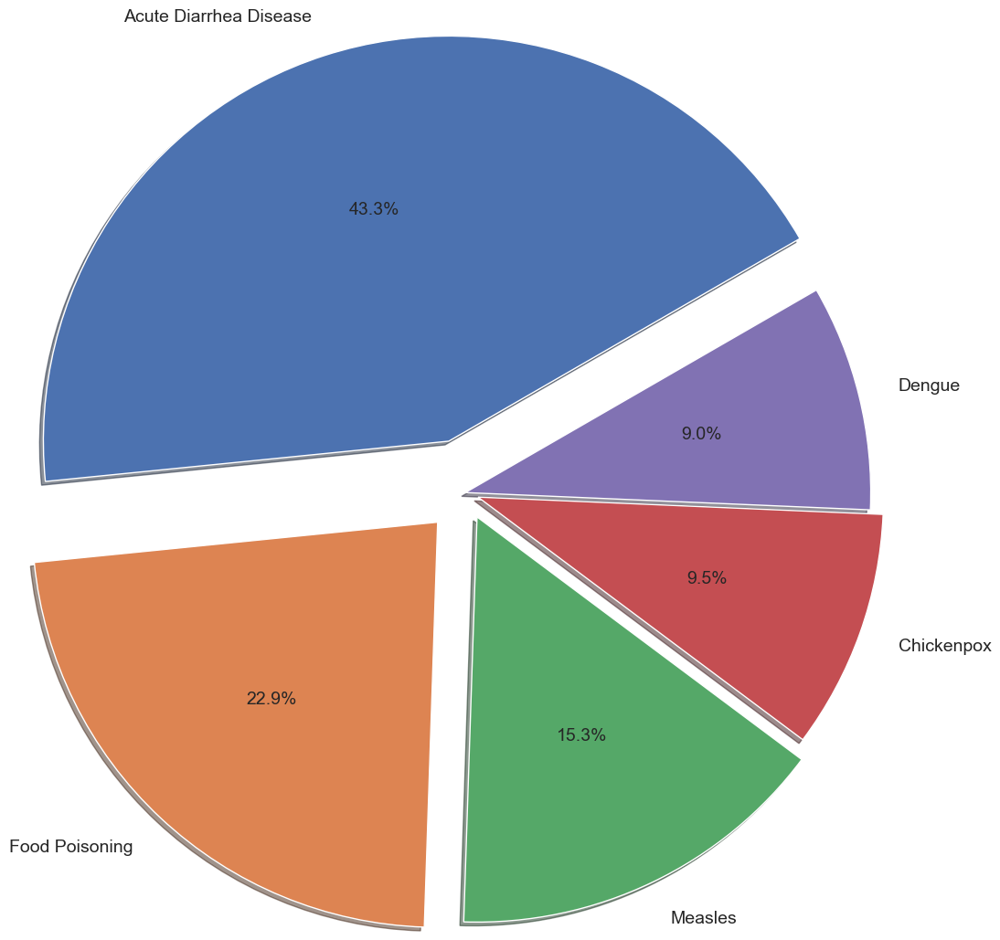

In [129]:
intermediate_data = top10_Outbreak_in_Meghalaya.sort_values(by = 'No. of Cases',ascending=False)
intermediate_data = intermediate_data[intermediate_data['No. of Cases']>0][:5]
explode = (0.4, 0.3, 0.2, 0.1, 0)
plt.pie(intermediate_data['No. of Cases'], labels = intermediate_data['Disease/Illness'], autopct='%1.1f%%', radius=3,textprops={'fontsize': 14},counterclock=True, shadow=True,startangle = 30,explode = explode)
plt.show()

#### Descriptive statistical details for Top 10 outbreak in Meghalaya

In [130]:
include =['object', 'float', 'int']
top10_Outbreak_in_Meghalaya.describe(include=include)

,Disease/Illness,No. of Cases,No. of Deaths
count,10,10.000000,10.000000
unique,10,NaN,NaN
top,Acute Diarrhea Disease,NaN,NaN
freq,1,NaN,NaN
mean,NaN,268.800000,4.500000
std,NaN,255.394162,5.254628
min,NaN,76.000000,0.000000
25%,NaN,123.500000,0.000000
50%,NaN,185.500000,3.000000
75%,NaN,290.750000,7.000000


#### Each Disease wise descriptive statistics

In [131]:
for disease in top10_Outbreak_in_Meghalaya['Disease/Illness']:
    print(f'============================={disease}=============================')
    filter_data = clean_df_OutbreakIndia_Meghalaya[clean_df_OutbreakIndia_Meghalaya['Disease/Illness'] == disease]
    display(filter_data.describe(include=include))

=============================Acute Diarrhea Disease=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,11.000000,11,11,11,11.000000,11.000000,11,11,11,11
unique,NaN,1,5,1,NaN,NaN,11,3,2,11
top,NaN,Meghalaya,West Khasi Hills,Acute Diarrhea Disease,NaN,NaN,18-01-2012,Reported late,Under Control,Outbreak reported from vill. Wahkhen under Lai...
freq,NaN,11,4,11,NaN,NaN,1,9,6,1
mean,12828.636364,NaN,NaN,NaN,82.454545,0.636364,NaN,NaN,NaN,NaN
std,5761.771902,NaN,NaN,NaN,108.860795,1.433369,NaN,NaN,NaN,NaN
min,4750.000000,NaN,NaN,NaN,7.000000,0.000000,NaN,NaN,NaN,NaN
25%,6730.500000,NaN,NaN,NaN,22.500000,0.000000,NaN,NaN,NaN,NaN
50%,17389.000000,NaN,NaN,NaN,30.000000,0.000000,NaN,NaN,NaN,NaN
75%,17423.500000,NaN,NaN,NaN,89.500000,0.000000,NaN,NaN,NaN,NaN


=============================Food Poisoning=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,10.000000,10,10,10,10.000000,10.00000,10,10,10,10
unique,NaN,1,4,1,NaN,NaN,10,9,2,10
top,NaN,Meghalaya,East Khasi Hills,Food Poisoning,NaN,NaN,16-07-2011,Reported late,Under Surveillance,Outbreak reported from various parts of the ci...
freq,NaN,10,7,10,NaN,NaN,1,2,7,1
mean,7079.600000,NaN,NaN,NaN,48.000000,1.10000,NaN,NaN,NaN,NaN
std,4578.152907,NaN,NaN,NaN,101.154447,2.84605,NaN,NaN,NaN,NaN
min,4749.000000,NaN,NaN,NaN,3.000000,0.00000,NaN,NaN,NaN,NaN
25%,4752.500000,NaN,NaN,NaN,9.250000,0.00000,NaN,NaN,NaN,NaN
50%,4756.000000,NaN,NaN,NaN,20.000000,0.00000,NaN,NaN,NaN,NaN
75%,6015.750000,NaN,NaN,NaN,22.750000,0.00000,NaN,NaN,NaN,NaN


=============================Measles=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,7.000000,7,7,7,7.000000,7.000000,7,7,7,7
unique,NaN,1,3,1,NaN,NaN,7,3,2,7
top,NaN,Meghalaya,Jaintia Hills,Measles,NaN,NaN,10-08-2015,Reported late,Under Surveillance,Cases of fever with rash reported from Village...
freq,NaN,7,5,7,NaN,NaN,1,5,4,1
mean,9079.571429,NaN,NaN,NaN,45.857143,0.857143,NaN,NaN,NaN,NaN
std,5731.410293,NaN,NaN,NaN,53.339881,1.214986,NaN,NaN,NaN,NaN
min,4727.000000,NaN,NaN,NaN,6.000000,0.000000,NaN,NaN,NaN,NaN
25%,5588.500000,NaN,NaN,NaN,17.000000,0.000000,NaN,NaN,NaN,NaN
50%,6430.000000,NaN,NaN,NaN,29.000000,0.000000,NaN,NaN,NaN,NaN
75%,11907.000000,NaN,NaN,NaN,45.500000,1.500000,NaN,NaN,NaN,NaN


=============================Chickenpox=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,6.000000,6,6,6,6.000000,6.0,6,6,6,6
unique,NaN,1,4,1,NaN,NaN,5,2,2,6
top,NaN,Meghalaya,Jaintia Hills,Chickenpox,NaN,NaN,15-02-2016,Reported late,Under Control,Cases of fever with rash reported from Village...
freq,NaN,6,2,6,NaN,NaN,2,5,3,1
mean,12805.166667,NaN,NaN,NaN,33.333333,0.0,NaN,NaN,NaN,NaN
std,5438.636830,NaN,NaN,NaN,43.454190,0.0,NaN,NaN,NaN,NaN
min,5412.000000,NaN,NaN,NaN,7.000000,0.0,NaN,NaN,NaN,NaN
25%,8599.750000,NaN,NaN,NaN,7.500000,0.0,NaN,NaN,NaN,NaN
50%,15097.500000,NaN,NaN,NaN,13.500000,0.0,NaN,NaN,NaN,NaN
75%,16809.500000,NaN,NaN,NaN,35.250000,0.0,NaN,NaN,NaN,NaN


=============================Dengue=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,2.000000,2,2,2,2.000000,2.0,2,2,2,2
unique,NaN,1,1,1,NaN,NaN,2,2,1,2
top,NaN,Meghalaya,West Garo Hills,Dengue,NaN,NaN,11-08-2016,Reported late,Under Surveillance,Cases reported from Village Tura Urban area. D...
freq,NaN,2,2,2,NaN,NaN,1,1,2,1
mean,17383.000000,NaN,NaN,NaN,94.500000,0.0,NaN,NaN,NaN,NaN
std,1.414214,NaN,NaN,NaN,44.547727,0.0,NaN,NaN,NaN,NaN
min,17382.000000,NaN,NaN,NaN,63.000000,0.0,NaN,NaN,NaN,NaN
25%,17382.500000,NaN,NaN,NaN,78.750000,0.0,NaN,NaN,NaN,NaN
50%,17383.000000,NaN,NaN,NaN,94.500000,0.0,NaN,NaN,NaN,NaN
75%,17383.500000,NaN,NaN,NaN,110.250000,0.0,NaN,NaN,NaN,NaN


=============================Fever=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,2.000000,2,2,2,2.000000,2.0,2,2,2,2
unique,NaN,1,2,1,NaN,NaN,2,2,2,2
top,NaN,Meghalaya,Ri Bhoi,Fever,NaN,NaN,30-05-2019,Reported late,Under Control,"Cases reported from Village Tasku-A, Block Jir..."
freq,NaN,2,1,2,NaN,NaN,1,1,1,1
mean,15531.000000,NaN,NaN,NaN,91.000000,0.0,NaN,NaN,NaN,NaN
std,2654.478857,NaN,NaN,NaN,121.622366,0.0,NaN,NaN,NaN,NaN
min,13654.000000,NaN,NaN,NaN,5.000000,0.0,NaN,NaN,NaN,NaN
25%,14592.500000,NaN,NaN,NaN,48.000000,0.0,NaN,NaN,NaN,NaN
50%,15531.000000,NaN,NaN,NaN,91.000000,0.0,NaN,NaN,NaN,NaN
75%,16469.500000,NaN,NaN,NaN,134.000000,0.0,NaN,NaN,NaN,NaN


=============================Japanease Encephalitis=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,10.000000,10,10,10,10.000000,10.000000,10,10,10,10
unique,NaN,1,5,1,NaN,NaN,9,6,2,10
top,NaN,Meghalaya,West Garo Hills,Japanease Encephalitis,NaN,NaN,04-08-2015,Reported late,Under Surveillance,Cases reported from Village Thadlaskein Block ...
freq,NaN,10,4,10,NaN,NaN,2,5,8,1
mean,13850.000000,NaN,NaN,NaN,13.700000,1.400000,NaN,NaN,NaN,NaN
std,4239.068399,NaN,NaN,NaN,19.137224,1.897367,NaN,NaN,NaN,NaN
min,6433.000000,NaN,NaN,NaN,2.000000,0.000000,NaN,NaN,NaN,NaN
25%,13651.250000,NaN,NaN,NaN,3.250000,0.000000,NaN,NaN,NaN,NaN
50%,14393.000000,NaN,NaN,NaN,4.500000,1.000000,NaN,NaN,NaN,NaN
75%,17384.750000,NaN,NaN,NaN,11.000000,1.750000,NaN,NaN,NaN,NaN


=============================Scrub Typhus=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,2.000000,2,2,2,2.00000,2.0,2,2,2,2
unique,NaN,1,1,1,NaN,NaN,2,2,2,2
top,NaN,Meghalaya,Jaintia Hills,Scrub Typhus,NaN,NaN,28-09-2015,28-09-2015,Under Control,Cases reported from different villages under K...
freq,NaN,2,2,2,NaN,NaN,1,1,1,1
mean,5574.500000,NaN,NaN,NaN,59.50000,0.0,NaN,NaN,NaN,NaN
std,1197.131781,NaN,NaN,NaN,17.67767,0.0,NaN,NaN,NaN,NaN
min,4728.000000,NaN,NaN,NaN,47.00000,0.0,NaN,NaN,NaN,NaN
25%,5151.250000,NaN,NaN,NaN,53.25000,0.0,NaN,NaN,NaN,NaN
50%,5574.500000,NaN,NaN,NaN,59.50000,0.0,NaN,NaN,NaN,NaN
75%,5997.750000,NaN,NaN,NaN,65.75000,0.0,NaN,NaN,NaN,NaN


=============================Malaria=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,2.000000,2,2,2,2.000000,2.000000,2,2,2,2
unique,NaN,1,2,1,NaN,NaN,2,2,1,2
top,NaN,Meghalaya,Jaintia Hills,Malaria,NaN,NaN,13-11-2015,Reported late,Under Surveillance,"Cases reported from Village Musiaw, Lathymphu,..."
freq,NaN,2,1,2,NaN,NaN,1,1,2,1
mean,10039.000000,NaN,NaN,NaN,38.500000,3.500000,NaN,NaN,NaN,NaN
std,5110.967814,NaN,NaN,NaN,31.819805,4.949747,NaN,NaN,NaN,NaN
min,6425.000000,NaN,NaN,NaN,16.000000,0.000000,NaN,NaN,NaN,NaN
25%,8232.000000,NaN,NaN,NaN,27.250000,1.750000,NaN,NaN,NaN,NaN
50%,10039.000000,NaN,NaN,NaN,38.500000,3.500000,NaN,NaN,NaN,NaN
75%,11846.000000,NaN,NaN,NaN,49.750000,5.250000,NaN,NaN,NaN,NaN


=============================Measles & Rubella=============================


,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
count,1.0,1,1,1,1.0,1.0,1,1,1,1
unique,NaN,1,1,1,NaN,NaN,1,1,1,1
top,NaN,Meghalaya,Jaintia Hills,Measles & Rubella,NaN,NaN,10-06-2017,Reported late,Under Control,"Cases reported from Village Wapung Shnong, SC/..."
freq,NaN,1,1,1,NaN,NaN,1,1,1,1
mean,6432.0,NaN,NaN,NaN,76.0,0.0,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,6432.0,NaN,NaN,NaN,76.0,0.0,NaN,NaN,NaN,NaN
25%,6432.0,NaN,NaN,NaN,76.0,0.0,NaN,NaN,NaN,NaN
50%,6432.0,NaN,NaN,NaN,76.0,0.0,NaN,NaN,NaN,NaN
75%,6432.0,NaN,NaN,NaN,76.0,0.0,NaN,NaN,NaN,NaN


#### Word cloud representation of top 10 outbreak based on No of Cases in Meghalaya

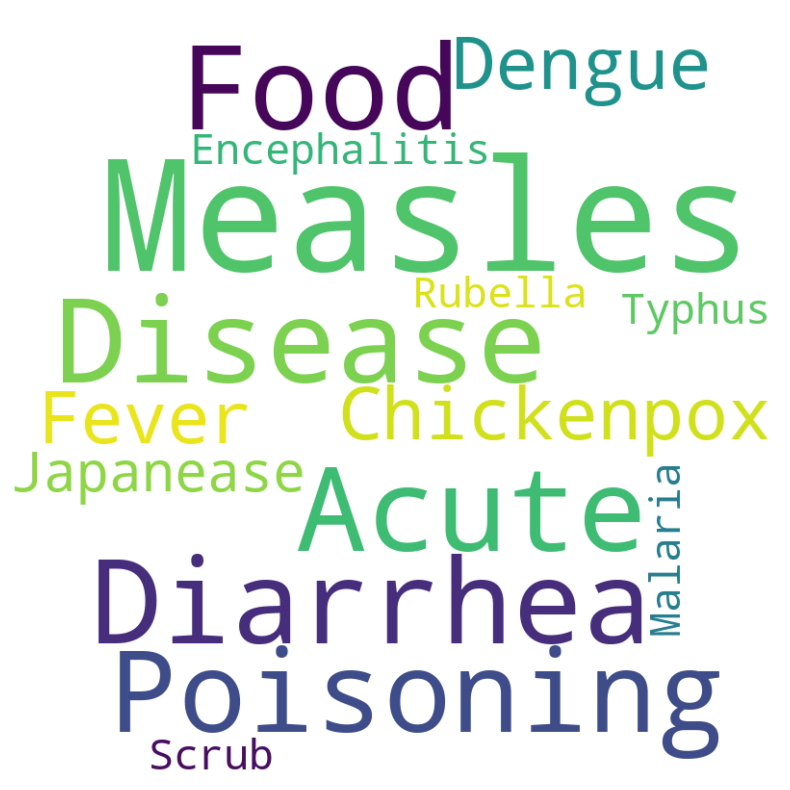

In [132]:
stopwords = set(STOPWORDS)
#wordcloud object creation 
objwordcloud_diseases = WordCloud(width = 800, height = 800,background_color ='white',stopwords = stopwords,min_font_size = 12)
DiseaseWiseCase_Meghalaya = pd.DataFrame(top10_Outbreak_in_Meghalaya.groupby('Disease/Illness').sum()['No. of Cases'].sort_values(ascending=False).index)
comma_seperated_diseases_noofcase = ''
for each_disease in DiseaseWiseCase_Meghalaya['Disease/Illness']:
    comma_seperated_diseases_noofcase += each_disease + ','
objwordcloud_diseases.generate(comma_seperated_diseases_noofcase.rstrip(comma_seperated_diseases_noofcase[-1]))
plt.figure(figsize=(10,10), facecolor=None)
plt.imshow(objwordcloud_diseases, interpolation='bilinear')
plt.axis("off")
plt.show() 

#### Word cloud representation of top 10 outbreak based on No of Deaths in Meghalaya

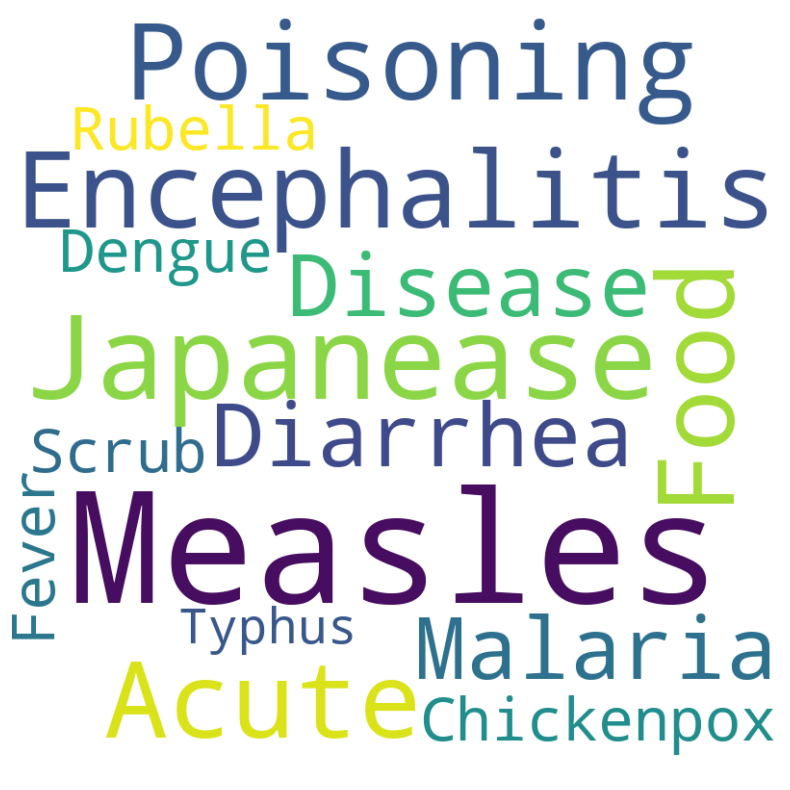

In [133]:
stopwords = set(STOPWORDS)
#wordcloud object creation 
objwordcloud_diseases = WordCloud(width = 800, height = 800,background_color ='white',stopwords = stopwords,min_font_size = 12)
DiseaseWiseDeaths_Meghalaya = pd.DataFrame(top10_Outbreak_in_Meghalaya.groupby('Disease/Illness').sum()['No. of Deaths'].sort_values(ascending=False).index)
comma_seperated_diseases_noofcase = ''
for each_disease in DiseaseWiseDeaths_Meghalaya['Disease/Illness']:
    comma_seperated_diseases_noofcase += each_disease + ','
objwordcloud_diseases.generate(comma_seperated_diseases_noofcase.rstrip(comma_seperated_diseases_noofcase[-1]))
plt.figure(figsize=(10,10), facecolor=None)
plt.imshow(objwordcloud_diseases, interpolation='bilinear')
plt.axis("off")
plt.show() 

##### Plot bar chart for different top 10 outbreak - for No of Cases and No of Deaths

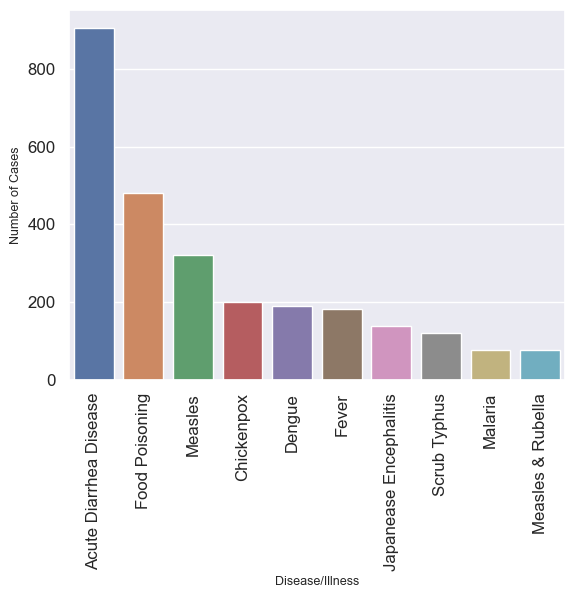

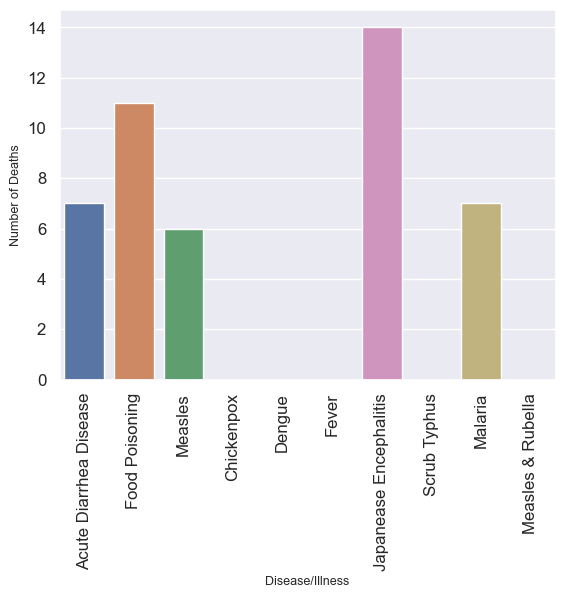

In [134]:
sns.barplot(x=top10_Outbreak_in_Meghalaya['Disease/Illness'], y=top10_Outbreak_in_Meghalaya['No. of Cases'])
plt.ylabel('Number of Cases', fontsize=9)
plt.xlabel('Disease/Illness', fontsize=9)
plt.xticks(rotation=90)
plt.show();

sns.barplot(x=top10_Outbreak_in_Meghalaya['Disease/Illness'], y=top10_Outbreak_in_Meghalaya['No. of Deaths'])
plt.ylabel('Number of Deaths', fontsize=9)
plt.xlabel('Disease/Illness', fontsize=9)
plt.xticks(rotation=90)
plt.show();

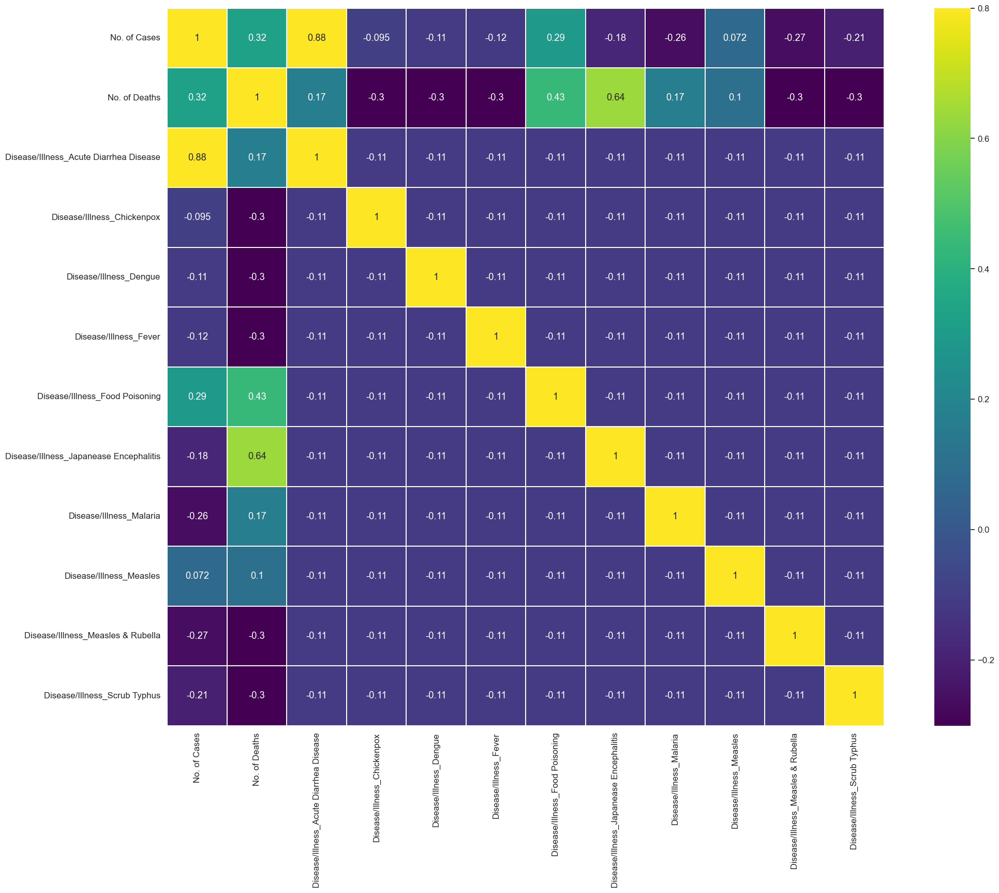

In [135]:
#Check which disease is more fatal
sns.set(font_scale=1.10)
plt.figure(figsize=(25, 18))
one_hot_encoded_top10_Outbreak_in_Meghalaya = pd.get_dummies(top10_Outbreak_in_Meghalaya, columns = ['Disease/Illness'])
sns.heatmap(one_hot_encoded_top10_Outbreak_in_Meghalaya.corr(), vmax=.8, linewidths=0.01,square=True,annot=True,cmap='viridis',linecolor="white")
plt.show()

#### From the above heat map we can say that Japanease Encephalitis	is more fatal than any other diseases followed by Food Poisoning in the state of Meghalaya.
#### Highest number of cases has been observed in Acute Diarrhea Disease

#### plot the ”death/# of the case” ratio in geospatial plots for the assigned states for each district.

In [136]:
clean_df_OutbreakIndia_Meghalaya

,Serial no,Name of State/UT,Name of District,Disease/Illness,No. of Cases,No. of Deaths,Date of start of outbreak,Date Reported,Current Status,Comments
4703,4704.0,Meghalaya,East Garo Hills,Shigellosis,33,0,21-09-2017,Reported late,Under Control,"Cases reported from Village Mikilsimgre, SC Sa..."
4704,4705.0,Meghalaya,East Garo Hills,Shigellosis,33,1,25-09-2017,Reported late,Under Control,"Cases reported from Village Notional area, Mat..."
4726,4727.0,Meghalaya,Jaintia Hills,Measles,8,1,10-08-2015,18-08-2015,Under Control,Cases of fever with rash reported from Village...
4727,4728.0,Meghalaya,Jaintia Hills,Scrub Typhus,47,0,28-09-2015,28-09-2015,Under Control,Cases reported from different villages under K...
4747,4748.0,Meghalaya,East Khasi Hills,Measles,6,0,30-04-2010,03-05-2010,Under Control,Cases reported from North Eastern Hills Univer...
...,...,...,...,...,...,...,...,...,...,...
17423,17424.0,Meghalaya,West Khasi Hills,Acute Diarrhea Disease,173,3,15-05-2014,Reported late,Under Control,Cases of diarrhoea reported from Village / PHC...
17424,17425.0,Meghalaya,West Khasi Hills,Acute Diarrhea Disease,7,0,30-10-2019,Reported late,Under Control,Cases reported from Village/ Block Mawkyrwat. ...
17425,17426.0,Meghalaya,West Khasi Hills,Acute Gastro Enteritis,47,0,29-01-2018,Reported late,Under Control,Cases reported from Village Mashynrut. Block W...
17426,17427.0,Meghalaya,West Khasi Hills,Acute Diarrhea Disease,108,0,14-01-2019,Reported late,Under Surveillance,Cases reported from Village/Block Nongstoin. D...


In [137]:
np.unique(clean_df_OutbreakIndia_Meghalaya['Name of District'])

array(['East Garo Hills', 'East Khasi Hills', 'Garo Hills',
       'Jaintia Hills', 'Jaintia Hills & West Kashi Hills', 'Ri Bhoi',
       'Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills',
       'South Garo Hills', 'South West Garo Hills', 'West Garo Hills',
       'West Khasi Hills'], dtype=object)

In [138]:
grp_clean_Meghalaya_data = clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)
grp_clean_Meghalaya_data.drop('Serial no', axis=1, inplace=True)
grp_clean_Meghalaya_data

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\371676627.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_data = clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


,No. of Cases,No. of Deaths
Name of District,,
Jaintia Hills,1024,20
West Khasi Hills,713,9
Ri Bhoi,451,18
West Garo Hills,406,4
East Khasi Hills,254,0
East Garo Hills,66,1
Garo Hills,41,0
"Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills",16,0
South Garo Hills,14,0


In [139]:
grp_clean_Meghalaya_data['death/# of the case'] = grp_clean_Meghalaya_data['No. of Deaths']/grp_clean_Meghalaya_data['No. of Cases']
grp_clean_Meghalaya_data

,No. of Cases,No. of Deaths,death/# of the case
Name of District,,,
Jaintia Hills,1024,20,0.019531
West Khasi Hills,713,9,0.012623
Ri Bhoi,451,18,0.039911
West Garo Hills,406,4,0.009852
East Khasi Hills,254,0,0.000000
East Garo Hills,66,1,0.015152
Garo Hills,41,0,0.000000
"Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills",16,0,0.000000
South Garo Hills,14,0,0.000000


In [140]:
grp_clean_Meghalaya_data.drop('No. of Cases', axis=1, inplace=True)
grp_clean_Meghalaya_data.drop('No. of Deaths', axis=1, inplace=True)
grp_clean_Meghalaya_data

,death/# of the case
Name of District,
Jaintia Hills,0.019531
West Khasi Hills,0.012623
Ri Bhoi,0.039911
West Garo Hills,0.009852
East Khasi Hills,0.000000
East Garo Hills,0.015152
Garo Hills,0.000000
"Shillong, East Khasi Hills, West Khasi Hills & Jaintia Hills",0.000000
South Garo Hills,0.000000


#### As per the SHP file it is not possible to map couple of district properly, hence we have get rid of couple of data. below is the mapping I have done as per my understanding.

##### 1.  West Khasi Hills -----> West Khasi Hills
##### 2. Jaintia Hills	----->                Jaintia Hills
##### 3. Ri-Bhoi ----->	                        Ri Bhoi
##### 4.  West Garo Hill ----->	                West Garo Hills
##### 5. West Jaintia Hills ----->	            Jaintia Hills
##### 6. East Khasi Hills ----->	            East Khasi Hills
##### 7. West Khasi Hills (Nongstoin) -----> 	West Khasi Hills
##### 8. East Garo Hills ----->	                East Garo Hills
##### 9. East Jaintia Hills ----->	            Jaintia Hills
##### 10. Ri-Bhoi(Nongpoh) ----->	            Ri Bhoi
##### 11. Garo Hills ----->	                    Not possible to map (41)
##### 12. West Jaintiahills ----->	            Jaintia Hills
##### 13. West Garo Hills ----->	                West Garo Hills   
##### 14. Shillong, East Khasi Hills,
##### West Khasi Hills 
##### & Jaintia Hills	----->                Not possible to map (16)
##### 15. South Garo Hills	-----> 			South Garo Hills
##### 16. Jaintia Hills 
##### & West Kashi Hills	----->            Not possible to map (5)
##### 17. South West Garo Hills ----->	        Not possible to map (4)

##### Total number of data sacrificed due to impossibility of matching of district is (41+16+5+4) = 66

In [141]:
merged_data_Meghalaya_deathcase_ratio = india_shp_df_Meghalaya.set_index('DISTRICT').join(grp_clean_Meghalaya_data)
merged_data_Meghalaya_deathcase_ratio

,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry,death/# of the case
DISTRICT,,,,,,
East Garo Hills,Meghalaya,17,2,294,"POLYGON ((91.03234 25.88749, 91.03220 25.87930...",0.015152
East Khasi Hills,Meghalaya,17,6,298,"POLYGON ((92.01985 25.18684, 92.01391 25.18854...",0.000000
Jaintia Hills,Meghalaya,17,7,299,"POLYGON ((92.66161 25.57945, 92.66152 25.56794...",0.019531
Ri Bhoi,Meghalaya,17,5,297,"POLYGON ((92.18042 26.07789, 92.18305 26.07455...",0.039911
South Garo Hills,Meghalaya,17,3,295,"POLYGON ((90.97256 25.17201, 90.95847 25.16973...",0.000000
West Garo Hills,Meghalaya,17,1,293,"POLYGON ((90.32286 25.46537, 90.31025 25.43463...",0.009852
West Khasi Hills,Meghalaya,17,4,296,"POLYGON ((91.81149 25.64286, 91.81036 25.63488...",0.012623


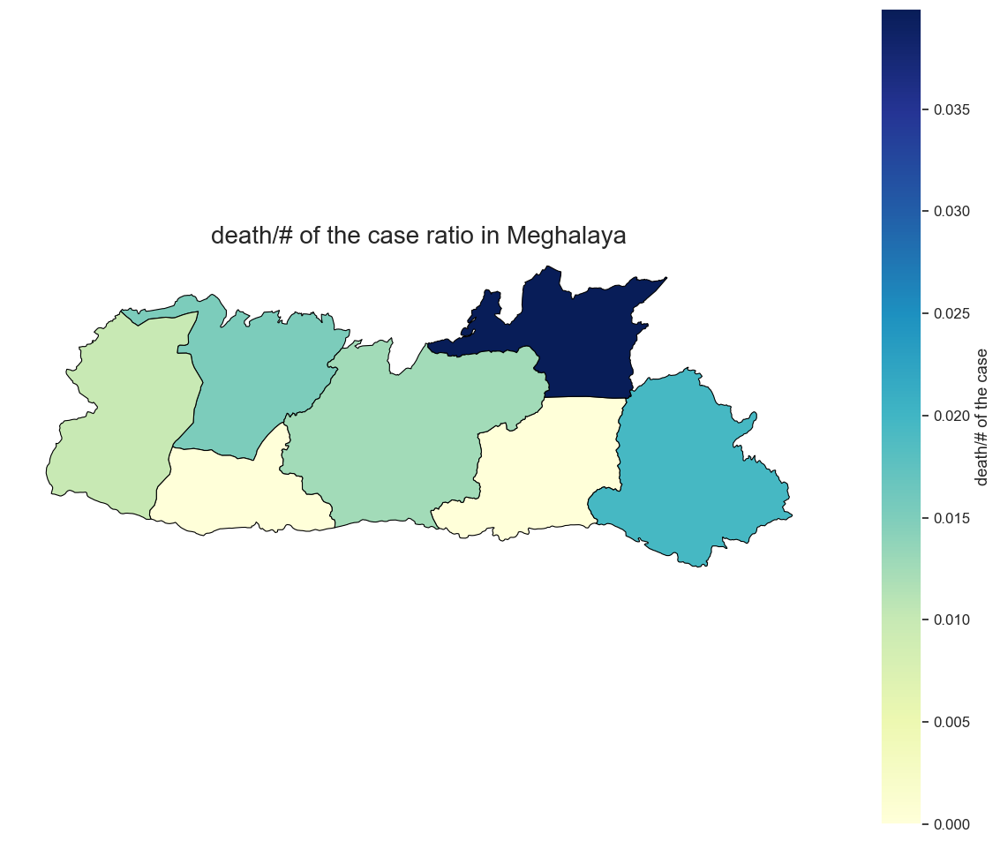

In [142]:
fig, ax = plt.subplots(1, figsize=(15, 12))
ax.axis('off')
ax.set_title(f'death/# of the case ratio in {filtering_state}', fontdict={'fontsize': '20', 'fontweight' : '10'})
merged_data_Meghalaya_deathcase_ratio.plot(column='death/# of the case',cmap='YlGnBu', linewidth=0.8, ax=ax, edgecolor='0',legend=True,markersize=[39.739192, -104.990337], legend_kwds={'label': "death/# of the case"})
plt.show()

#### plot the ”death/# of the case” ratio in geospatial plots for the assigned states for each district for top 10 outbreak 

In [143]:
top10_Outbreak_in_Meghalaya

,Disease/Illness,No. of Cases,No. of Deaths
0,Acute Diarrhea Disease,907,7
1,Food Poisoning,480,11
2,Measles,321,6
3,Chickenpox,200,0
4,Dengue,189,0
5,Fever,182,0
6,Japanease Encephalitis,137,14
7,Scrub Typhus,119,0
8,Malaria,77,7
9,Measles & Rubella,76,0


C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


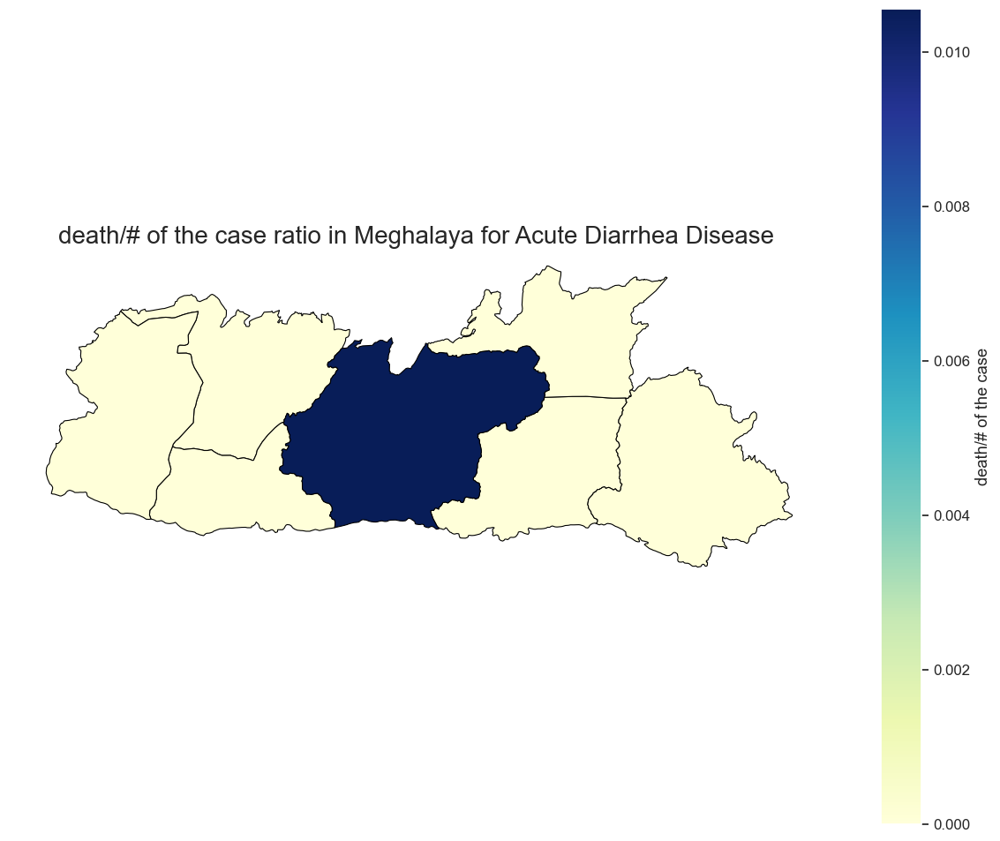

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


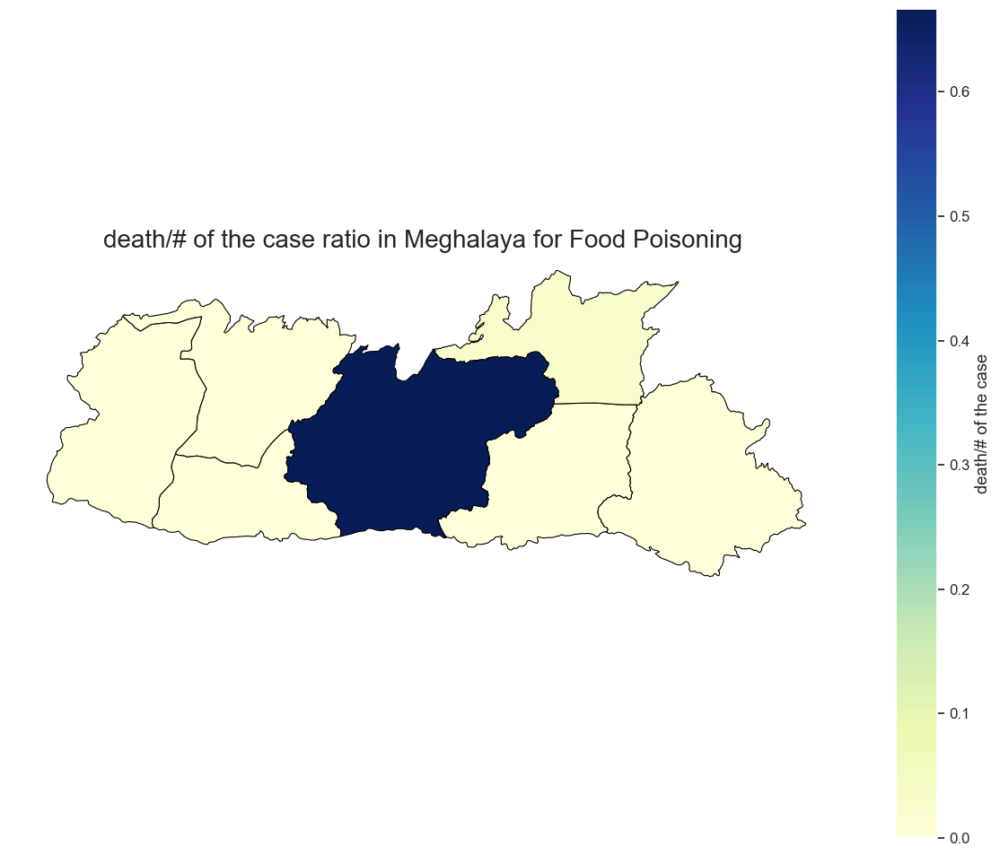

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


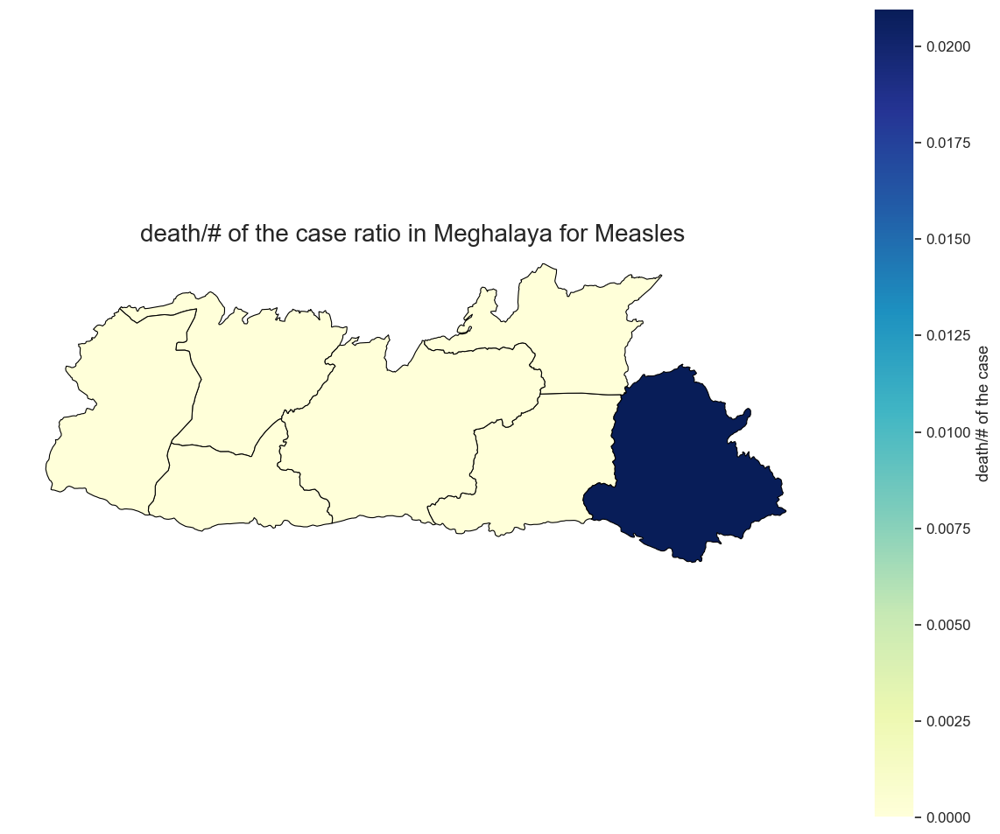

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


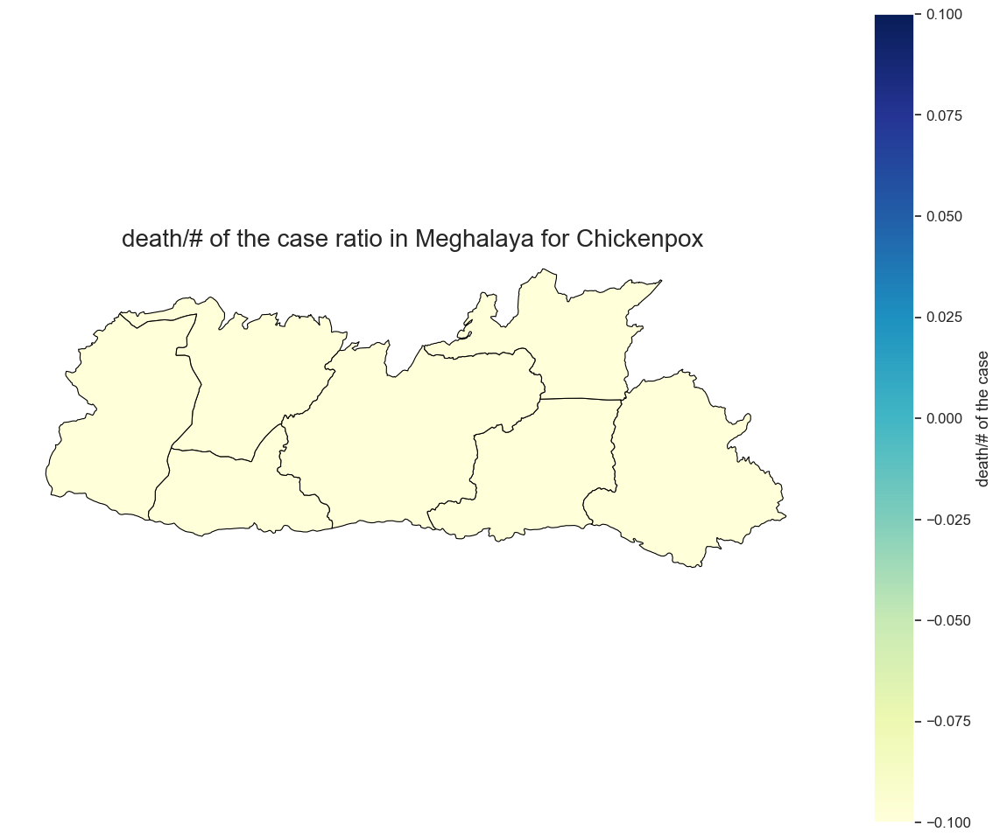

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


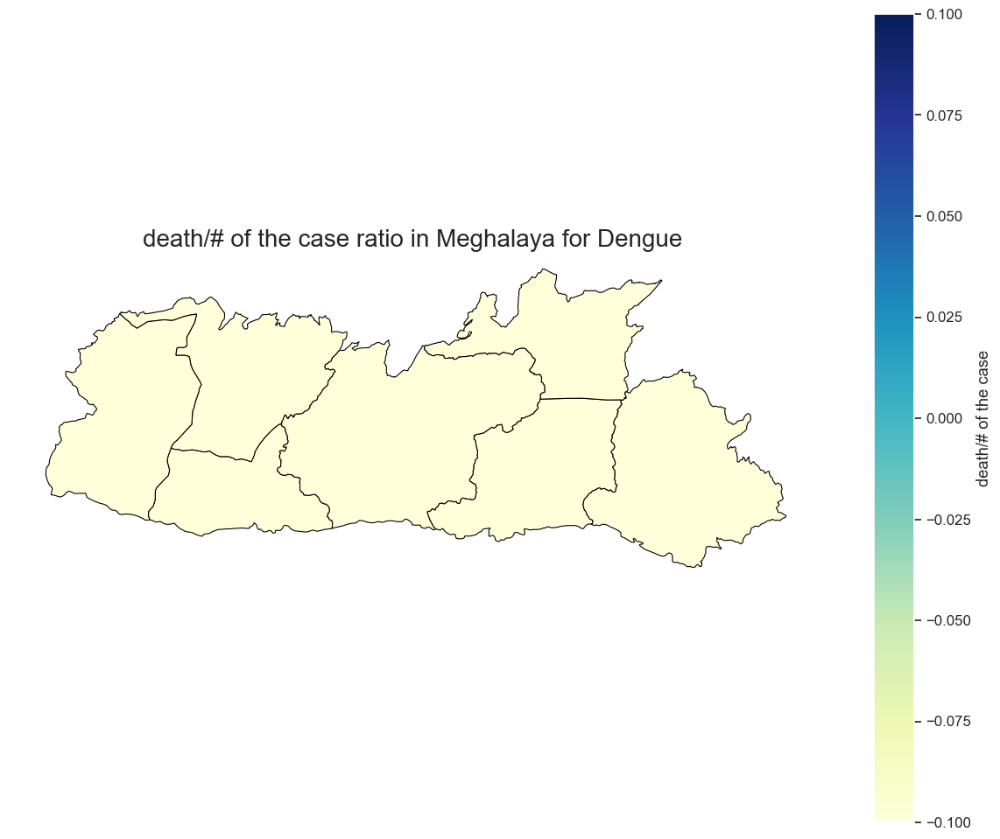

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


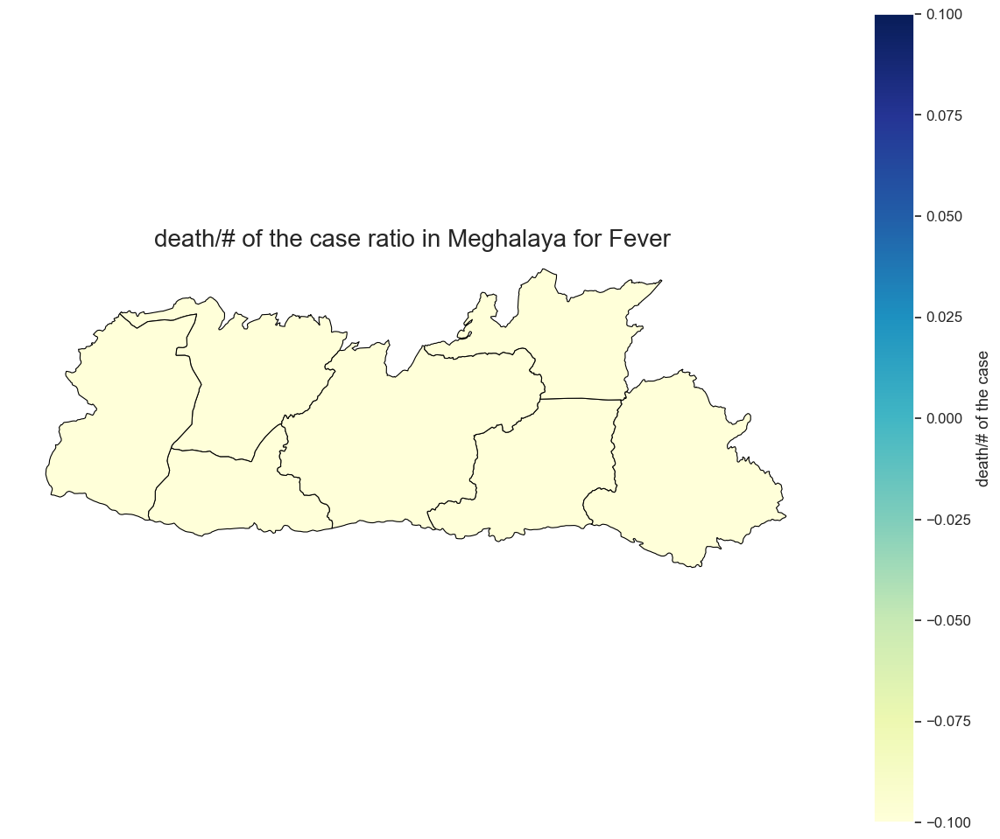

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


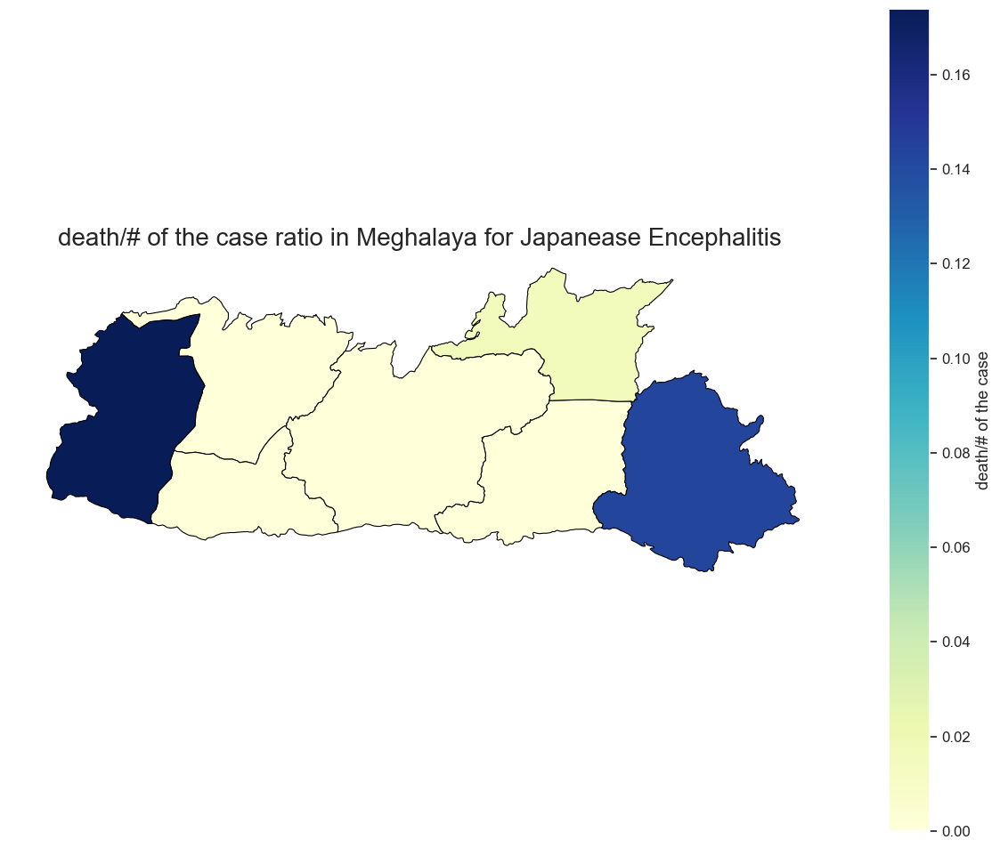

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


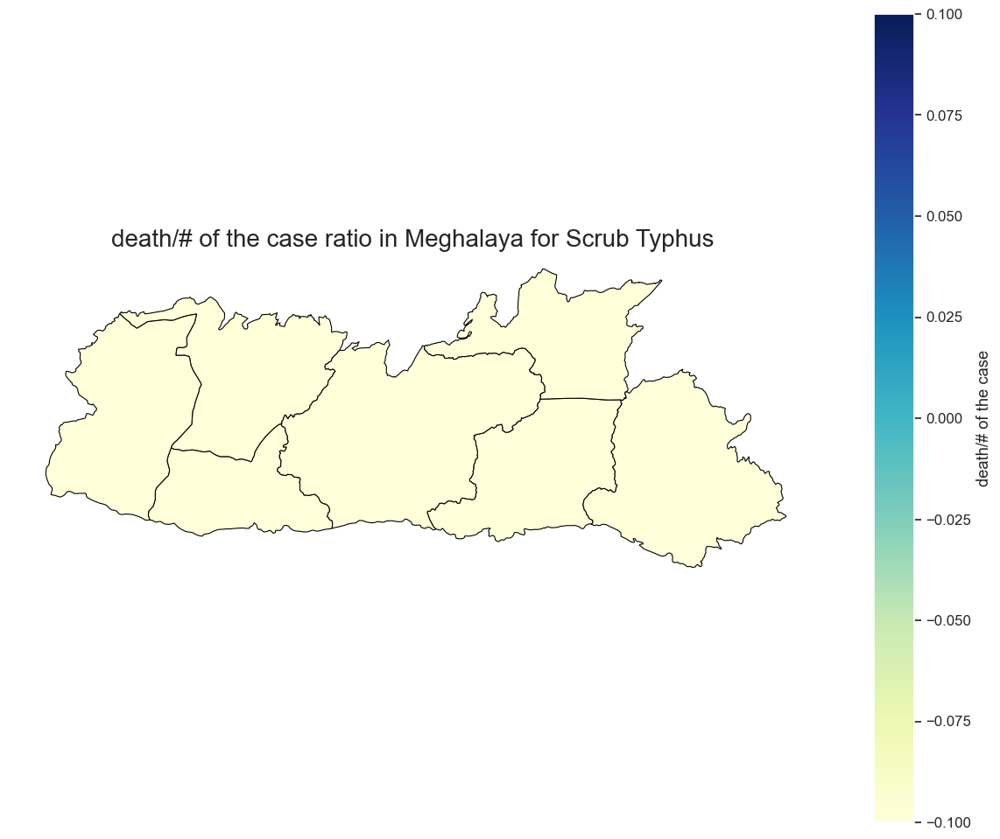

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


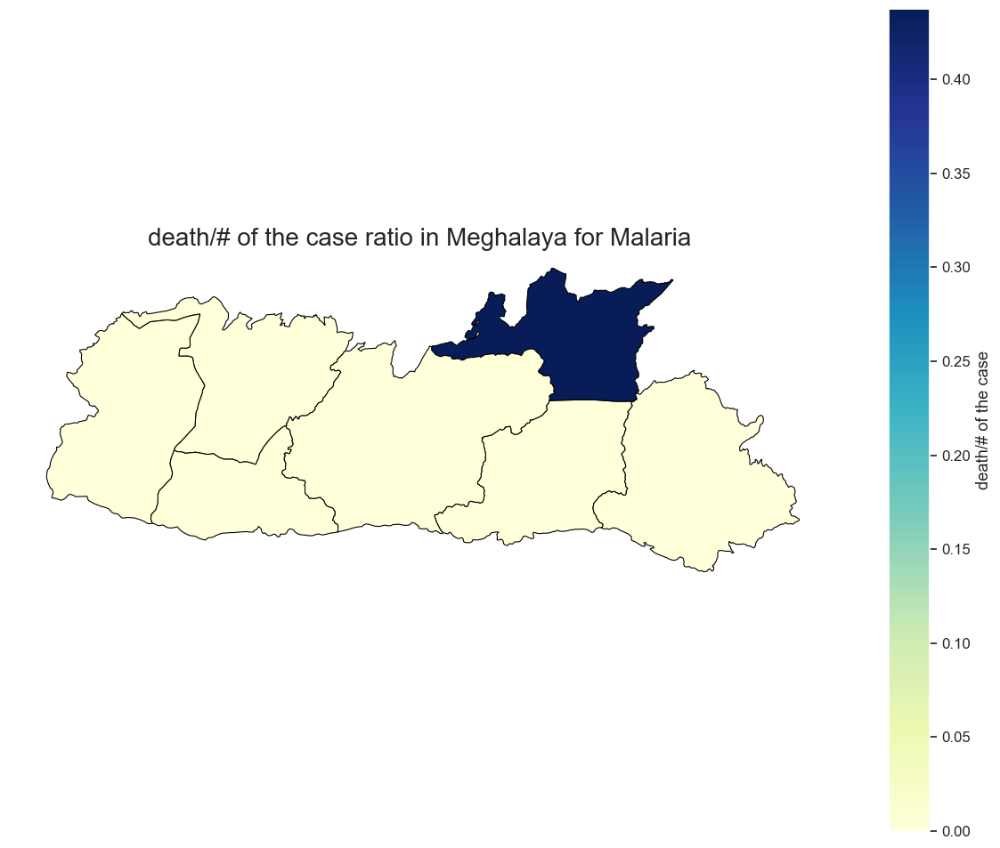

C:\Users\Admin\AppData\Local\Temp\ipykernel_11108\546893142.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)


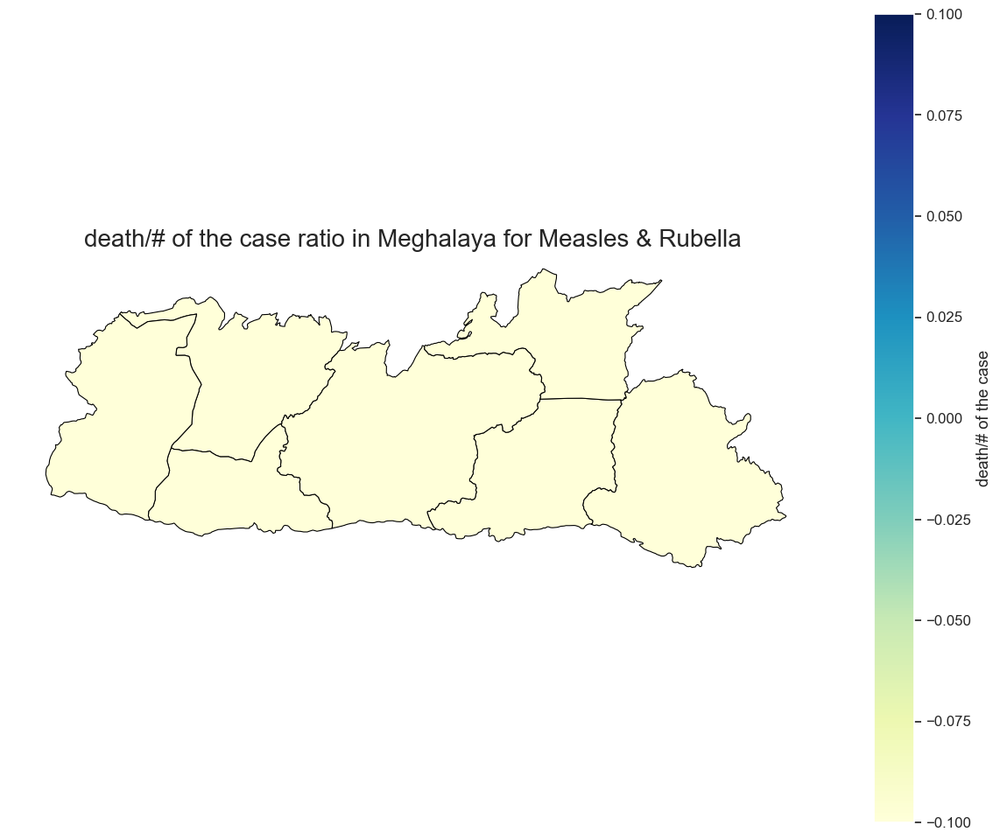

In [144]:
for disease in top10_Outbreak_in_Meghalaya['Disease/Illness']:
    filter_clean_df_OutbreakIndia_Meghalaya = clean_df_OutbreakIndia_Meghalaya[clean_df_OutbreakIndia_Meghalaya['Disease/Illness']==disease]
    grp_clean_Meghalaya_disease_wise_data = filter_clean_df_OutbreakIndia_Meghalaya.groupby(['Name of District']).sum().sort_values(by = 'No. of Cases',ascending=False)
    grp_clean_Meghalaya_disease_wise_data.drop('Serial no', axis=1, inplace=True)
    grp_clean_Meghalaya_disease_wise_data['death/# of the case'] = grp_clean_Meghalaya_disease_wise_data['No. of Deaths']/grp_clean_Meghalaya_disease_wise_data['No. of Cases']
    merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data = india_shp_df_Meghalaya.set_index('DISTRICT').join(grp_clean_Meghalaya_disease_wise_data)
    merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data['death/# of the case'] = merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data['death/# of the case'].replace(np.nan, 0)
    merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data['No. of Deaths'] = merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data['No. of Deaths'].replace(np.nan, 0)
    merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data['No. of Cases'] = merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data['No. of Cases'].replace(np.nan, 0)
    fig, ax = plt.subplots(1, figsize=(15, 12))
    ax.axis('off')
    ax.set_title(f'death/# of the case ratio in {filtering_state} for {disease} ', fontdict={'fontsize': '20', 'fontweight' : '10'})
    merged_data_Meghalaya_deathcase_ratio_on_disease_wise_data.plot(column='death/# of the case',cmap='YlGnBu', linewidth=0.8, ax=ax, edgecolor='0',legend=True,markersize=[39.739192, -104.990337], legend_kwds={'label': "death/# of the case"})
    plt.show()